In [4]:
import h5py
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import cv2
import statistics
import skimage as ski
from skimage.morphology import square,disk
from scipy import signal
from scipy import stats
from pathlib import Path
import hashlib
import numbers
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Functions for Screen Sorting

In [5]:
def check_plunger_states(files, plengths=None):
    """
    Checks is plunger in the line, and which one.....
    """
    if plengths is None:

        plengths = [0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5, 10.3]
        
    results = []

    for i, file_path in enumerate(files):
        
        plunger_state = 0
        plunger_in = None
        is_there_a_plunger = 0
 
        try:

            with h5py.File(file_path, 'r') as f:
                
                for p in range(len(plengths)):
                    try:
                        plunger = list(f['AwakeEventData'][f'AWAKE.XAWAV2_PE_P{p + 1}_ST']['PosSt']['value'])

                    except:
                        pass

                    else:
                        plunger_state = int(plunger[0])

                    try:
                        plunger = list(f['AwakeEventData'][f'AWAKE.XAWAV2_PG_P{p + 1}_ST']['PosSt']['value'])

                    except:
                        pass

                    else:
                        plunger_state = int(plunger[0])
                        

                    if plunger_state == 3 or plunger_state == 4:
                        plunger_in = p + 1
                        is_there_a_plunger = 1

                        break
 

        except Exception as e:
            print(f"Error reading file {file_path}: {e}")

            continue
 
        results.append({
            "index": i,
            "file": file_path,
            "is_there_a_plunger": bool(is_there_a_plunger),
            "plunger_in": plunger_in
        })

    return results

In [6]:
def fit_line(x,a,b):
    return a*x + b

In [7]:
def load_all_event_data(date,event_filename,spectro_no,threshold):
    
    with h5py.File('/eos/experiment/awake/event_data/'+date+'/'+ event_filename, 'r') as f:
        root = f['AwakeEventData']

        # Main data
        spectro_path = f'TCC4.SPECTRO{spectro_no}.DigiCam'
        data = root[spectro_path]['ExtractionImage']['image2D'][:]

        try:
            protons = root['TT41.BCTF.412340']['CaptureAcquisition']['totalIntensity'][0]
            
            ## sort BTV54
            screen_of_interest = root['TT41.BTV.412354.DigiCam']['ExtractionImage']['image2D'][400:610,510:720]
            bg_sensor = np.array(screen_of_interest) - 3.78126279
            w_median_filter = ski.filters.median(bg_sensor, footprint=disk(3)) 

            total_count = np.sum(w_median_filter)

            if protons !=0 and total_count > threshold:
                BTV54_position = 1

            else:
                BTV54_position = 0
                
                
        except(ValueError, KeyError):
            protons=0
            BTV54_position = 0
        
        rif = root['Sps2AwakeSynchro']['ProtonDelayNs']['delay'][0]
        plunger_status = check_plunger_states(['/eos/experiment/awake/event_data/'+date+'/'+ event_filename])
        laser_firing = root['EMETER04']['Acq']['value'][0]
        
        ## sort based on threshold
        if laser_firing > 0.05:
            laser_value = 1
        
        else:
            laser_value = 0
        
        # Screens
        screens = {
            'OTR': root['MPP-VACTRANS-OTR']['Acquisition']['end_switch_plus_active'][()],
            'CTR': root['MPP-VACTRANS-CTR']['Acquisition']['end_switch_plus_active'][()],
            'LDBP': root['LBDP2']['Acq']['position'][0],
            'BTV50': root['TT41.BTV.412350.BTVI']['SisAcquisition']['screenIn'][0],
            'BTV53': root['TT41.BTV.412353.BTVI']['SisAcquisition']['screenIn'][0],
            'BTV426': root['TT41.BTV.412426.BTVI']['SisAcquisition']['screenIn'][0],
            'BTV442': root['TT41.BTV.412442.BTVI']['SisAcquisition']['screenIn'][0],
            'Plunger': plunger_status[0]['plunger_in'],
            'BTV54': BTV54_position
        }

    return data, protons, rif, laser_value, screens

In [8]:
def sort_by_space_scin_screen(space_x,space_y,no_events,Date,camera_number):
    
    y_step = int(660/space_x)
    x_step = int(1876/space_y)    
    
    list_indices_y = list(range(330, 990, y_step))
    list_indices_x = list(range(60, 1936, x_step))
    
    rif_data = {}
    
    DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
    event_files = os.listdir(DATA_PATH)

    for i in np.arange(25,no_events,1):
        filename = event_files[i]
        
        data, protons, rif, laser, screens = load_all_event_data(Date,filename,spectro_no=camera_number,threshold=1750000)
        bg_sensor = np.array(data) - 3.78126279
        w_median_filter = ski.filters.median(bg_sensor, footprint=disk(4)) 
        
        if rif not in rif_data:
            rif_data[rif] = {}
            
        if laser not in rif_data[rif]:
             rif_data[rif][laser] = {}
            
        ## check what screens are in
        active_screens = []
        list_screens = ['OTR','CTR','BTV50','BTV53', 'BTV426', 'BTV442', 'LDBP','Plunger', 'BTV54']

        # Determine which screen is active
        screen_used = None
        for screen in list_screens: 
            val = screens.get(screen,None)

            if screen =='LDBP':
                val = screens['LDBP']
                if val == 0:
                    active_screens.append('LDBP')

            elif screen == 'Plunger':
                val = screens['Plunger']

                for j in np.arange(1,11,1):
                    if val == j:
                        active_screens.append(f'Plunger{j}')                

            elif isinstance(val, (bool, np.bool_)):
                if val == False:
                    active_screens.append(screen)
 
            elif isinstance(val, numbers.Number):
                if float(val) == 1:
                    active_screens.append(screen)

                    
        if not active_screens:
            active_screens = ['None']

        # Create a combined label
        screen_label = '+'.join(active_screens)

        if screen_label not in rif_data[rif][laser]:
            rif_data[rif][laser][screen_label] = {'full_image': {'fit_parameters': [], 'proton_count': [] }}
            
            
        ## Add full camera image
        rif_data[rif][laser][screen_label]['full_image']['fit_parameters'].append(np.mean(w_median_filter[330:990,60:]))
        rif_data[rif][laser][screen_label]['full_image']['proton_count'].append(protons)

        for i in list_indices_y:
            for j in list_indices_x:        
                sliced_data = w_median_filter[i:i+y_step,j:j+x_step]
                #print(np.mean(sliced_data))

                index_cut = (i, i+y_step , j, j+x_step)

                if index_cut not in rif_data[rif][laser][screen_label]:
                    rif_data[rif][laser][screen_label][index_cut] = {
                        'fit_parameters': [], 'proton_count': []}

                rif_data[rif][laser][screen_label][index_cut]['fit_parameters'].append(np.mean(sliced_data))
                rif_data[rif][laser][screen_label][index_cut]['proton_count'].append(protons)


    return rif_data

In [9]:
def store_slopes_no_filtering(rif_data):
    saved_slopes_intercepts = {}
    
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_laser_values = list(rif_data[rif])
        
        for laser in list_laser_values:
            list_screen_combos = list(rif_data[rif][laser])

            for screen_label in list_screen_combos:
                fig, ax = plt.subplots(figsize=(10, 6))
                fig2, ax2 = plt.subplots(figsize=(10, 6))
#                 fig3, ax3 = plt.subplots(figsize=(10, 6))
#                 fig4, ax4 = plt.subplots(figsize=(10, 6))

                data = rif_data[rif][laser][screen_label]
                index_count = list(data)

                list_slopes = []
                list_int = []
                slope_heat_map = np.zeros((1216, 1936))
                intercept_heat_map = np.zeros((1216, 1936))

               # bin_width = 0.2

                try:
                    for i in index_count:

                        x = np.array(data[i]['fit_parameters'])
                        y = np.array(data[i]['proton_count'])                

                        if len(x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                            params = curve_fit(fit_line, x, y)[0]
                            a, b = params
                            list_slopes.append(a)
                            list_int.append(b)

                            slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                            intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b


                    im = ax.imshow(slope_heat_map,cmap='Greens',origin='upper')
                    ax.imshow(slope_heat_map,cmap='Greens',vmax=0.18)
                    fig.colorbar(im, ax=ax, label ='Slope')

                    im2 = ax2.imshow(intercept_heat_map,cmap='Blues',origin='upper')
                    ax2.imshow(intercept_heat_map,cmap='Blues',vmax=150)
                    fig2.colorbar(im2, ax=ax2, label ='Y int')


                    # Histogram for slopes
#                     min_slope = np.floor(min(list_slopes))
#                     max_slope = np.ceil(max(list_slopes))
#                     bins = np.arange(min_slope, max_slope + bin_width, bin_width)
#                     ax3.hist(list_slopes, bins=bins, color='green')
#                     ax3.set_title('Slope Distribution')
#                     ax3.set_xlabel('Slope')
#                     ax3.set_ylabel('Counts')
#                     ax3.set_xlim([min_slope*0.9, max_slope*1.1])

                    # Histogram for intercepts
                    #min_int = np.floor(min(list_int))
                    #max_int = np.ceil(max(list_int))
                    #bins2 = np.arange(min_int, max_int + bin_width, bin_width)
                   # ax4.hist(list_int, bins=bins2, color='blue')
                    #ax4.set_title('Y-Intercept Distribution')
                    #ax4.set_xlabel('Intercept')
                   # ax4.set_ylabel('Counts')
                    #ax4.set_xlim([min_int*0.9, max_int*1.1])

                    ax.set_title(f'Slopes Laser = {laser}, RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                    ax2.set_title(f'Intercepts Laser = {laser}, RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                    
                    
                    ## write to dictionary
                    #key = f"RIF_{rif}_Laser_{laser}_Screens_{screen_label}"
                    #saved_slopes_intercepts[f"{key}_slope"] = slope_heat_map
                    #saved_slopes_intercepts[f"{key}_intercepts"] = intercept_heat_map
                    
                    plt.show()

                except:
                    print('Error')
                    continue
                    
#    np.savez_compressed("slope_intercept_data.npz",**saved_slopes_intercepts)

In [10]:
def store_slopes_std_filtering(rif_data):
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_laser_values = list(rif_data[rif])
        
        for laser in list_laser_values:
            list_screen_combos = list(rif_data[rif][laser])

            for screen_label in list_screen_combos:
                fig, ax = plt.subplots(figsize=(10, 6))
                fig2, ax2 = plt.subplots(figsize=(10, 6))
                fig3, ax3 = plt.subplots(figsize=(10, 6))
                fig4, ax4 = plt.subplots(figsize=(10, 6))



                data = rif_data[rif][laser][screen_label]
                index_count = list(data)

                list_slopes = []
                list_int = []
                slope_heat_map = np.zeros((1216, 1936))
                intercept_heat_map = np.zeros((1216, 1936))

                try:
                    for i in index_count:

                        x = np.array(data[i]['fit_parameters'])
                        y = np.array(data[i]['proton_count'])                

                        if len(x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                            params = curve_fit(fit_line, x, y)[0]
                            a, b = params
                            list_slopes.append(a)
                            list_int.append(b)

                            slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                            intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b

                    # Compute means and stds
                    slopes_array = np.array(list_slopes)
                    intercepts_array = np.array(list_int)

                    mean_slope = np.mean(slopes_array)
                    std_slope = np.std(slopes_array)

                    mean_int = np.mean(intercepts_array)
                    std_int = np.std(intercepts_array)

                    # Filter out outliers > 2 std deviations
                    filtered_slopes = slopes_array[np.abs(slopes_array - mean_slope) <= 2 * std_slope]
                    filtered_intercepts = intercepts_array[np.abs(intercepts_array - mean_int) <= 2 * std_int]

                    filtered_slope_map = np.zeros((1216, 1936))
                    filtered_intercept_map = np.zeros((1216, 1936))

                    slope_mask = (np.abs(slope_heat_map - mean_slope) <= 2 * std_slope) 
                    intercept_mask = (np.abs(intercept_heat_map - mean_int) <= 2 * std_int) 

                    # Apply masks
                    filtered_slope_map[slope_mask] = slope_heat_map[slope_mask]
                    filtered_intercept_map[intercept_mask] = intercept_heat_map[intercept_mask]

                    im = ax.imshow(filtered_slope_map,cmap='Greens',origin='upper')
                    ax.imshow(filtered_slope_map,cmap='Greens')
                    fig.colorbar(im, ax=ax, label ='Slope')

                    im2 = ax2.imshow(filtered_intercept_map,cmap='Blues',origin='upper')
                    ax2.imshow(filtered_intercept_map,cmap='Blues')
                    fig2.colorbar(im2, ax=ax2, label ='Y int')

                    bin_width = 0.1

                    # Histogram for slopes
                    min_slope = np.floor(min(filtered_slopes))
                    max_slope = np.ceil(max(filtered_slopes))
                    bins = np.arange(min_slope, max_slope + bin_width, bin_width)
                    ax3.hist(filtered_slopes, bins=bins, color='green')
                    ax3.set_title('Slope Distribution')
                    ax3.set_xlabel('Slope')
                    ax3.set_ylabel('Counts')
                    ax3.set_xlim([min_slope*0.9, max_slope*1.1])

                    # Histogram for intercepts
                    min_int = np.floor(min(filtered_intercepts))
                    max_int = np.ceil(max(filtered_intercepts))
                    bins2 = np.arange(min_int, max_int + bin_width, bin_width)
                    ax4.hist(filtered_intercepts, bins=bins2, color='blue')
                    ax4.set_title('Y-Intercept Distribution')
                    ax4.set_xlabel('Intercept')
                    ax4.set_ylabel('Counts')
                    ax4.set_xlim([min_int*0.9, max_int*1.1])

                    ax.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}, Laser = {laser}' , fontsize=16)
                    ax2.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}, Laser = {laser}' , fontsize=16)
                    plt.show()

                except:
                    print('Error')
                    continue

In [11]:
def store_slopes_mad_filtering(rif_data):
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_screen_combos = list(rif_data[rif])

        for screen_label in list_screen_combos:
            fig, ax = plt.subplots(figsize=(10, 6))
            fig2, ax2 = plt.subplots(figsize=(10, 6))
            fig3, ax3 = plt.subplots(figsize=(10, 6))
            fig4, ax4 = plt.subplots(figsize=(10, 6))



            data = rif_data[rif][screen_label]
            index_count = list(data)
    
            list_slopes = []
            list_int = []
            slope_heat_map = np.zeros((1216, 1936))
            intercept_heat_map = np.zeros((1216, 1936))


            for i in index_count:
                
                x = np.array(data[i]['fit_parameters'])
                y = np.array(data[i]['proton_count'])                

                if len(x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                    params = curve_fit(fit_line, x, y)[0]
                    a, b = params
                    list_slopes.append(a)
                    list_int.append(b)
                    
                    slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                    intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b
                    
            # Compute MAD
            slopes_array = np.array(list_slopes)
            intercepts_array = np.array(list_int)
            
        
            median_slope = np.median(slopes_array)
            abs_deviation = np.abs(slopes_array-median_slope)
            mad_slope =  np.median(abs_deviation)
            
            median_int = np.median(intercepts_array)
            abs_deviation_int = np.abs(intercepts_array-median_int)
            mad_int =  np.median(abs_deviation_int)



            # Filter out outliers > 2 MAD
            filtered_slopes = slopes_array[np.abs(slopes_array - median_slope) <= 2 * mad_slope]
            filtered_intercepts = intercepts_array[np.abs(intercepts_array - median_int) <= 2 * mad_int]
            
            filtered_slope_map = np.zeros((1216, 1936))
            filtered_intercept_map = np.zeros((1216, 1936))
            
            slope_mask = (np.abs(slope_heat_map - median_slope) <= 2 * mad_slope) 
            intercept_mask = (np.abs(intercept_heat_map - median_int) <= 2 * mad_int) 

            # Apply masks
            filtered_slope_map[slope_mask] = slope_heat_map[slope_mask]
            filtered_intercept_map[intercept_mask] = intercept_heat_map[intercept_mask]
                    
            im = ax.imshow(filtered_slope_map,cmap='Greens',origin='upper')
            ax.imshow(filtered_slope_map,cmap='Greens')
            fig.colorbar(im, ax=ax, label ='Slope')
            
            im2 = ax2.imshow(filtered_intercept_map,cmap='Blues',origin='upper')
            ax2.imshow(filtered_intercept_map,cmap='Blues')
            fig2.colorbar(im2, ax=ax2, label ='Y int')

            
            bin_width = 0.05

            try:
                # Histogram for slopes
                min_slope = np.floor(min(filtered_slopes))
                max_slope = np.ceil(max(filtered_slopes))
                bins = np.arange(min_slope, max_slope + bin_width, bin_width)
                ax3.hist(filtered_slopes, bins=bins, color='green')
                ax3.set_title('Slope Distribution')
                ax3.set_xlabel('Slope')
                ax3.set_ylabel('Counts')
                ax3.set_xlim([min_slope*0.9, max_slope*1.1])

                # Histogram for intercepts
                min_int = np.floor(min(filtered_intercepts))
                max_int = np.ceil(max(filtered_intercepts))
                bins2 = np.arange(min_int, max_int + bin_width, bin_width)
                ax4.hist(filtered_intercepts, bins=bins2, color='blue')
                ax4.set_title('Y-Intercept Distribution')
                ax4.set_xlabel('Intercept')
                ax4.set_ylabel('Counts')
                ax4.set_xlim([min_int*0.9, max_int*1.1])
                
                ax.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                ax2.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                
                plt.show()
                
            except:
                print('Error')
                continue

# Spectro 1 - Redo 

In [13]:
spectro_1_17_05 = sort_by_space_scin_screen(220,469,100,'2025/05/16',1)

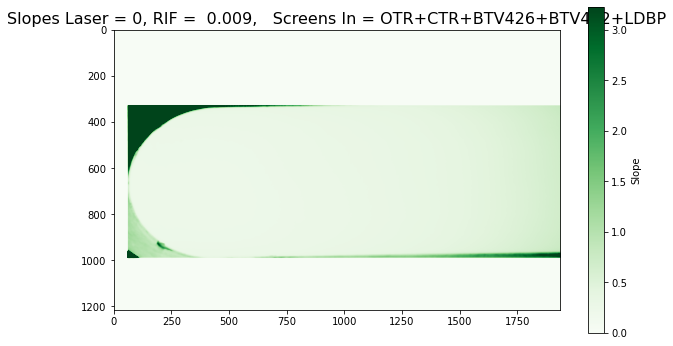

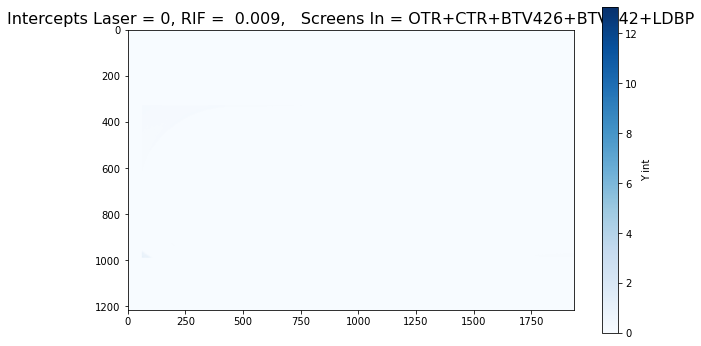

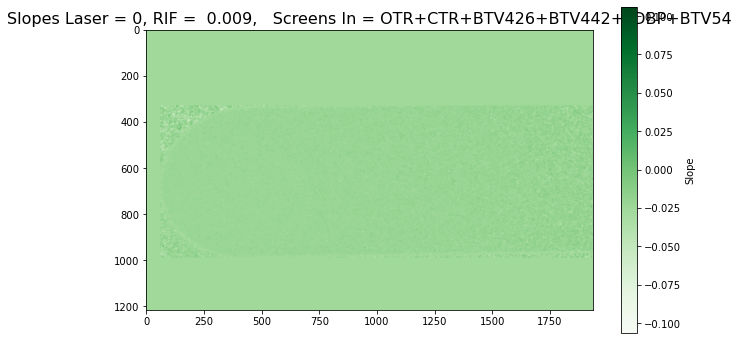

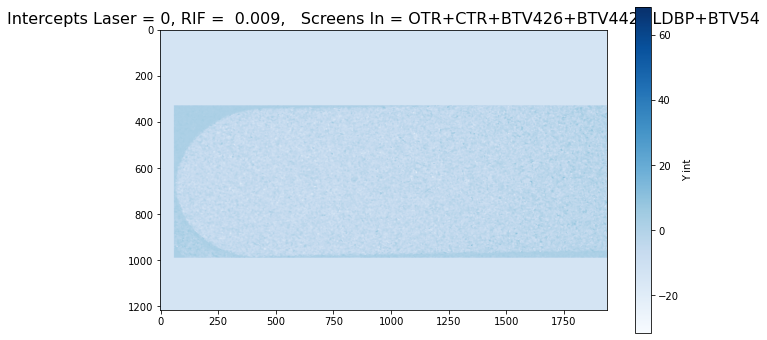

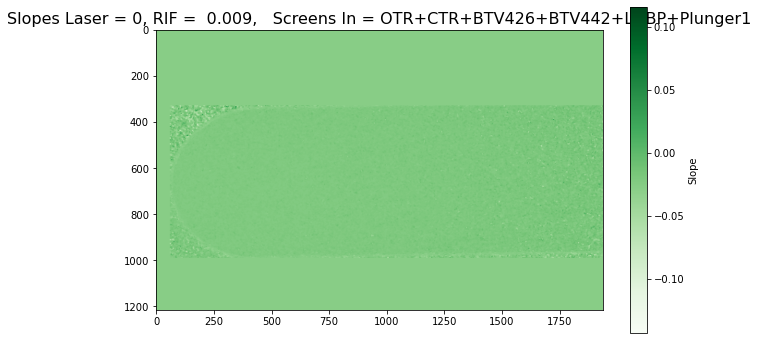

...

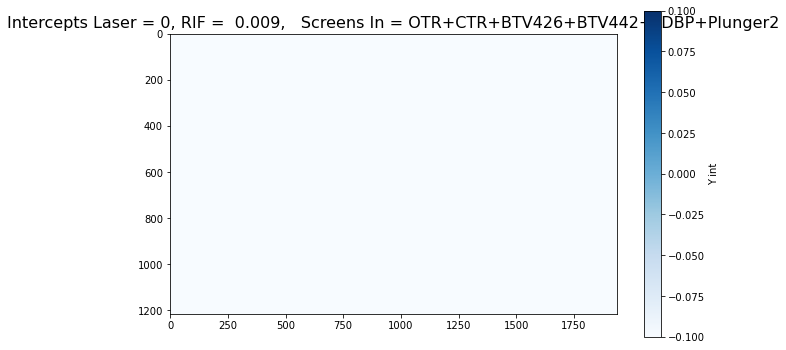

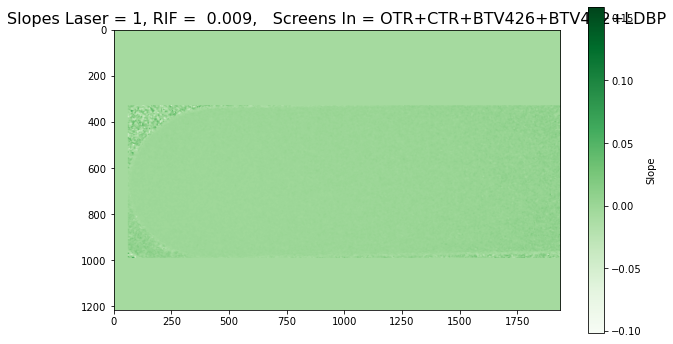

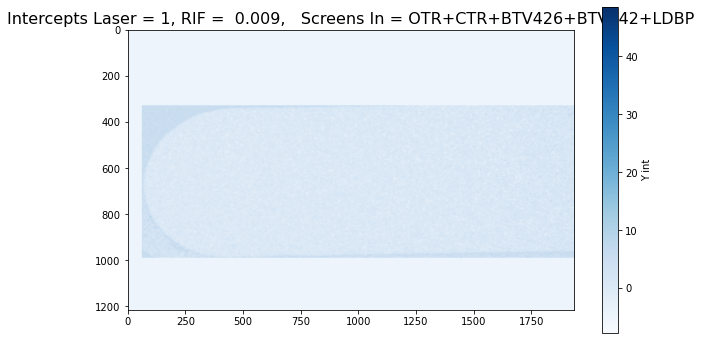

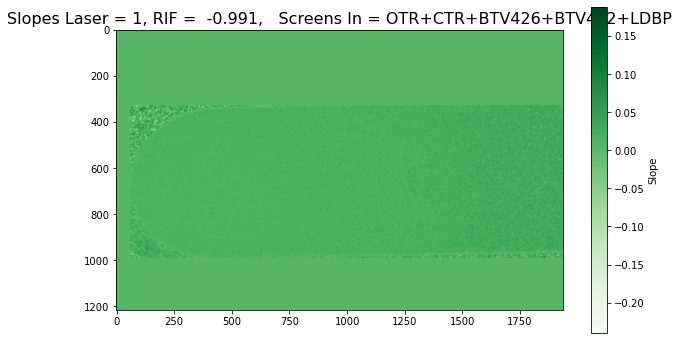

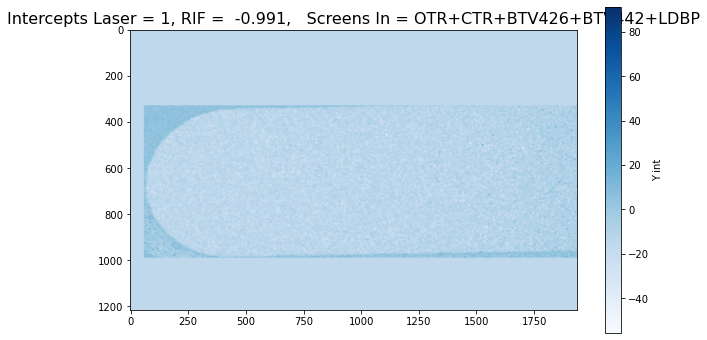

In [17]:
store_slopes_no_filtering(spectro_1_17_05)

In [17]:
data = np.load("slope_intercept_data.npz")
len(data['RIF_1132482.608_Laser_0_Screens_OTR+CTR+BTV442_slope'])

1216

# Spectro 2 

In [9]:
spectro_2_16_05 = sort_by_space_scin_screen(220,469,100,'2025/05/16',2)

In [18]:
spectro_2_16_05

{1132482.608: {0: {'OTR+CTR+BTV426+BTV442+LDBP': {'full_image': {'fit_parameters': [-3.6337051237856315,
      -3.6289488725741563,
      -3.628193719766765,
      -3.649300038820846,
      -3.6329515862783626,
      -3.6445575176604135,
      -3.650020462675598,
      -3.632687484708291,
      -3.6505971248194236,
      -3.656716689334511,
      -3.643568146335221,
      -3.6532106804180535,
      -3.619460599653048,
      -3.6398884926555675,
      -3.6528189701382843,
      -3.6468221684325277,
      480.0656479485163,
      482.57920273949645,
      479.1090074497116,
      479.7220598823536],
     'proton_count': [0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      0.0,
      29.277628,
      29.194633,
      28.917023,
      29.048672]},
    (330,
     331,
     60,
     61): {'fit_parameters': [-3.78126279,
      -3.78126279,
      -3.78126279,
      -3.78126279,
    

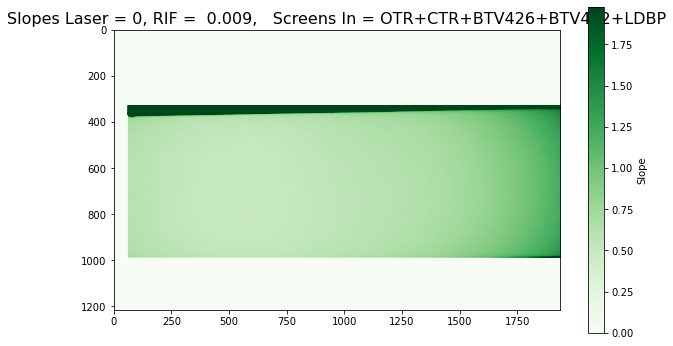

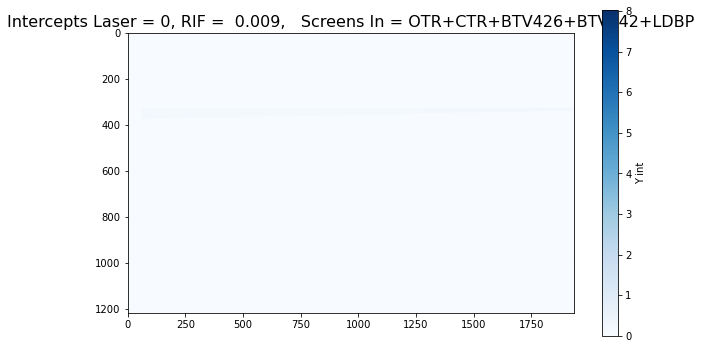

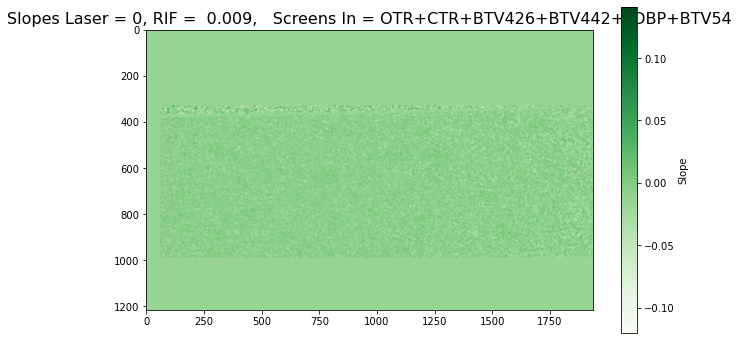

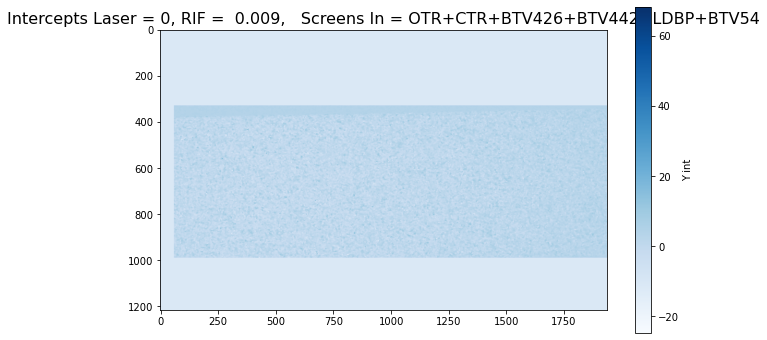

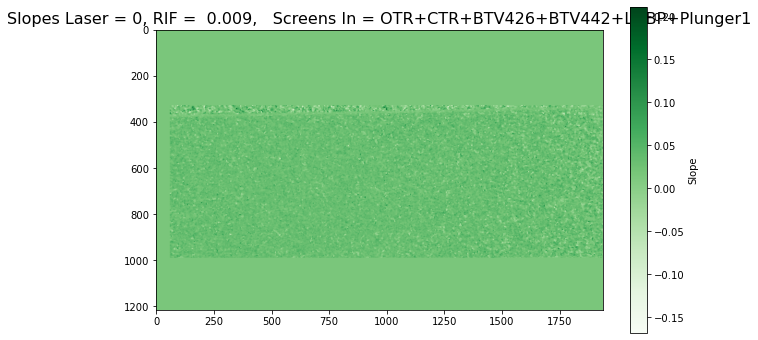

...

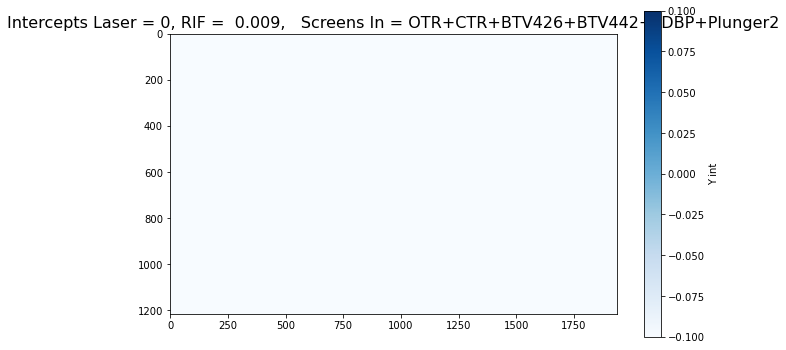

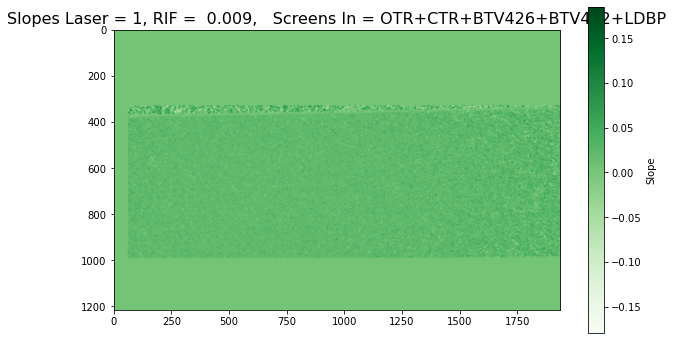

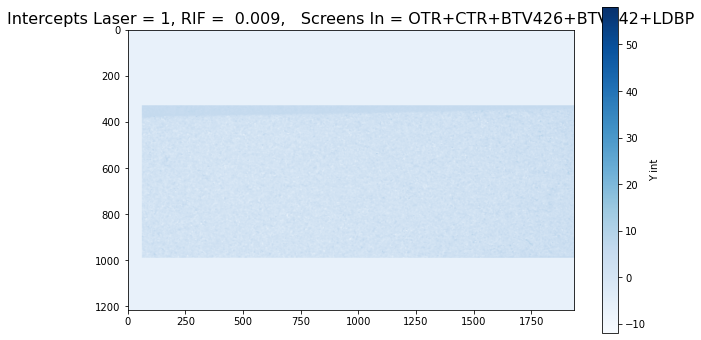

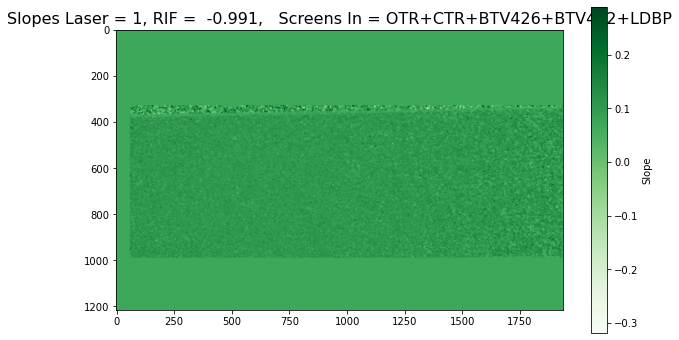

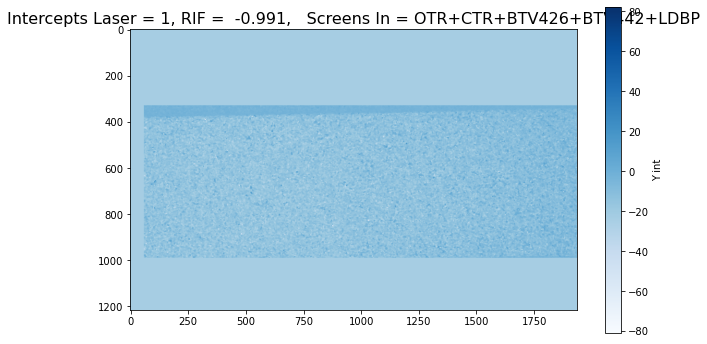

In [18]:
store_slopes_no_filtering(spectro_2_16_05)

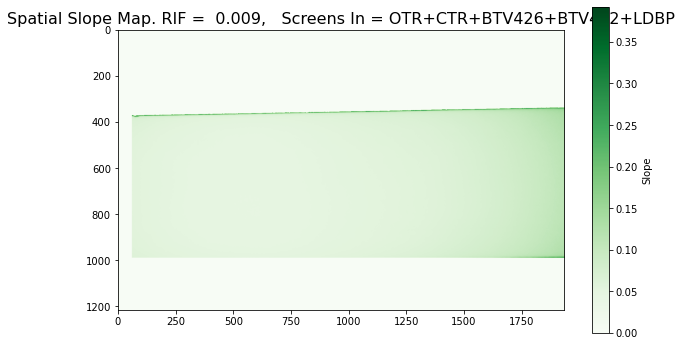

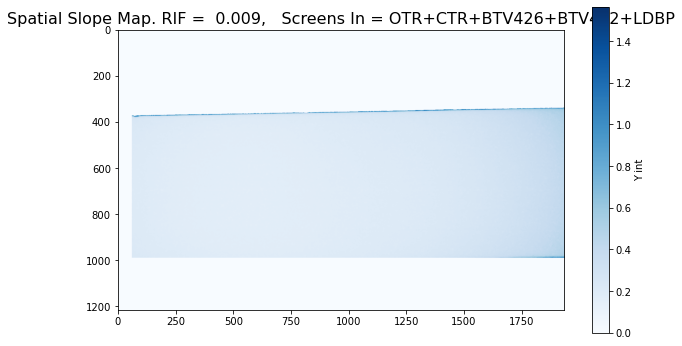

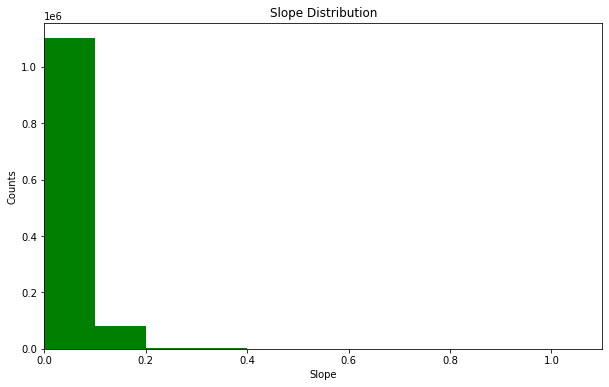

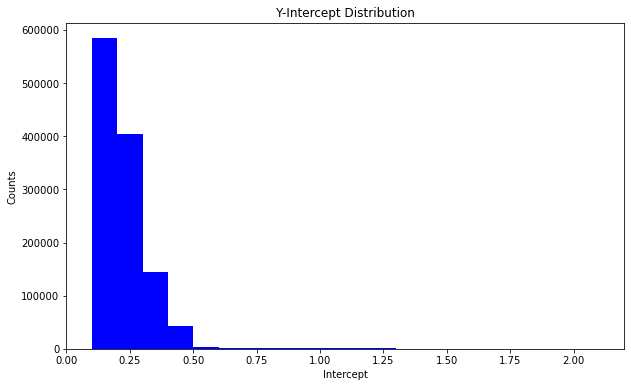

/tmp/ipykernel_496/1964412611.py:30: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


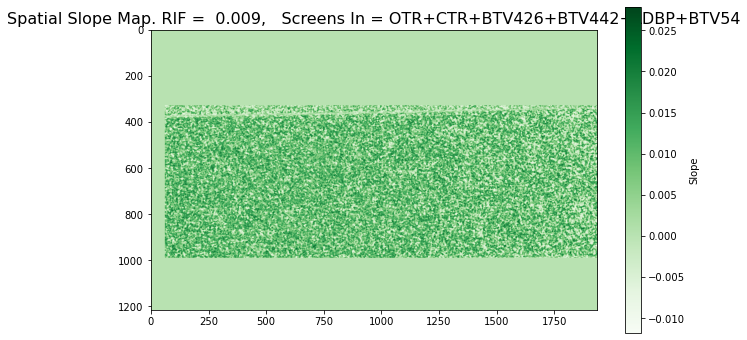

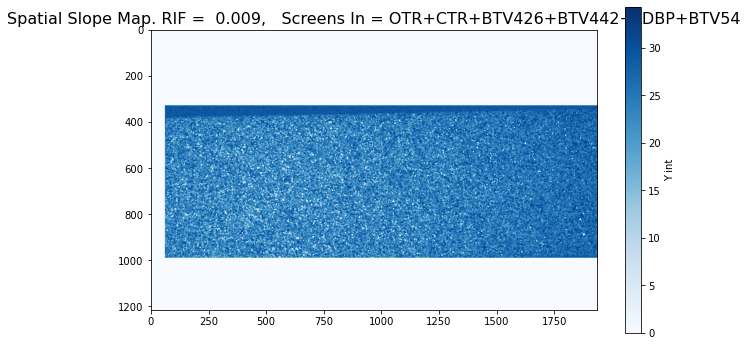

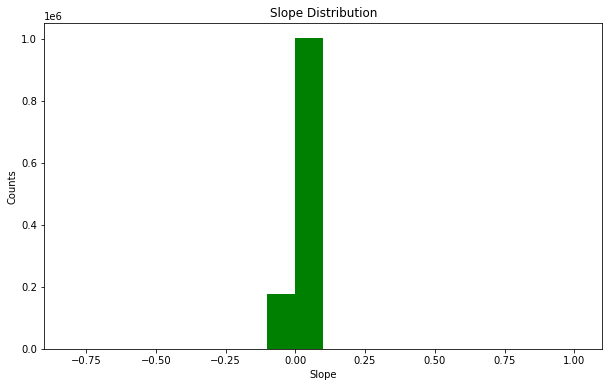

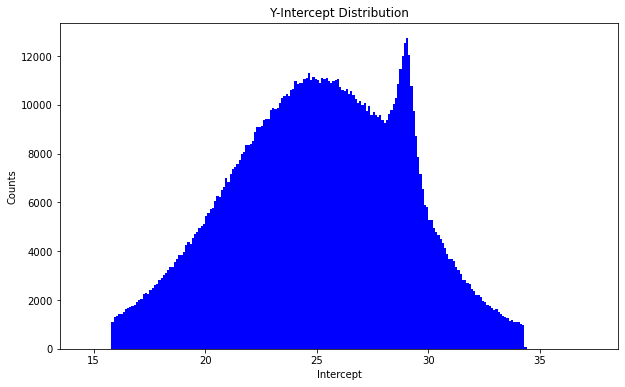

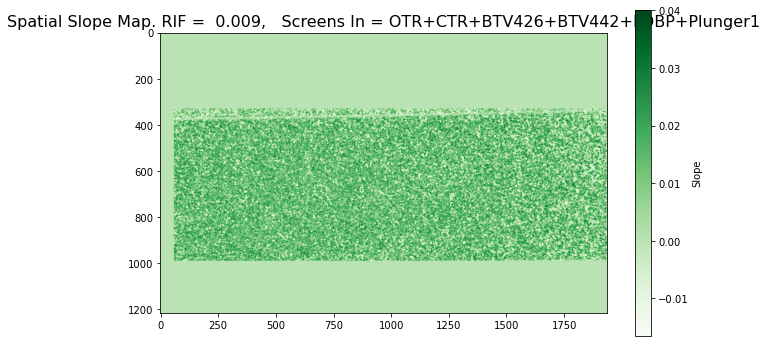

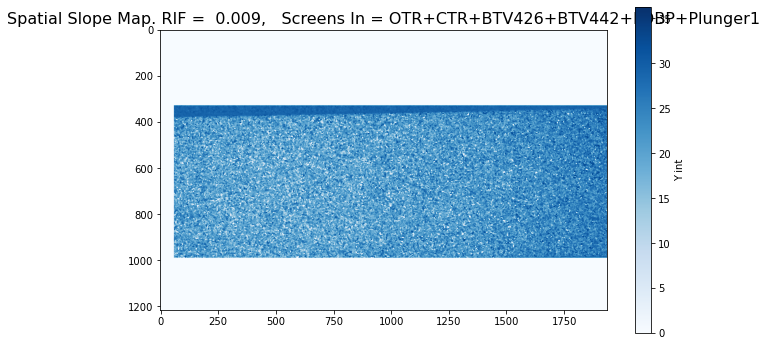

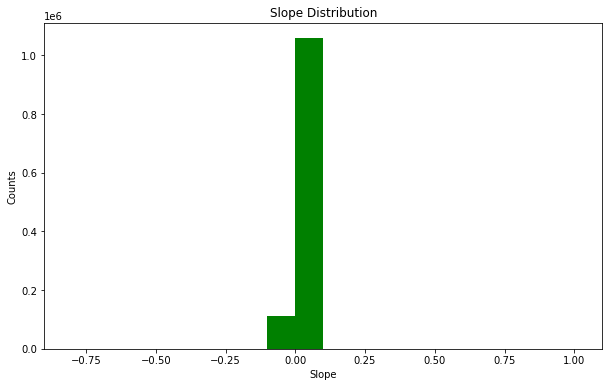

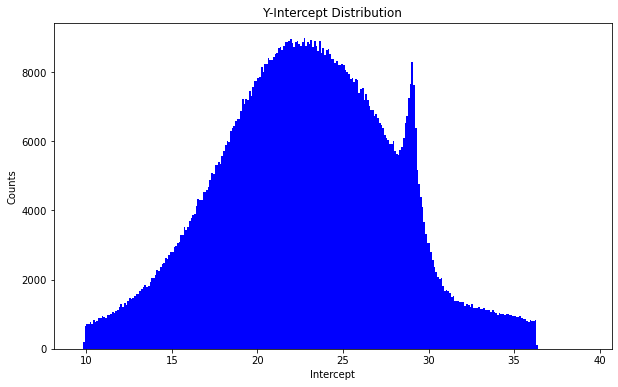

/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:1

Error


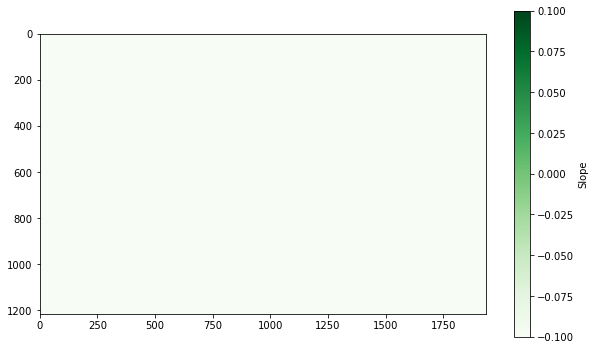

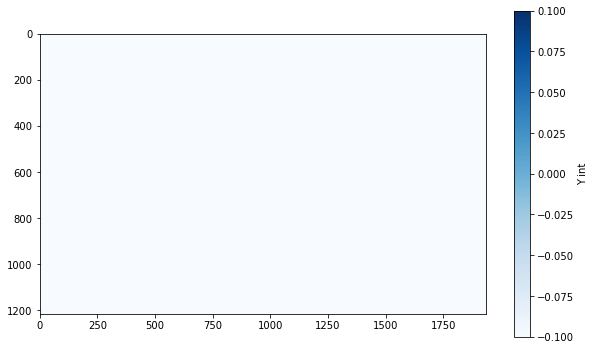

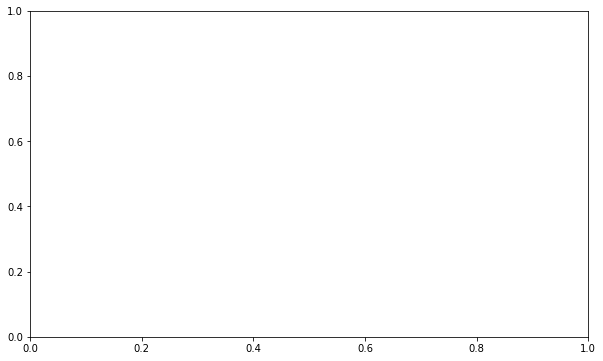

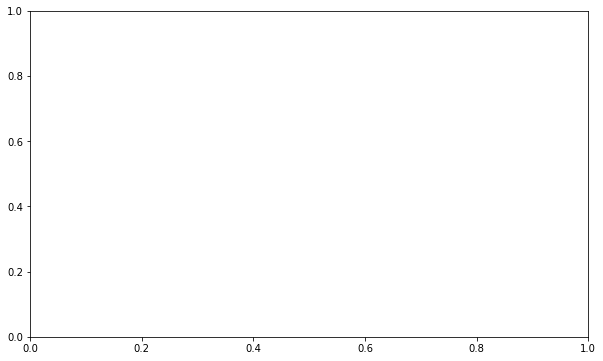

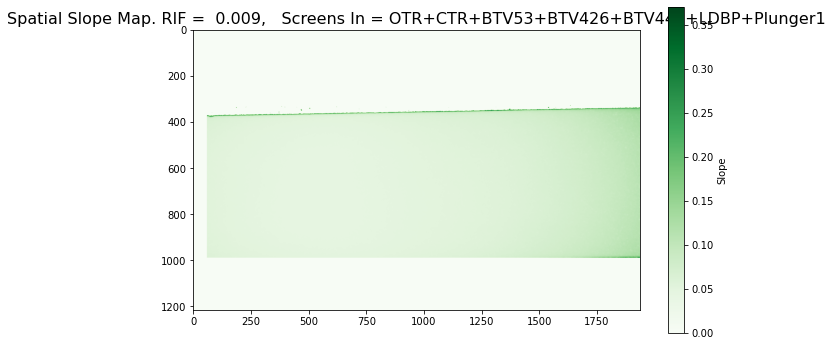

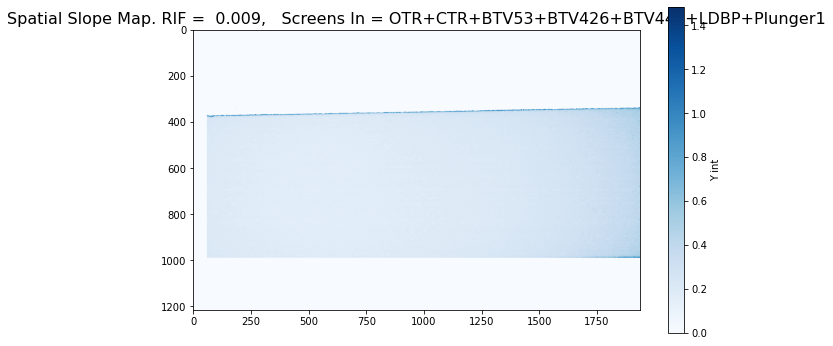

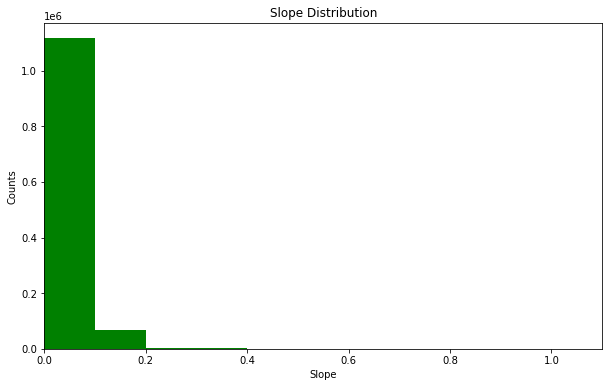

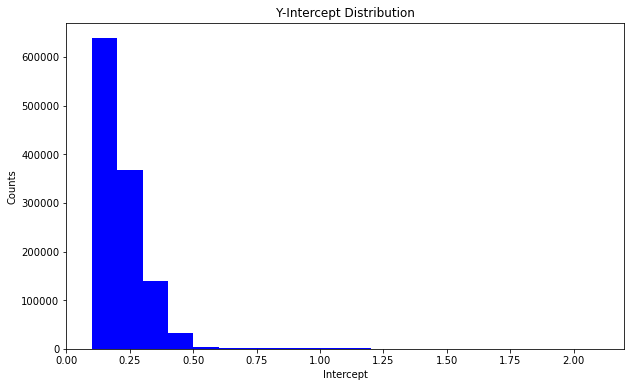

Error


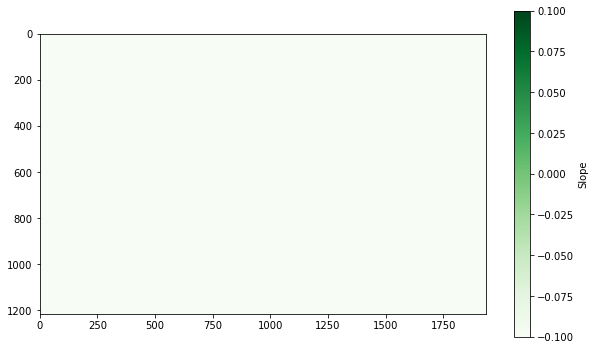

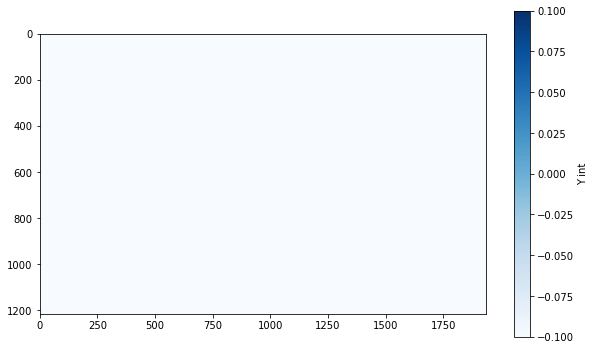

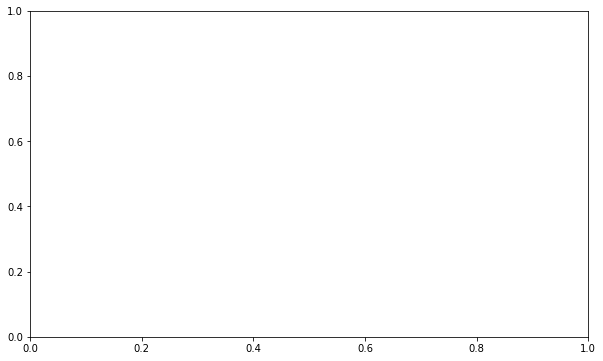

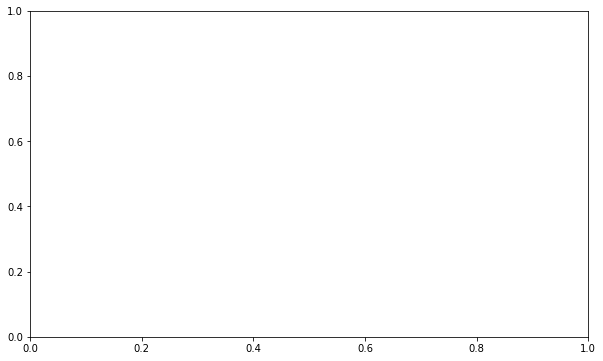

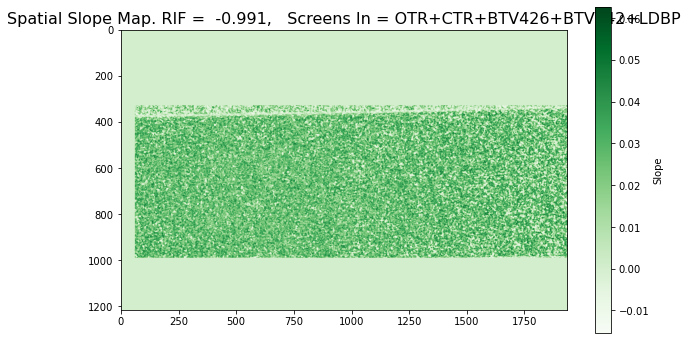

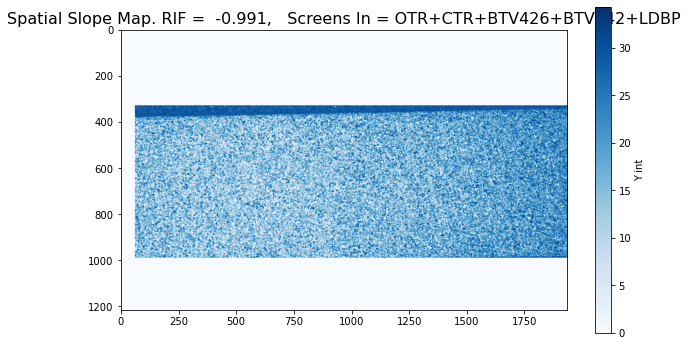

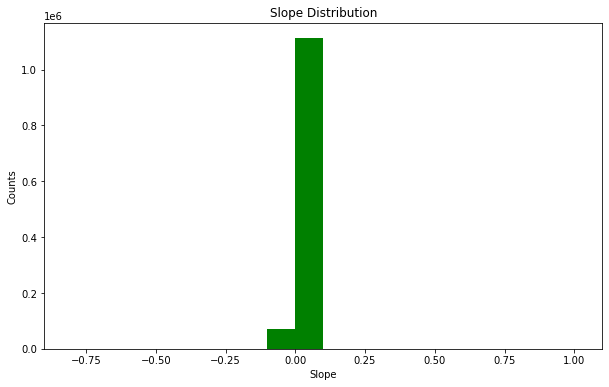

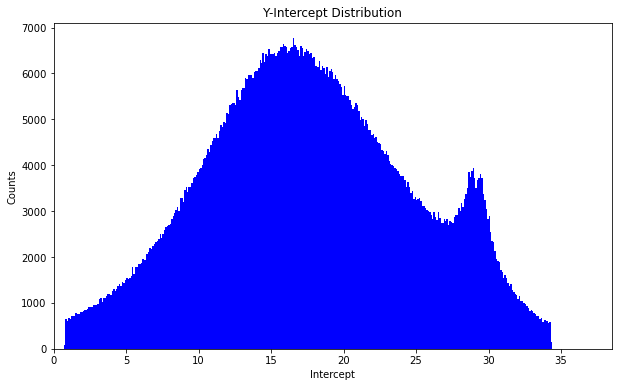

In [11]:
store_slopes_std_filtering(spectro_2_16_05)

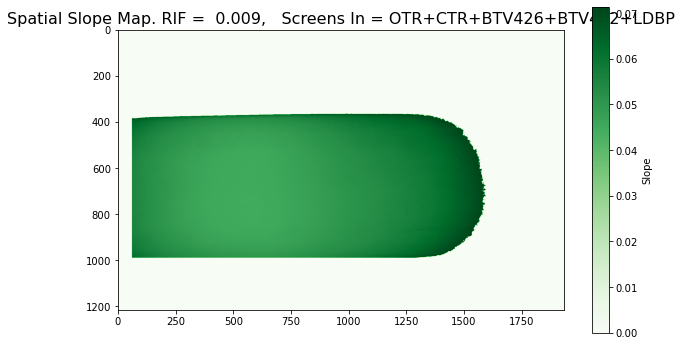

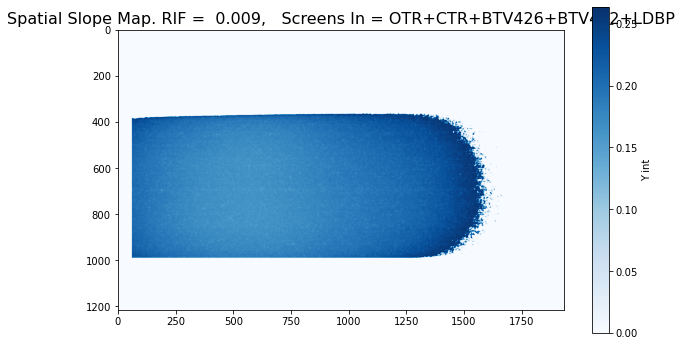

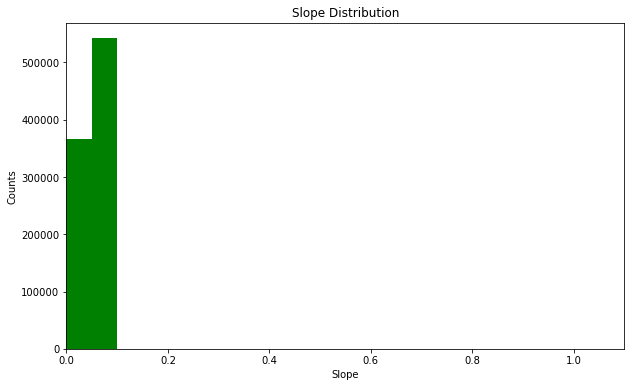

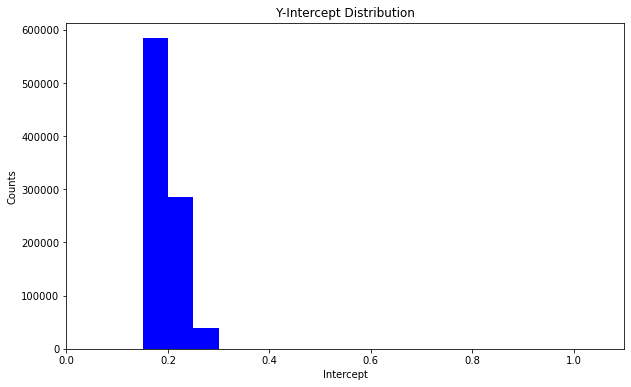

/tmp/ipykernel_496/408449721.py:30: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


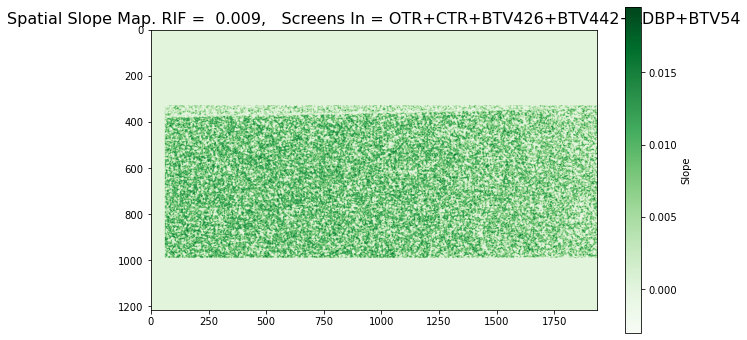

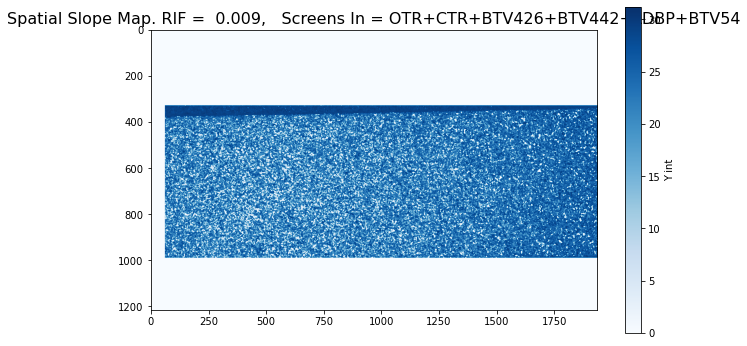

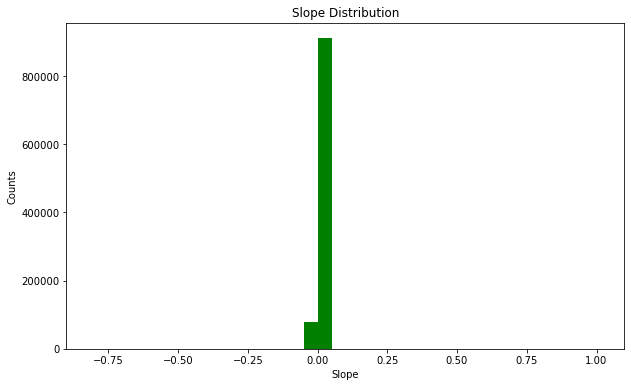

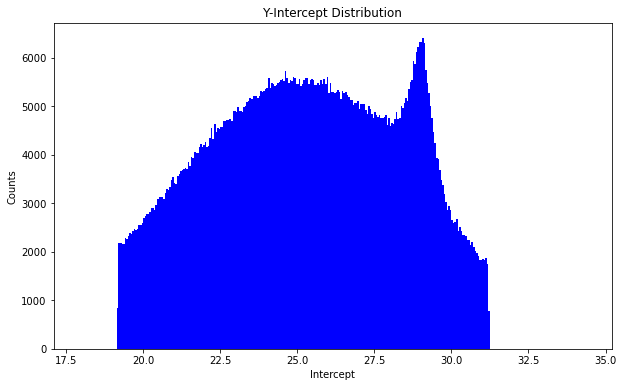

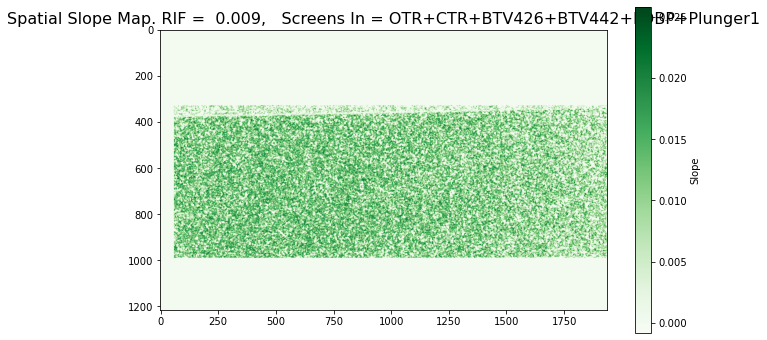

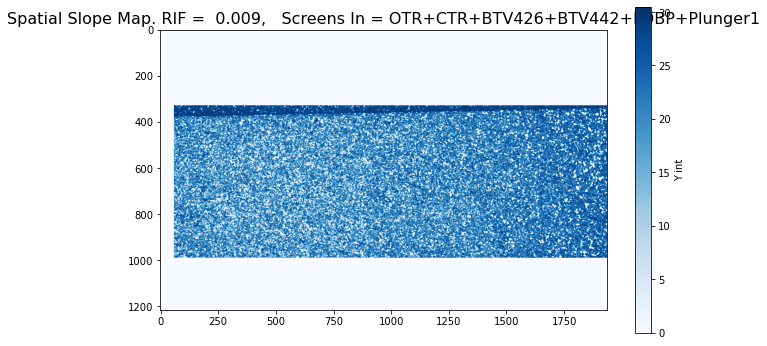

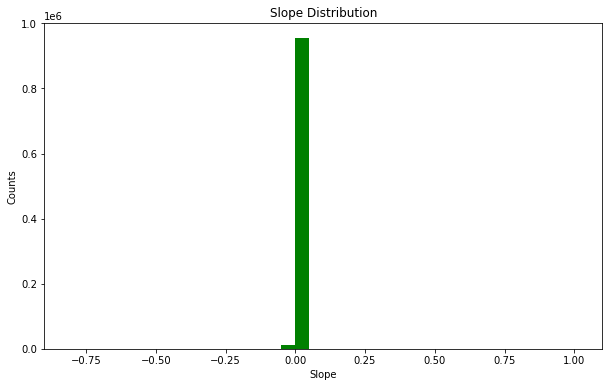

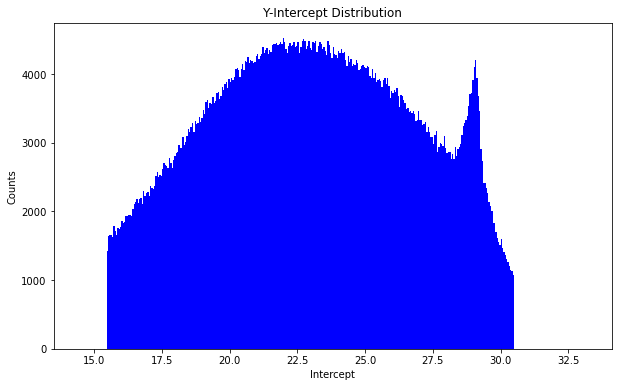

Error


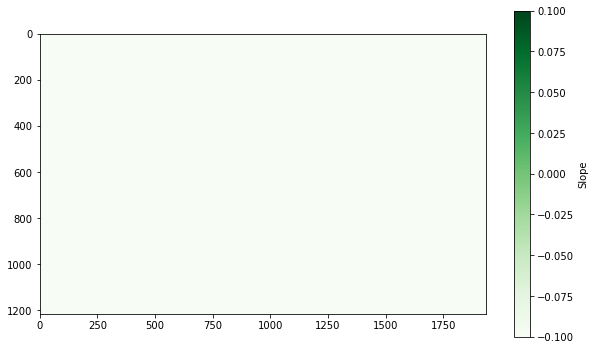

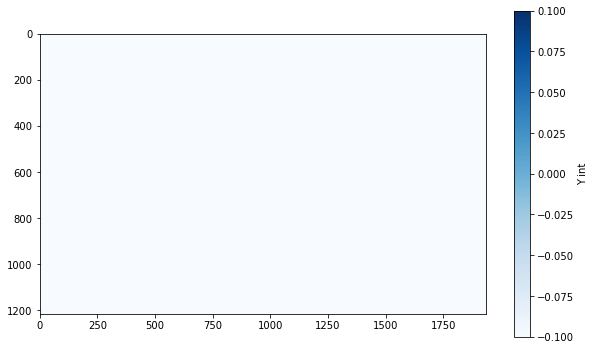

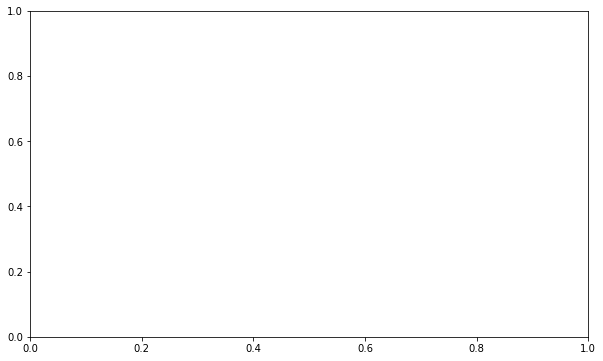

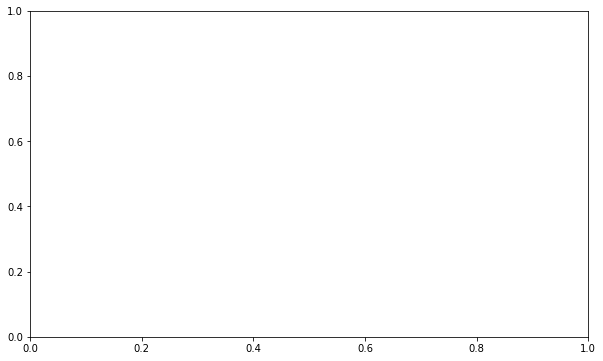

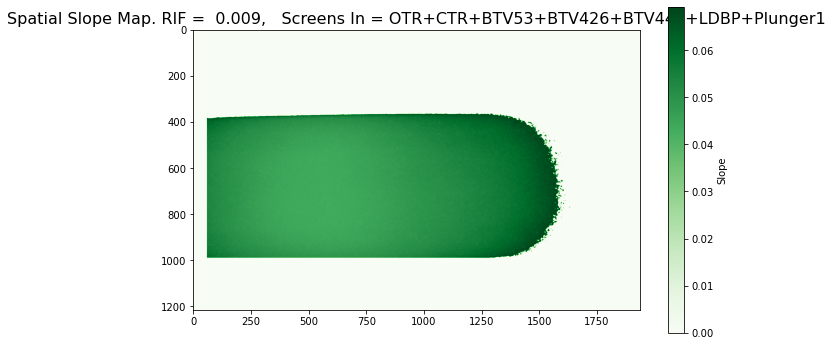

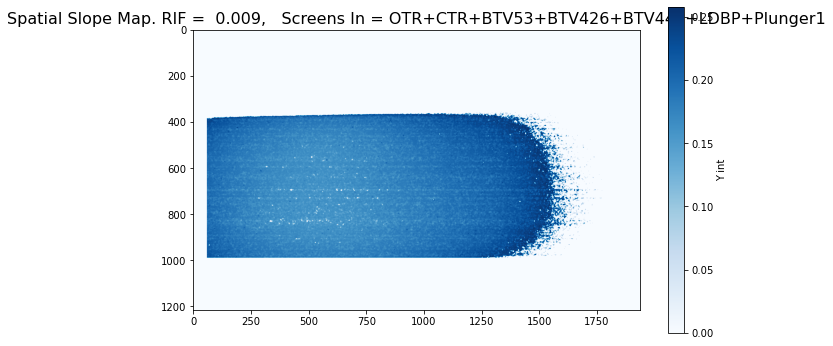

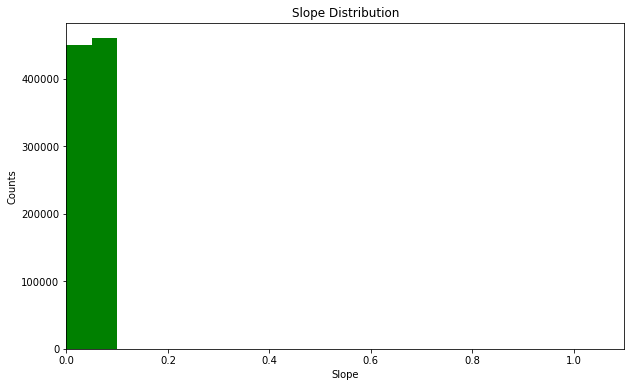

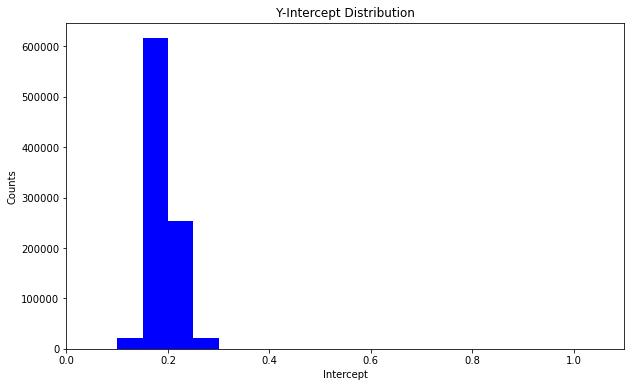

Error


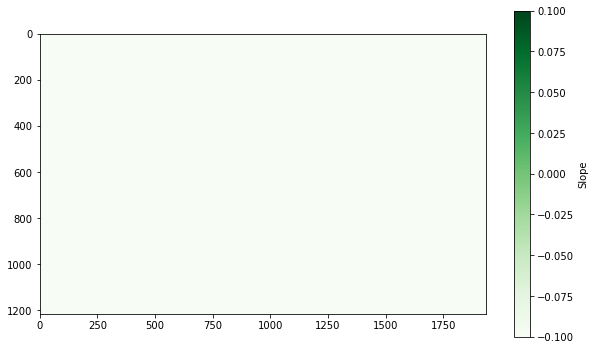

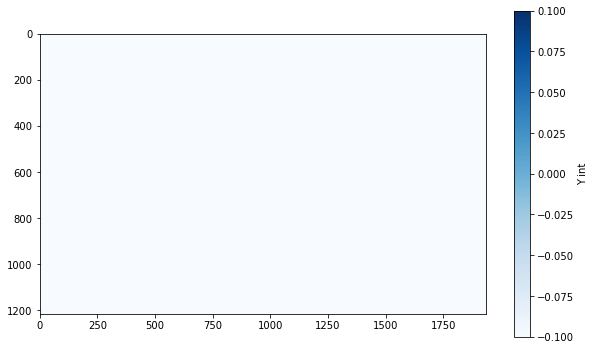

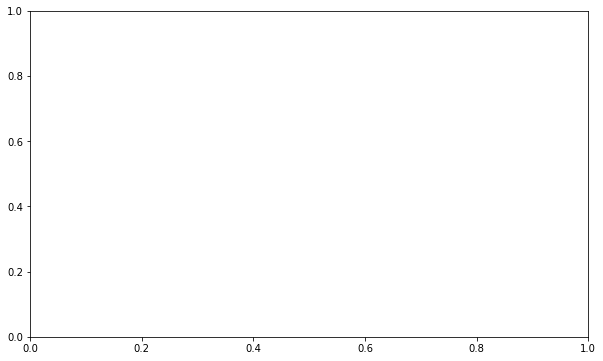

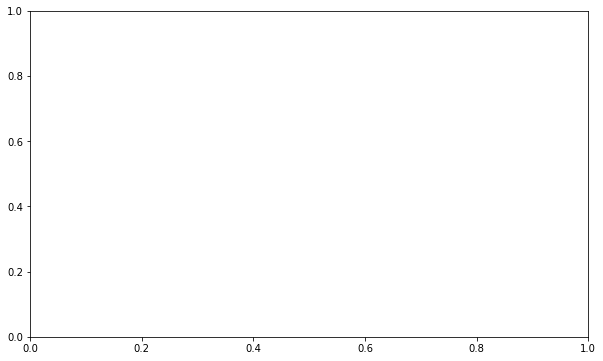

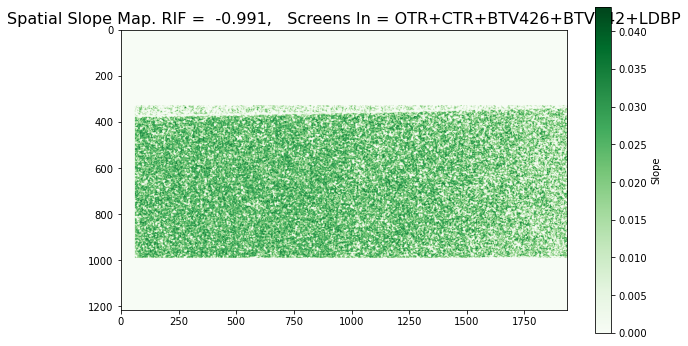

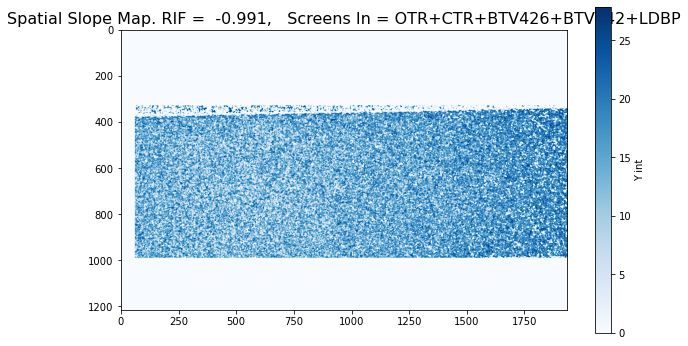

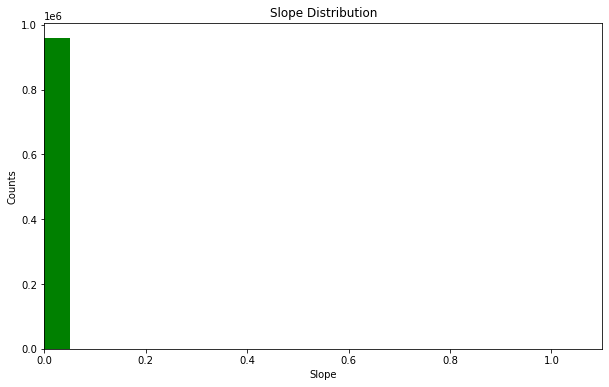

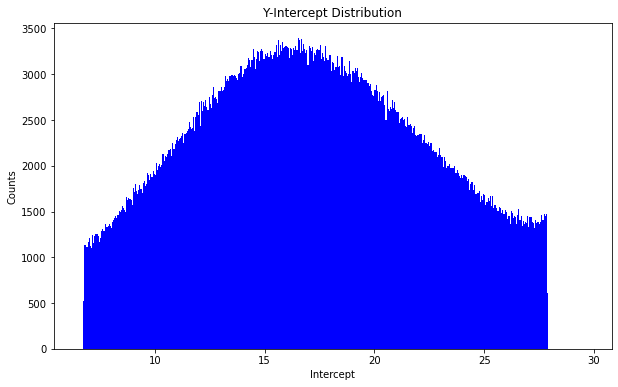

In [12]:
store_slopes_mad_filtering(spectro_2_16_05)

# Spectro 3

In [ ]:
spectro_3_16_05 = sort_by_space_scin_screen(660,1876,100,'2025/05/16',3)

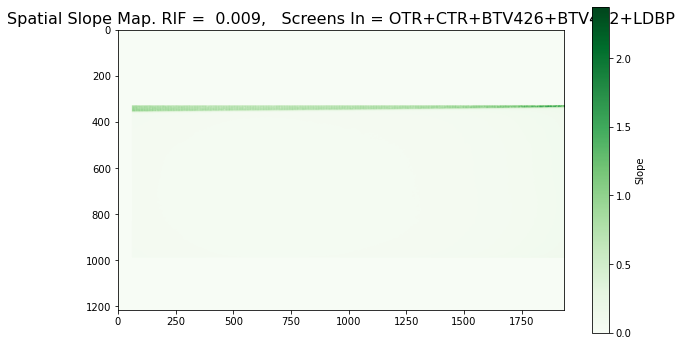

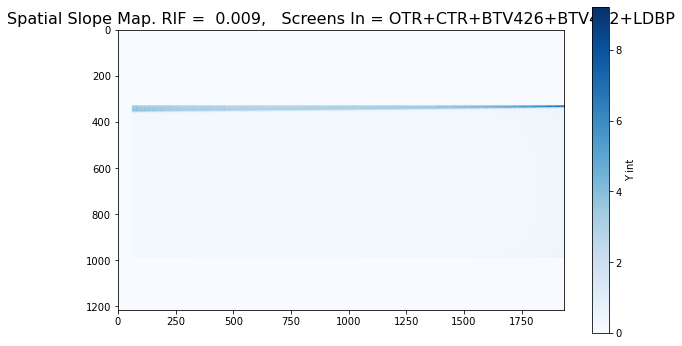

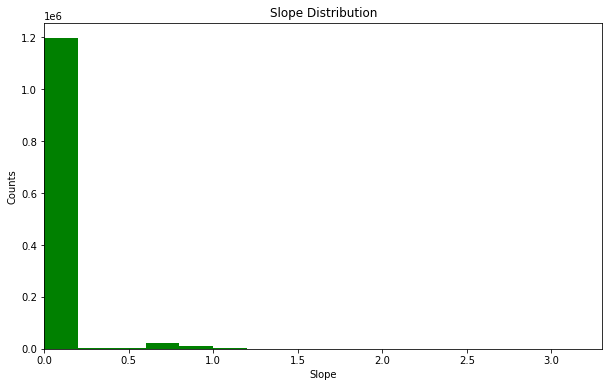

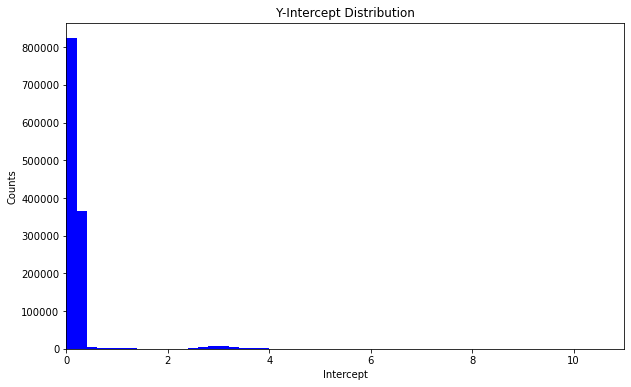

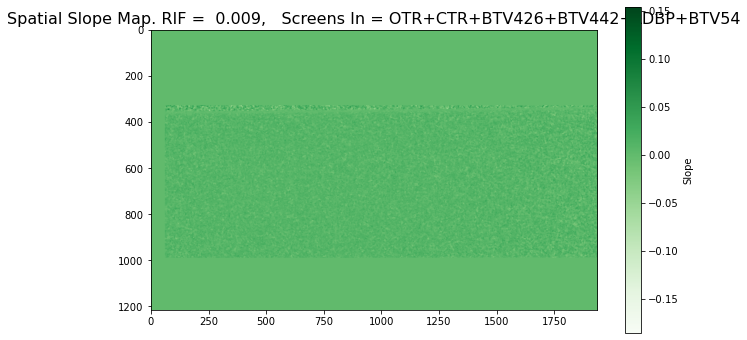

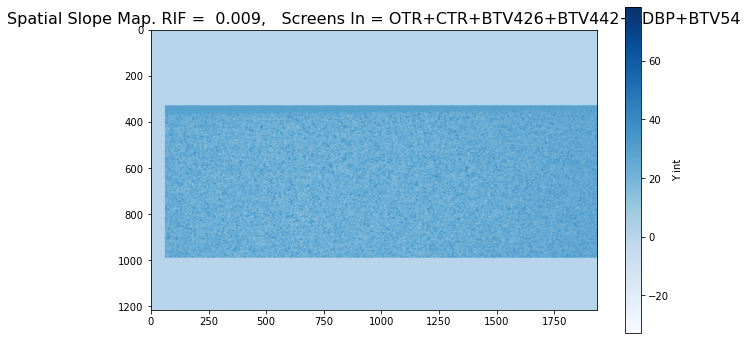

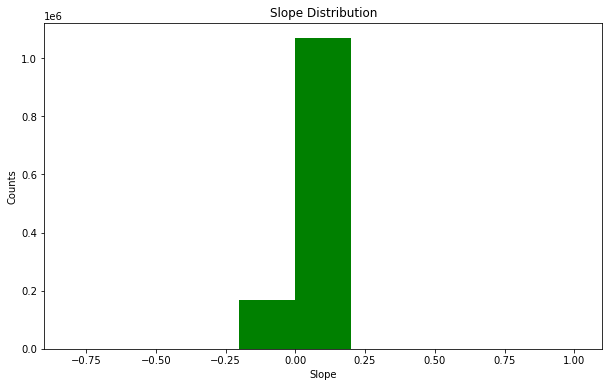

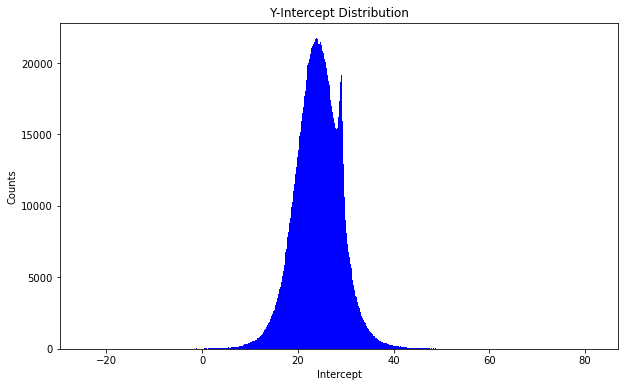

/tmp/ipykernel_463/3616925976.py:32: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


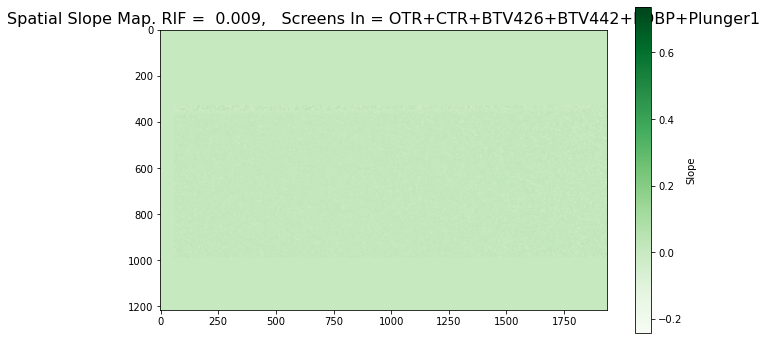

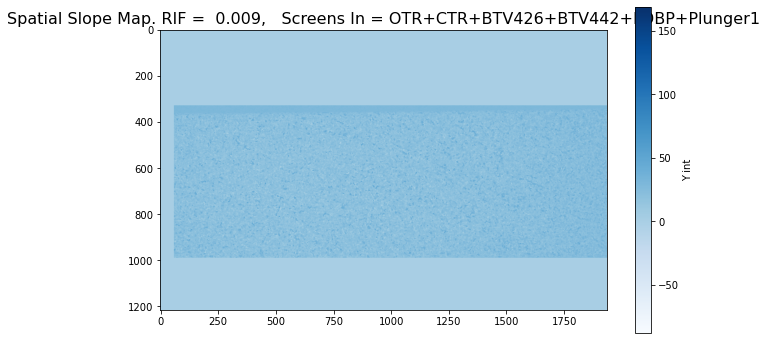

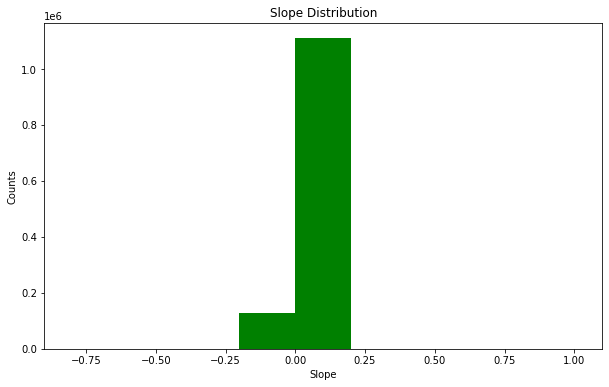

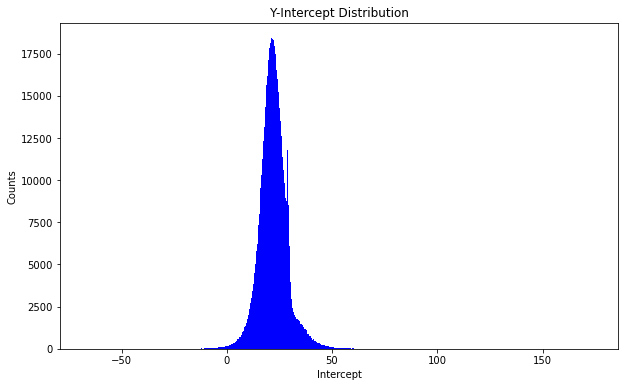

Error
Error
Error
Error


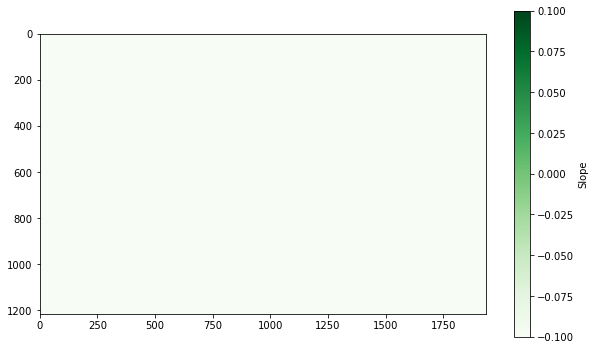

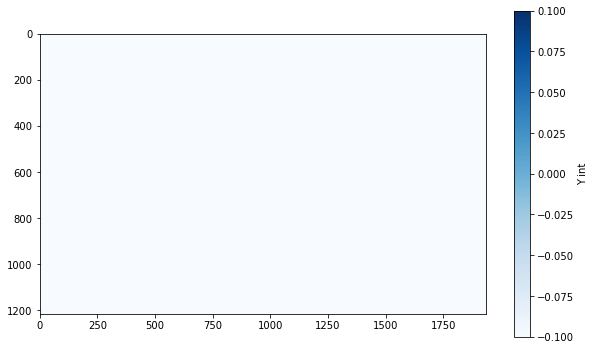

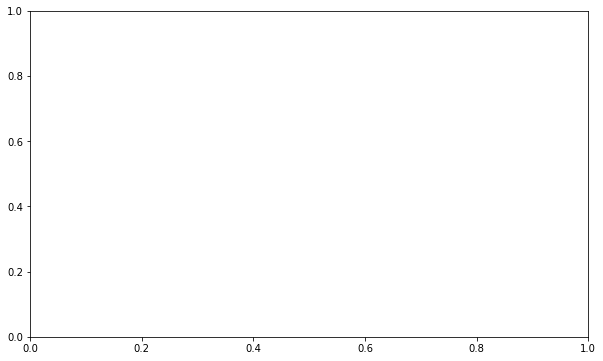

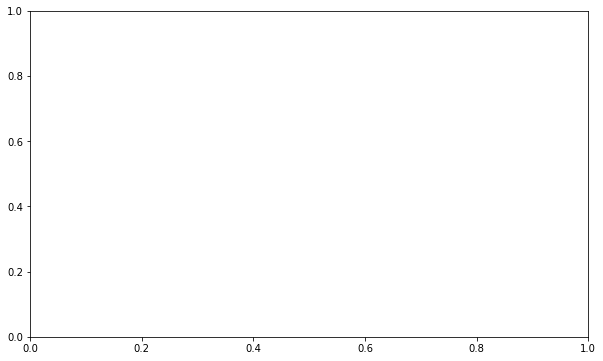

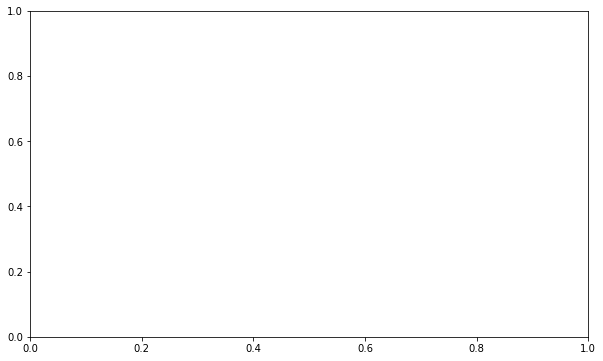

...

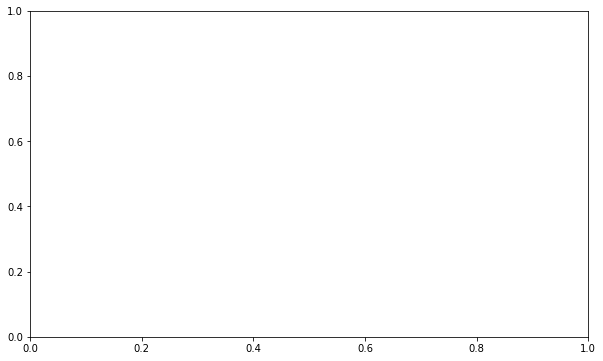

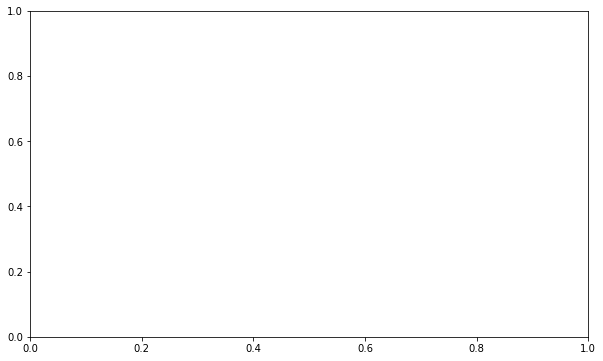

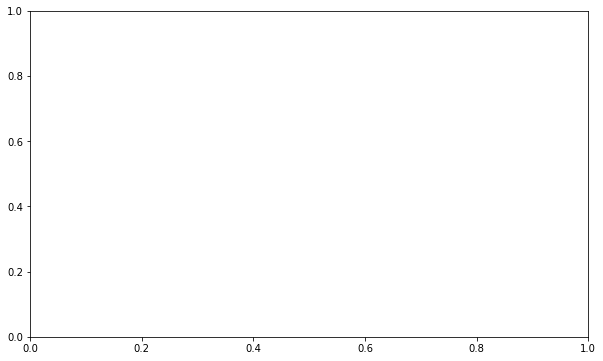

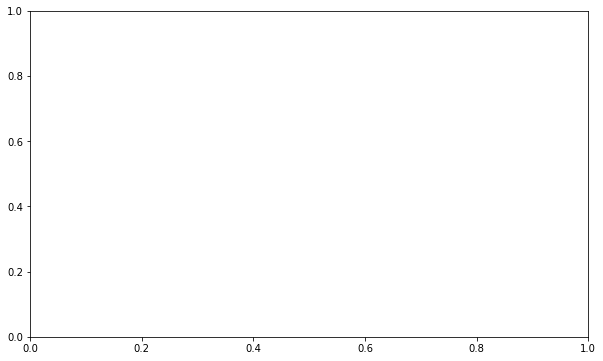

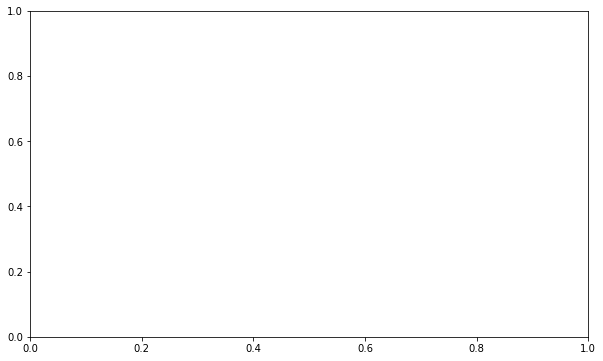

In [10]:
store_slopes_no_filtering(spectro_3_16_05)

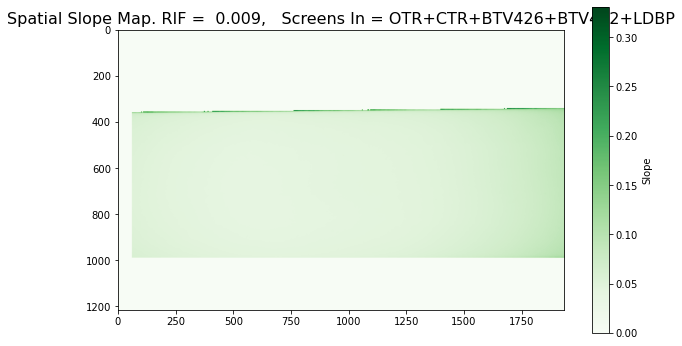

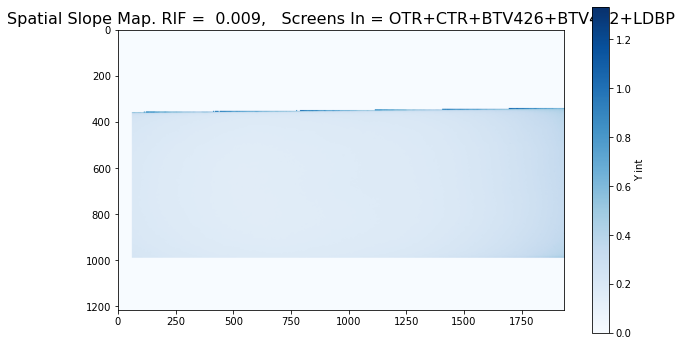

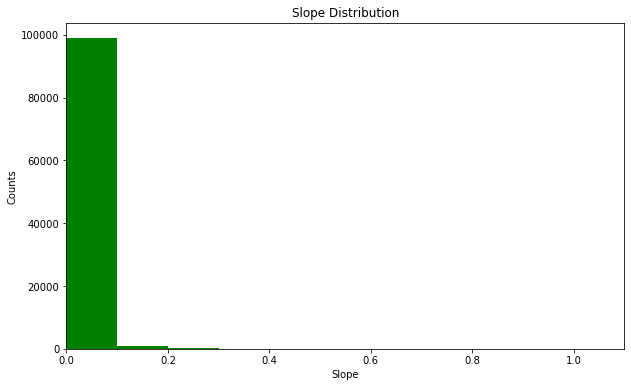

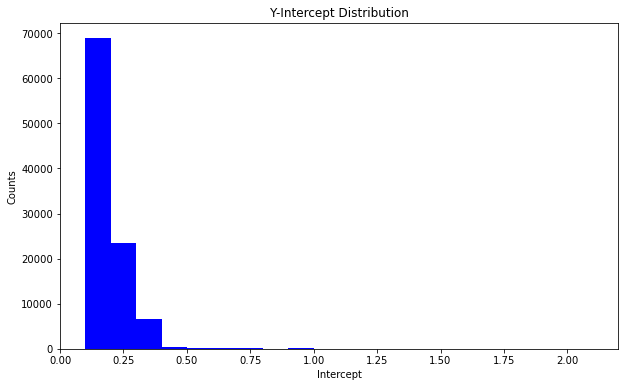

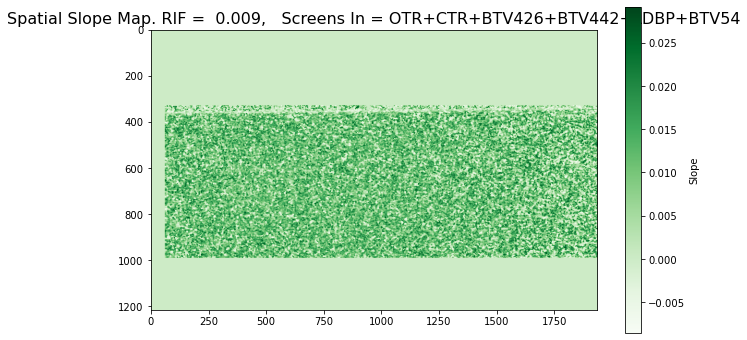

...

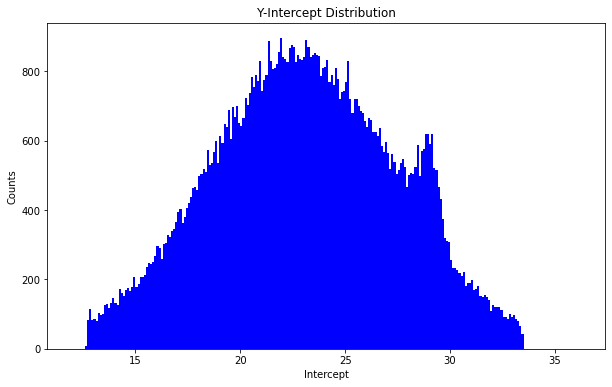

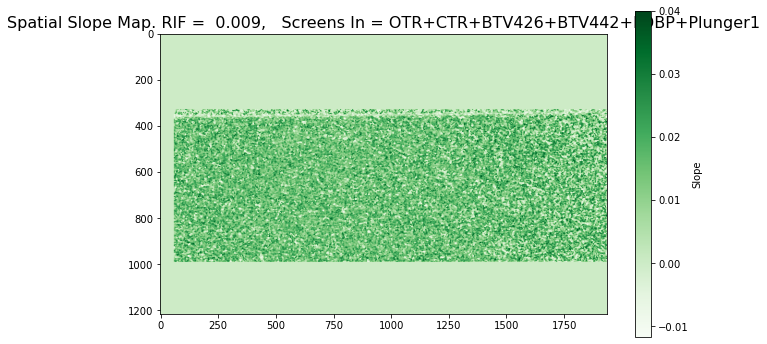

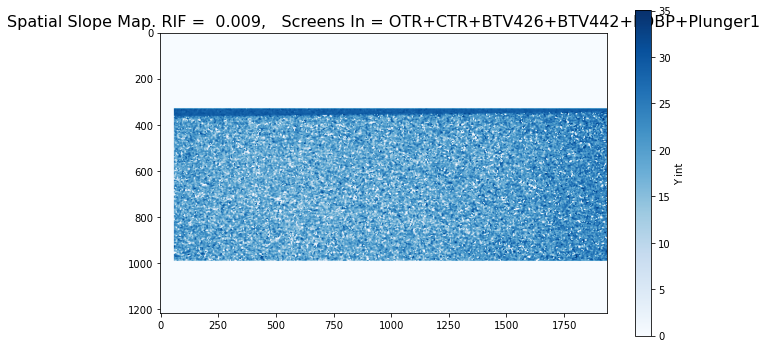

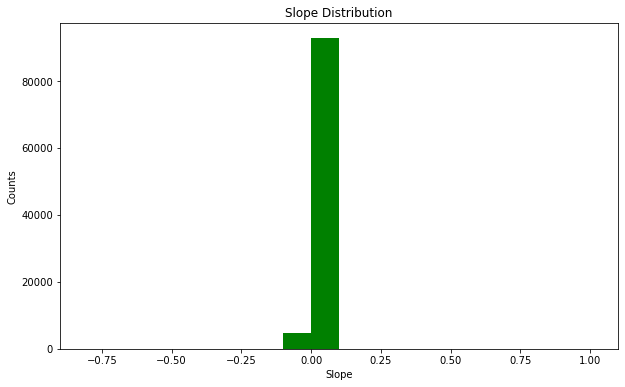

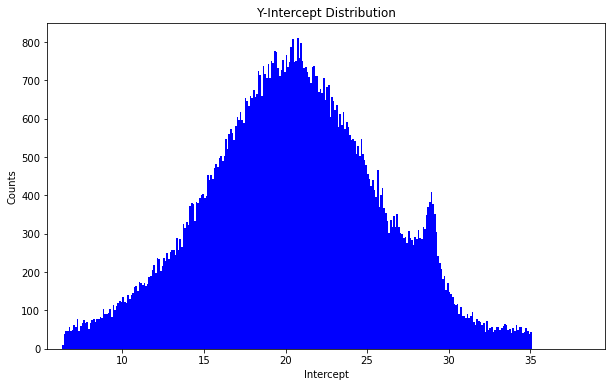

Error


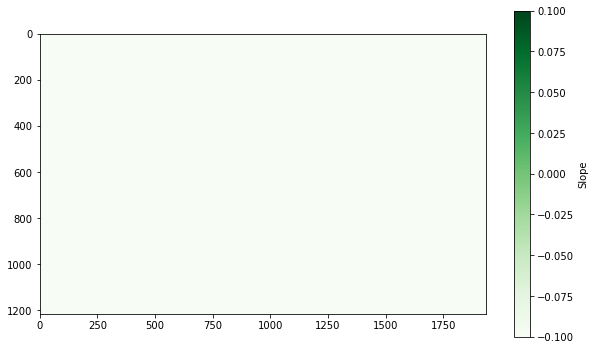

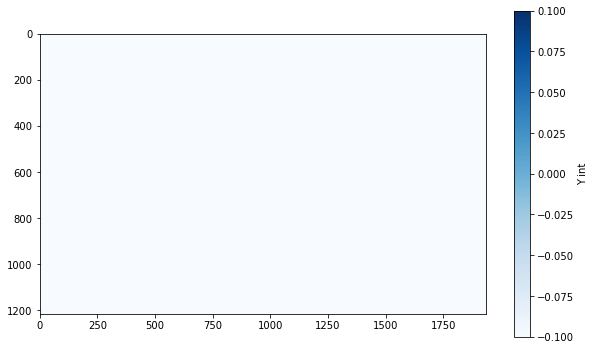

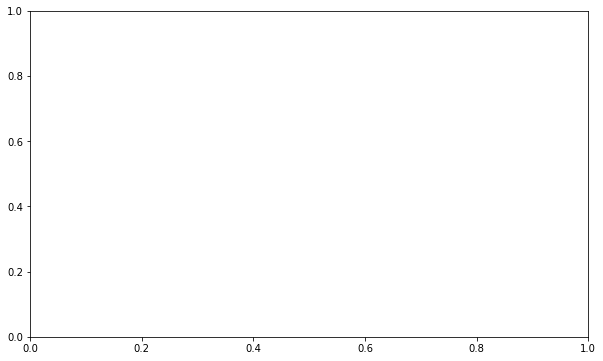

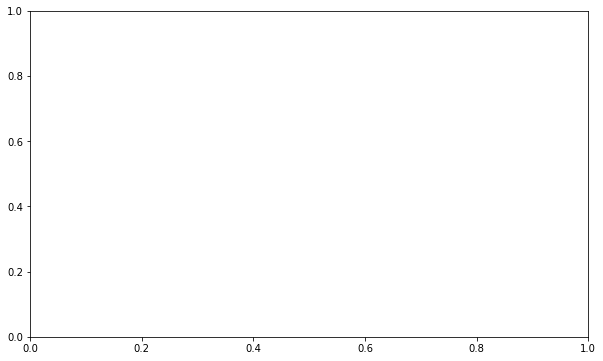

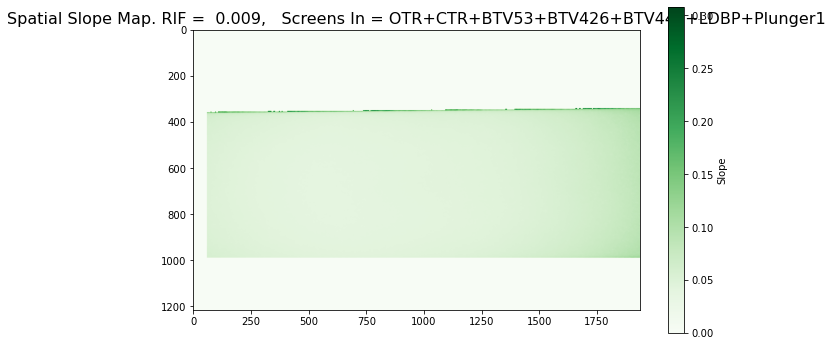

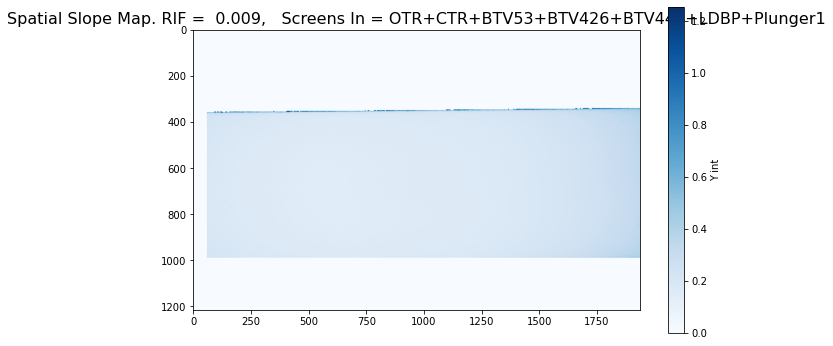

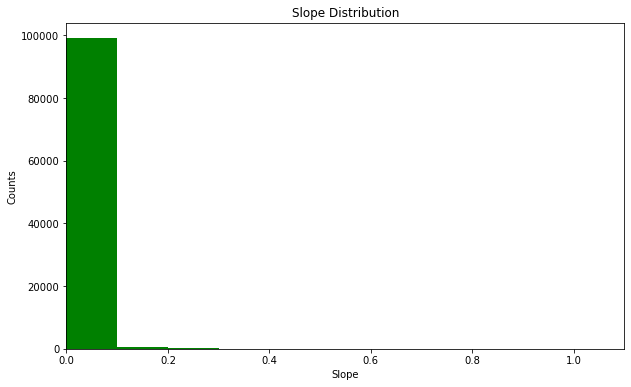

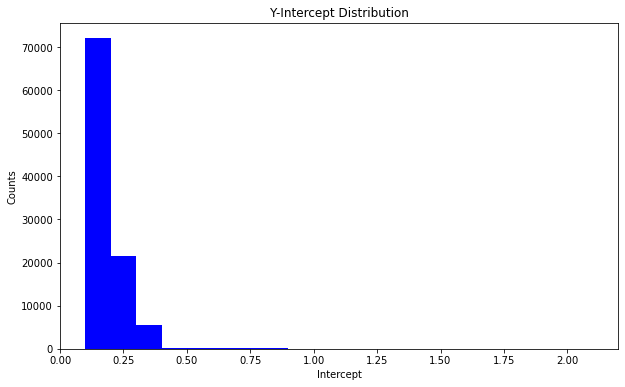

Error


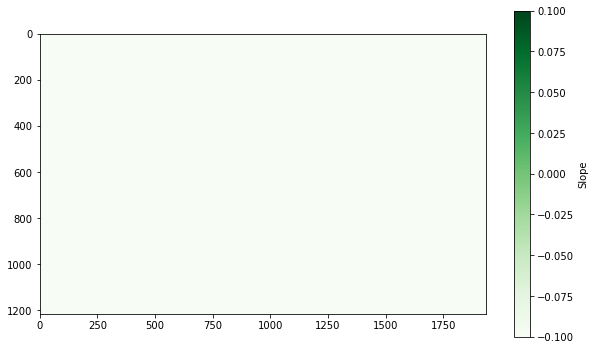

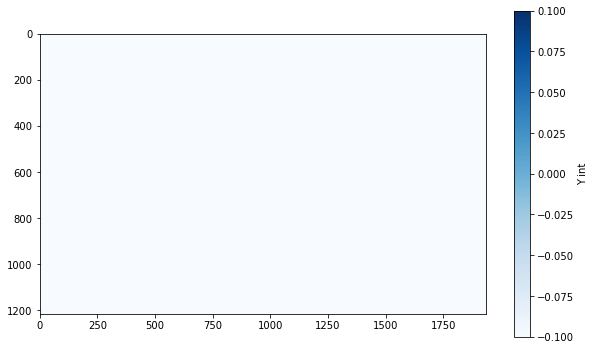

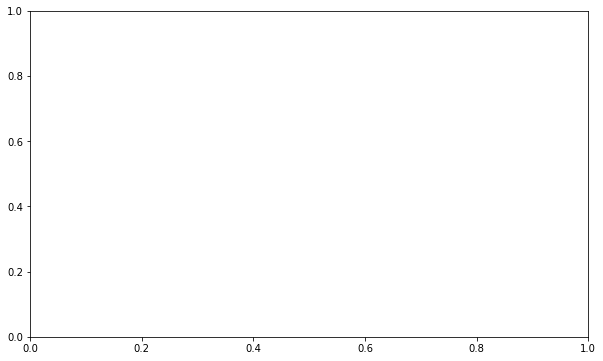

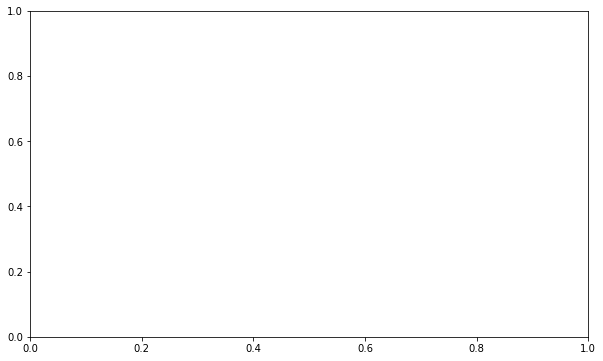

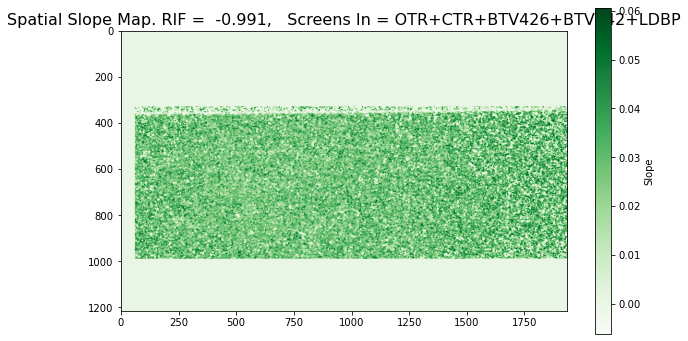

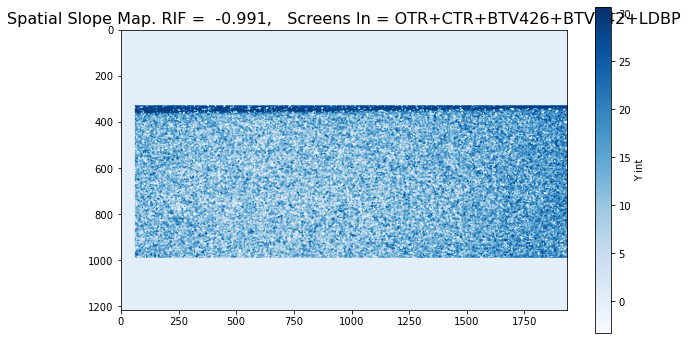

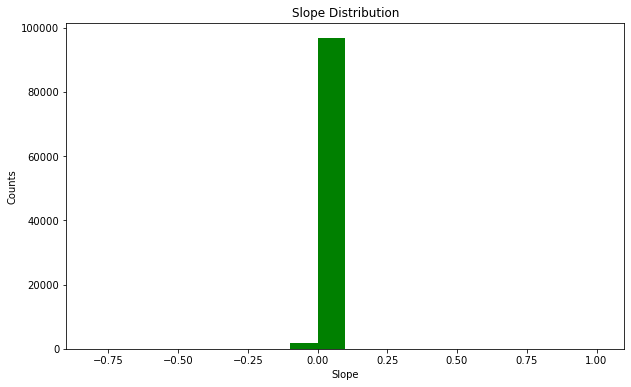

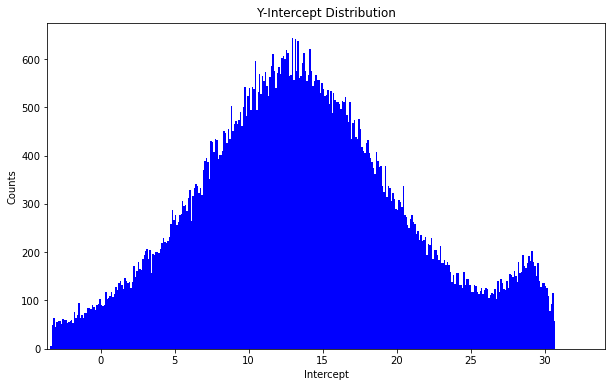

In [16]:
store_slopes_std_filtering(spectro_3_16_05)

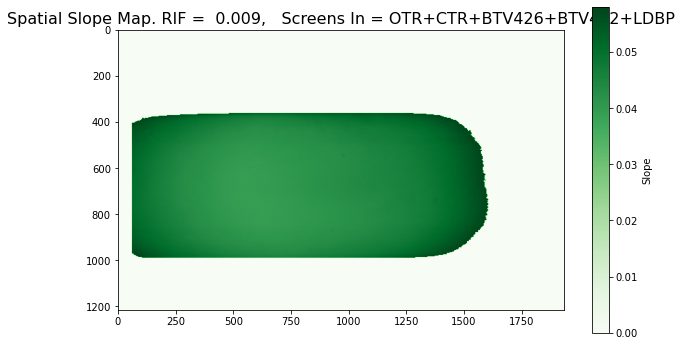

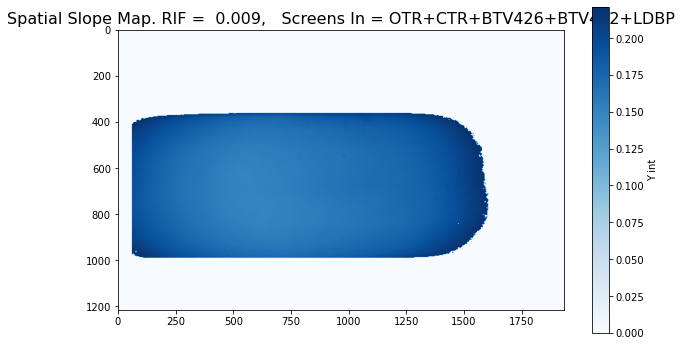

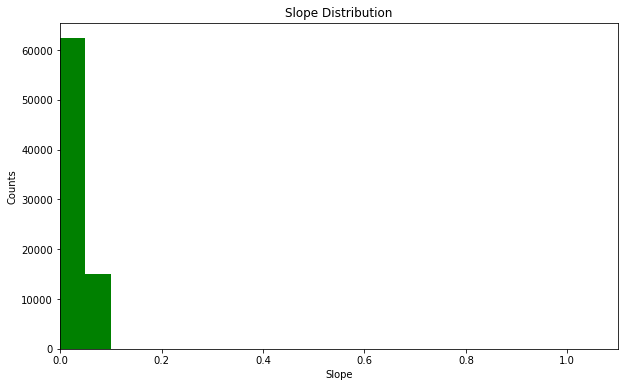

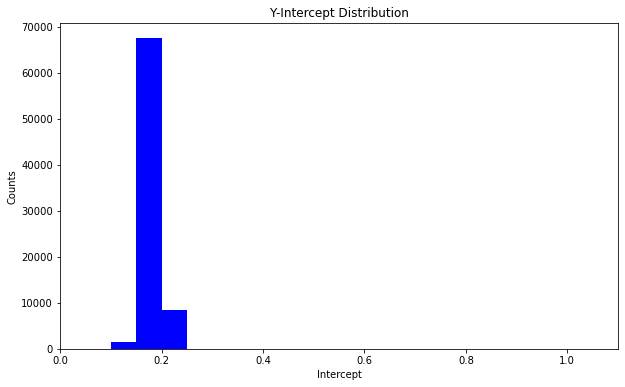

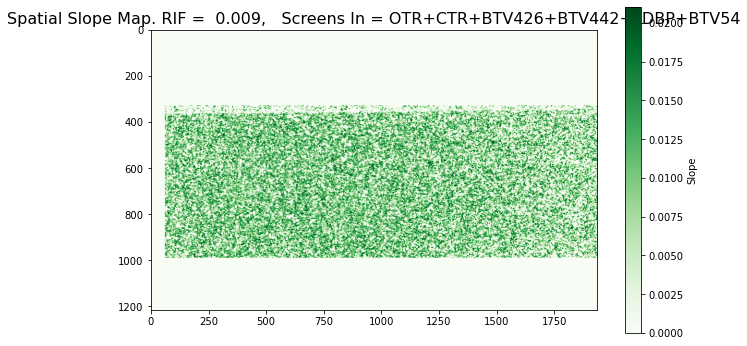

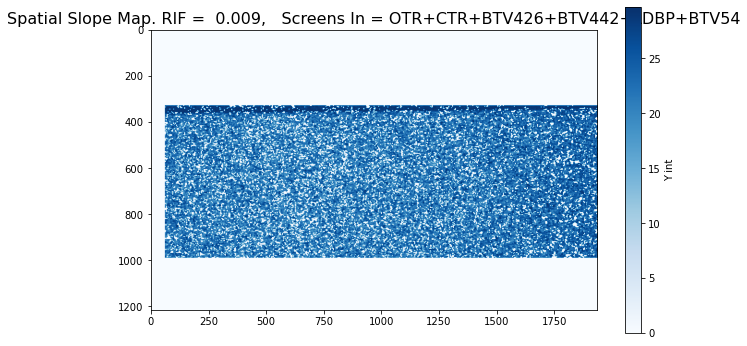

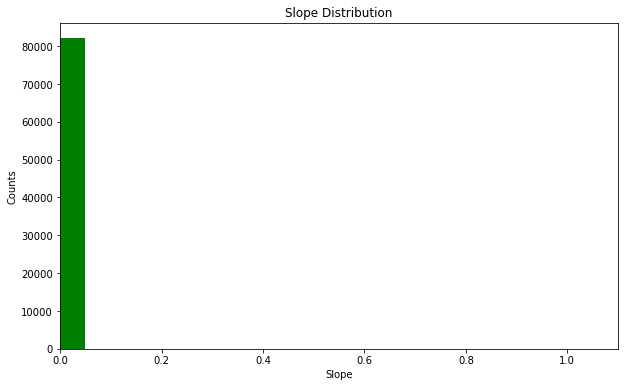

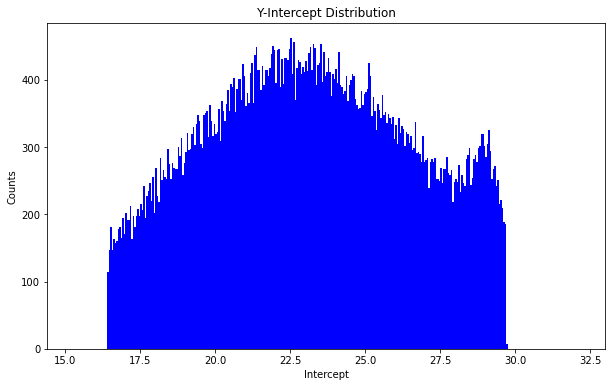

KeyboardInterrupt: 

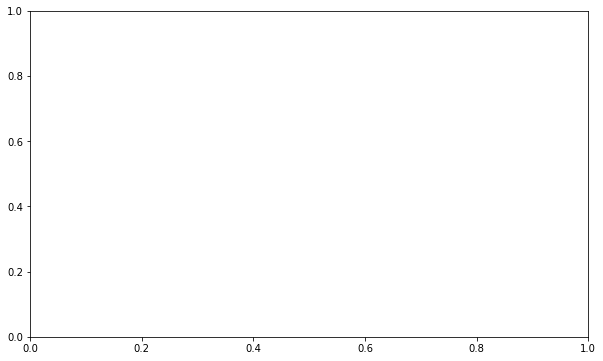

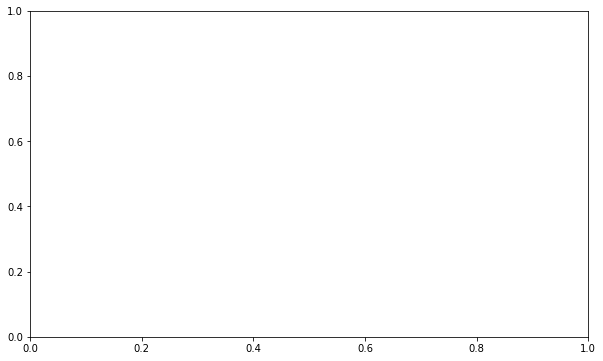

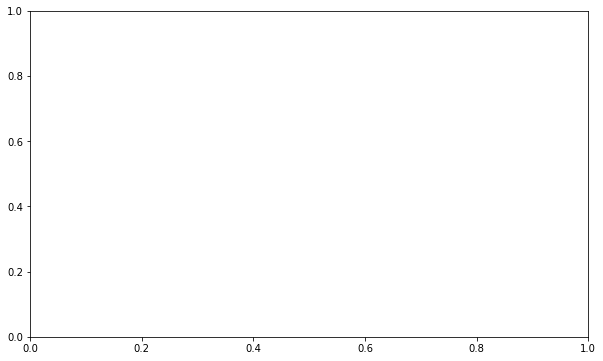

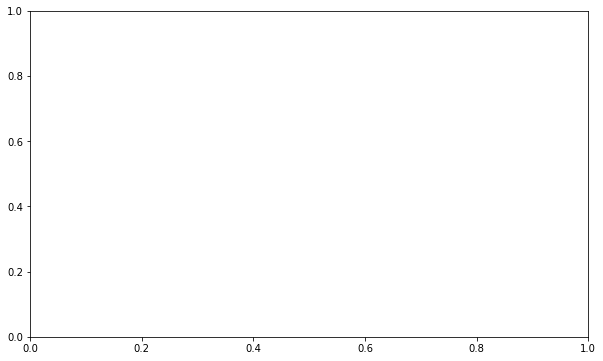

In [17]:
store_slopes_mad_filtering(spectro_3_16_05)

# Spectro 4

In [9]:
spectro_4_16_05 = sort_by_space_scin_screen(660,1876,100,'2025/05/16',4)

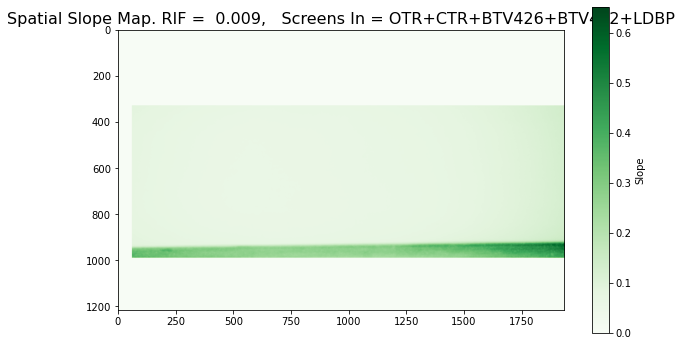

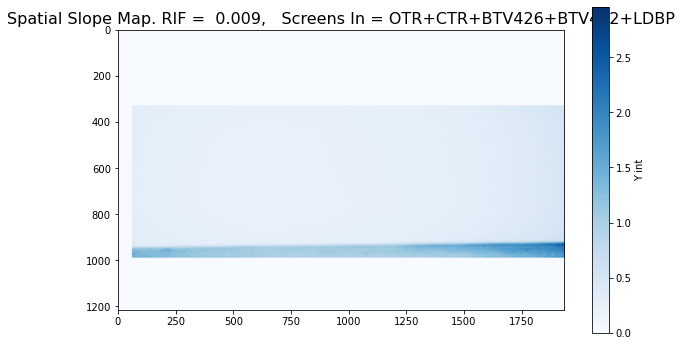

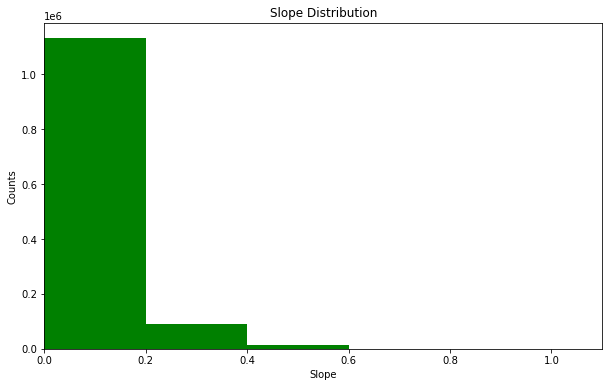

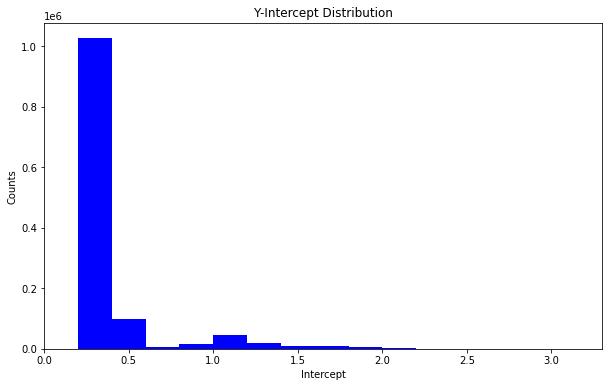

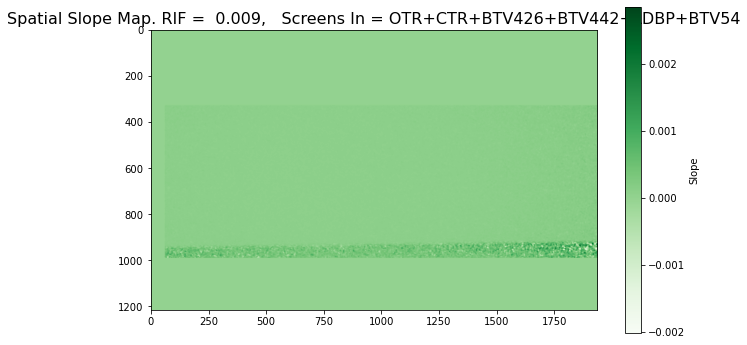

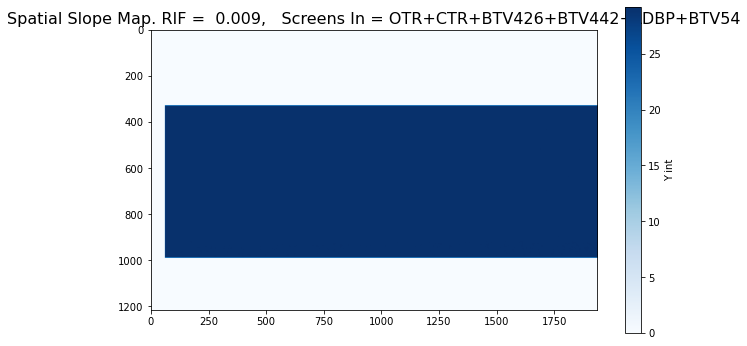

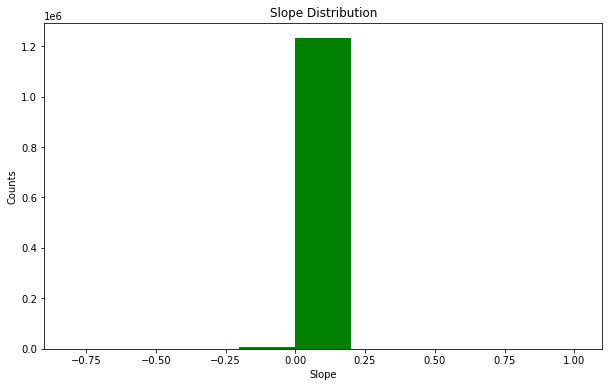

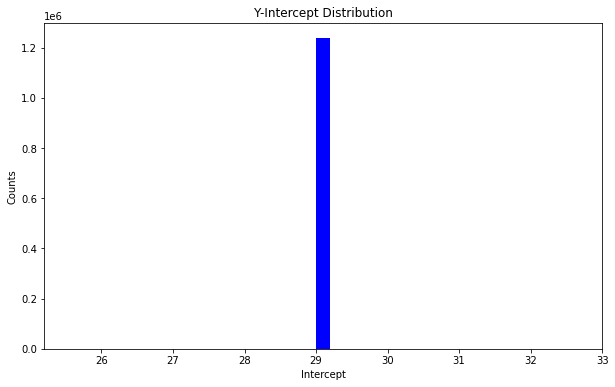

/tmp/ipykernel_491/3616925976.py:32: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


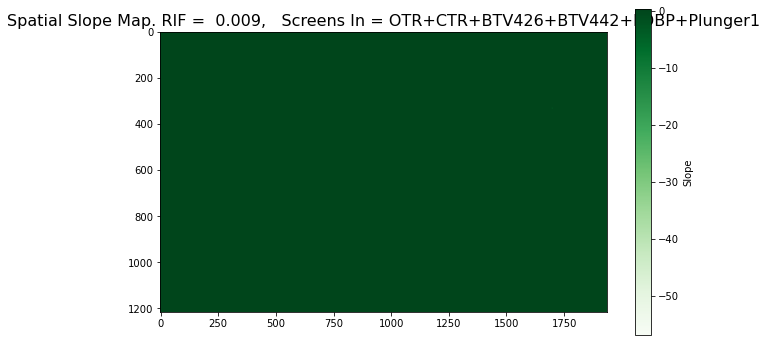

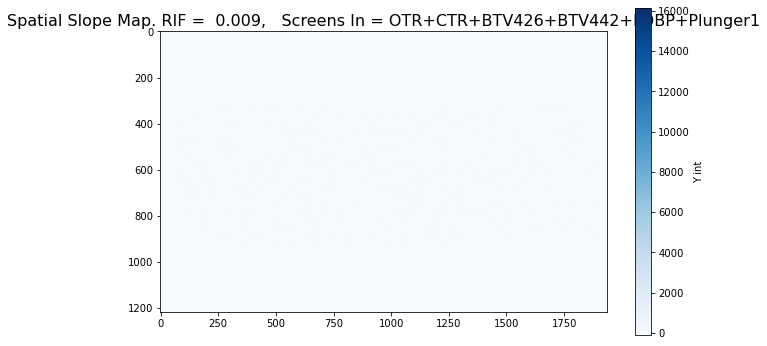

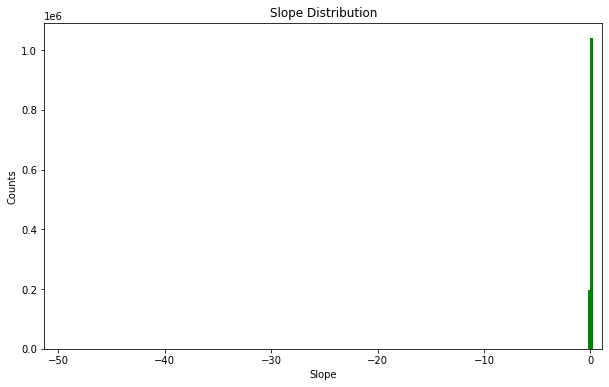

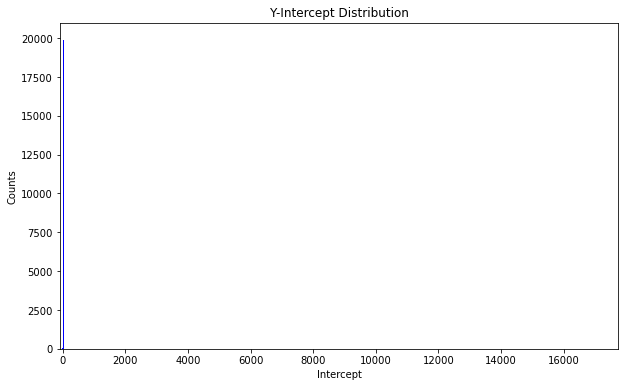

Error


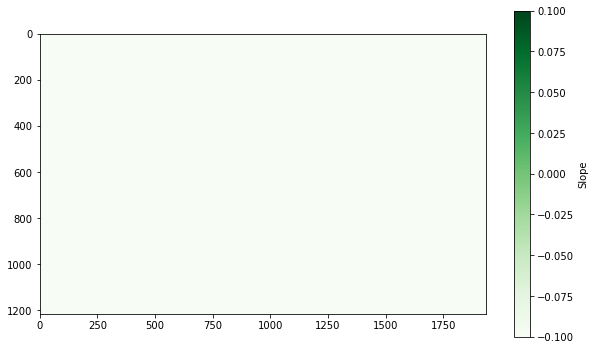

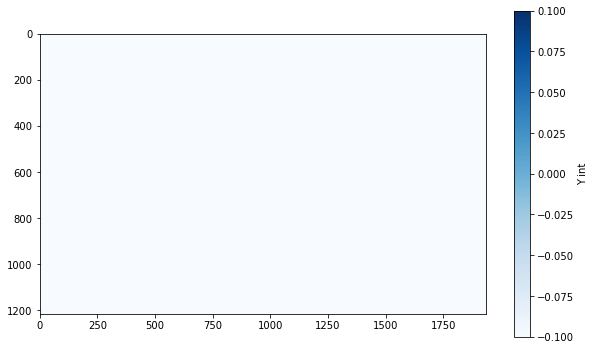

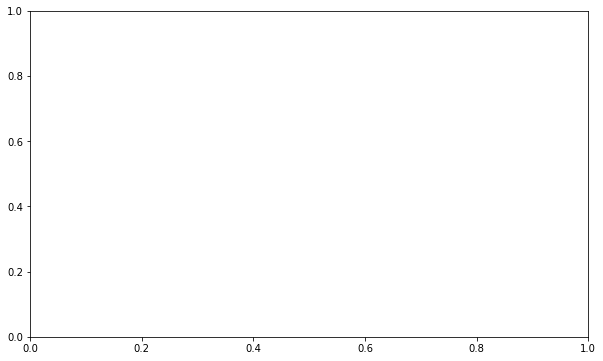

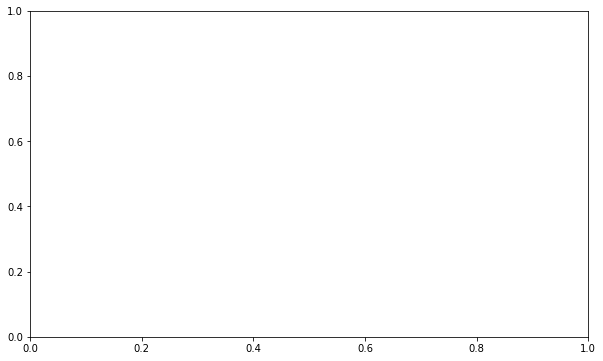

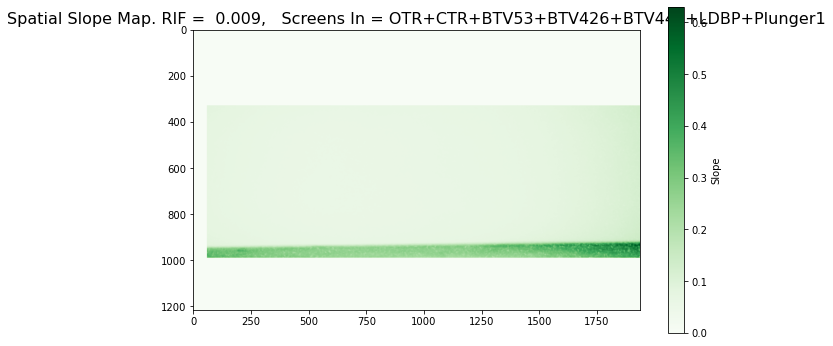

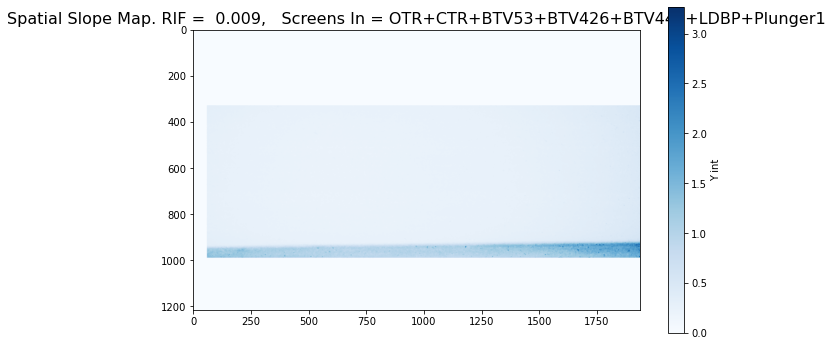

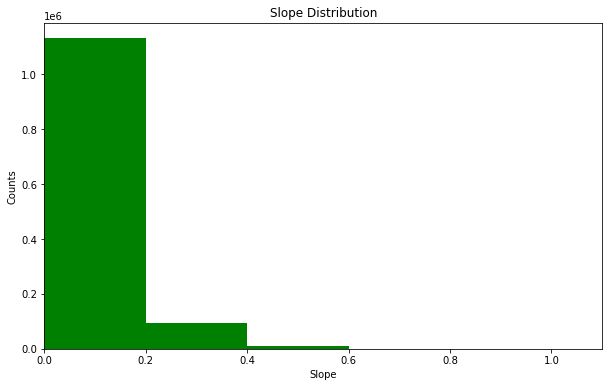

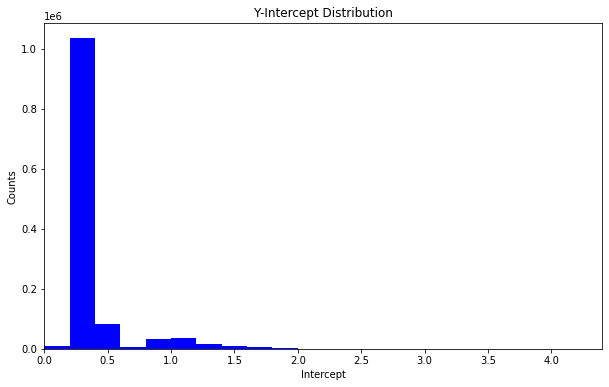

Error


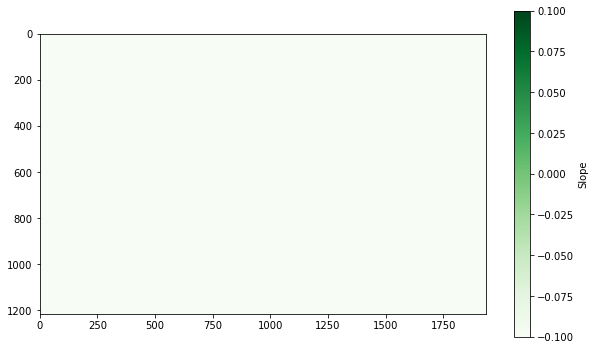

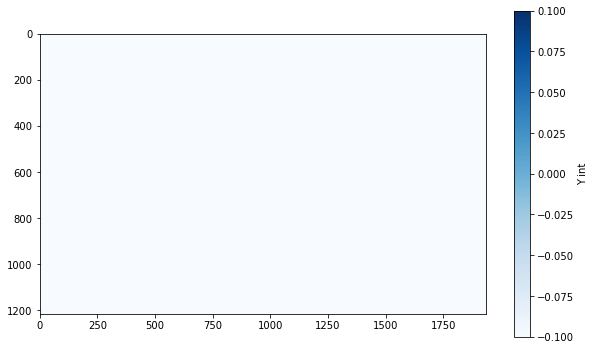

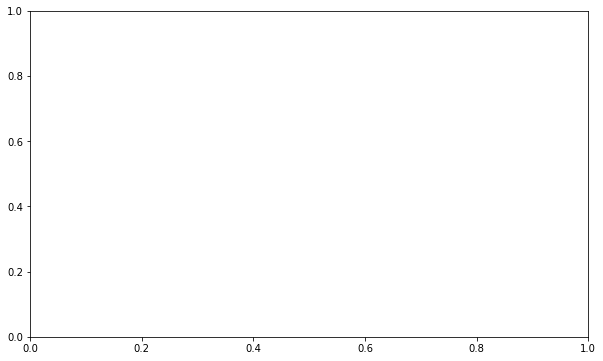

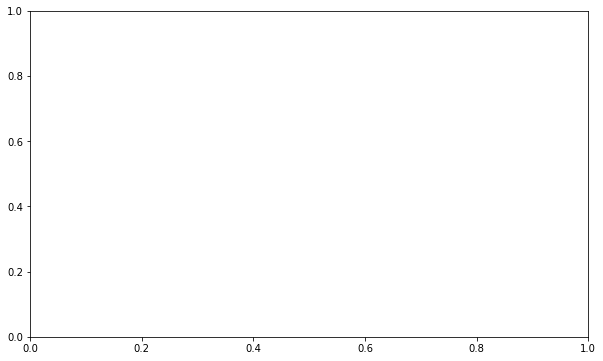

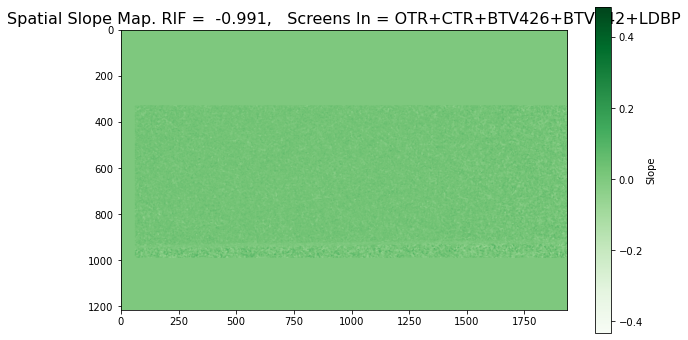

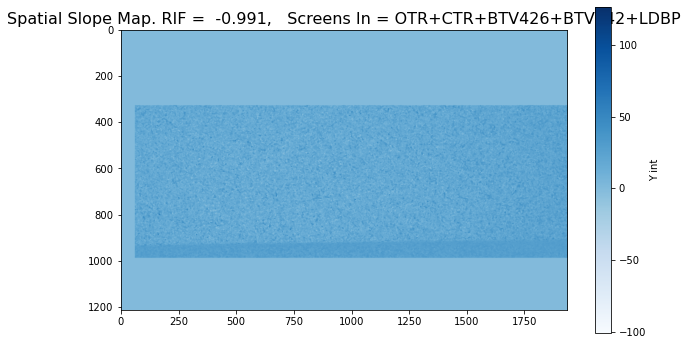

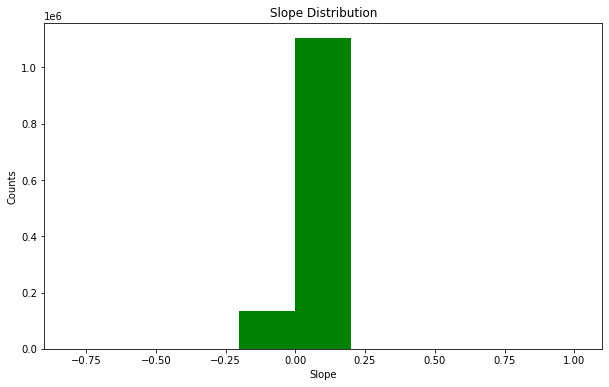

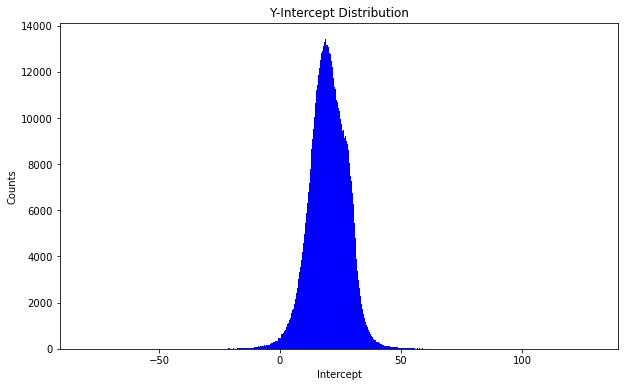

In [10]:
store_slopes_no_filtering(spectro_4_16_05)

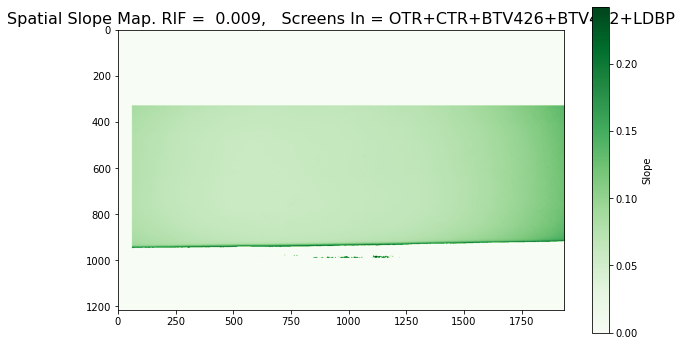

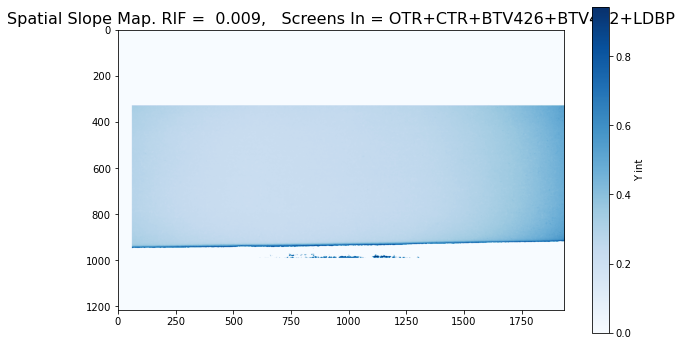

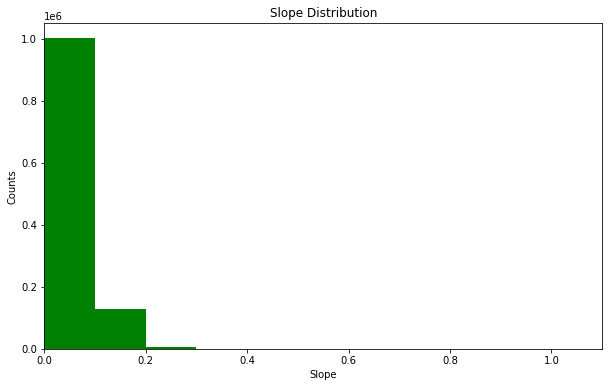

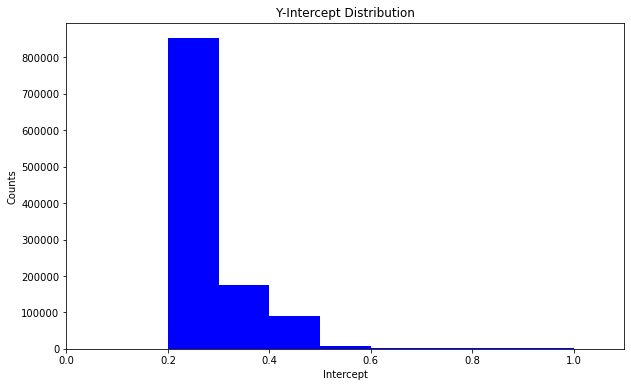

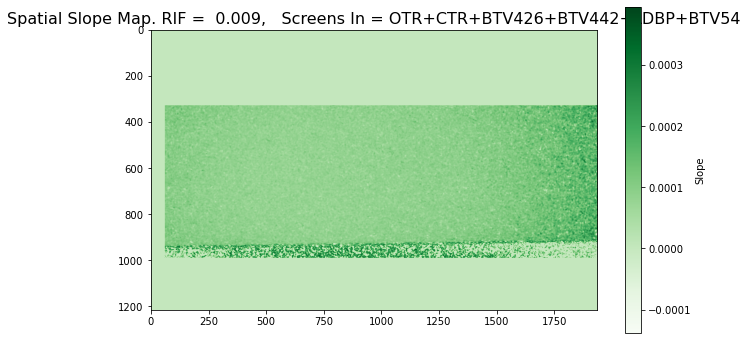

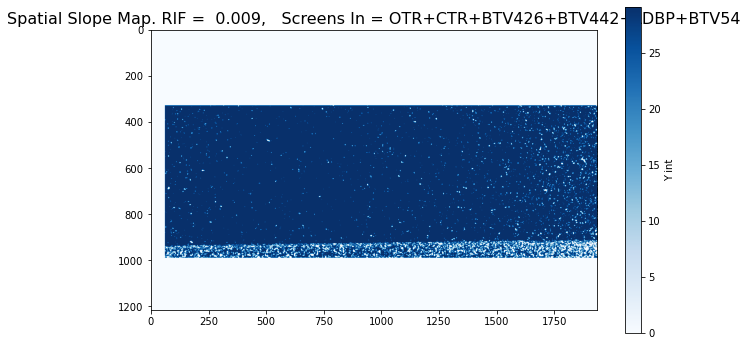

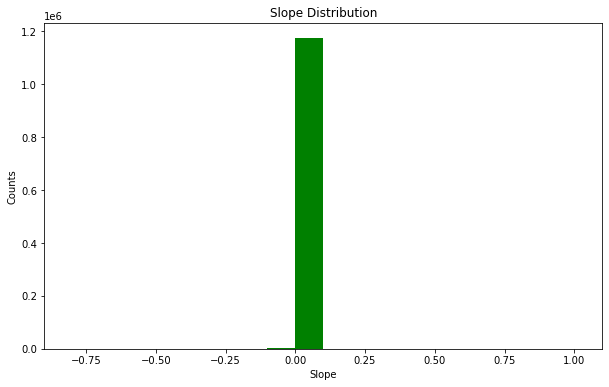

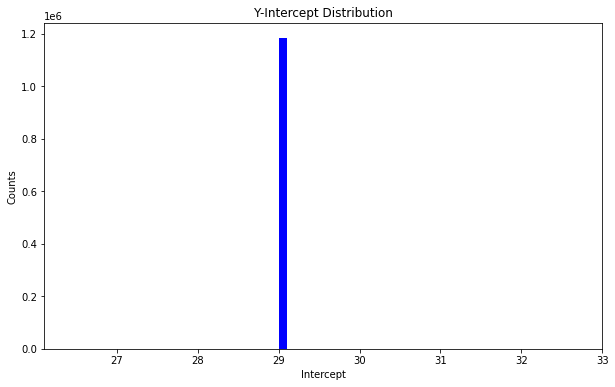

/tmp/ipykernel_491/1964412611.py:30: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


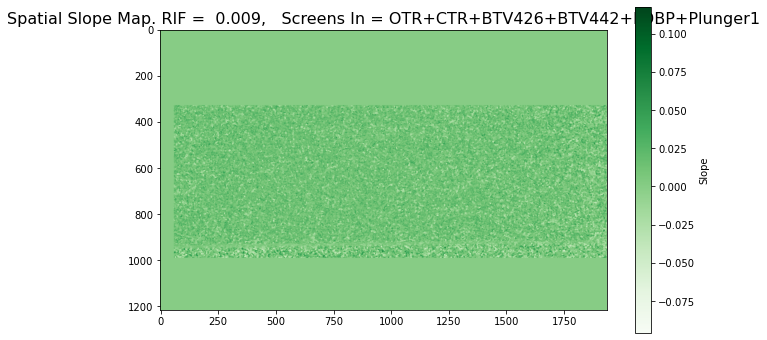

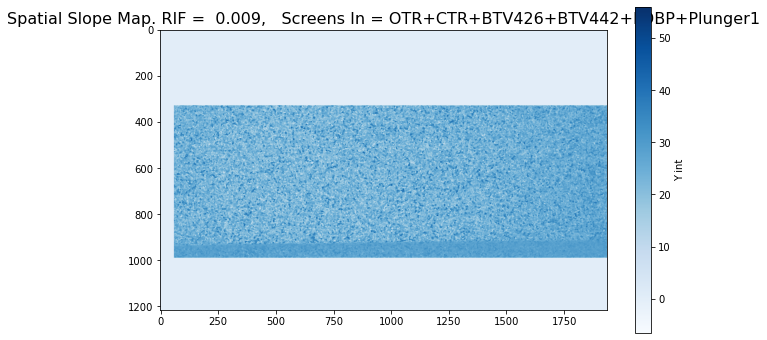

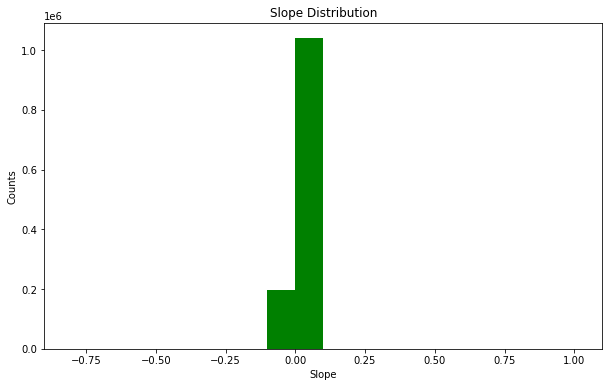

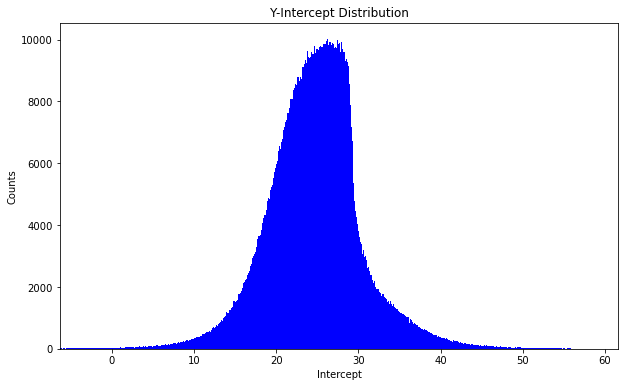

/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:1

Error


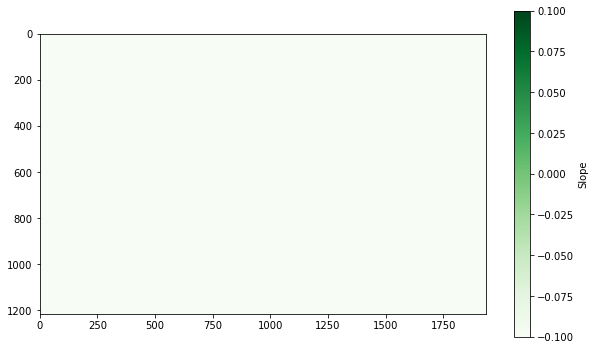

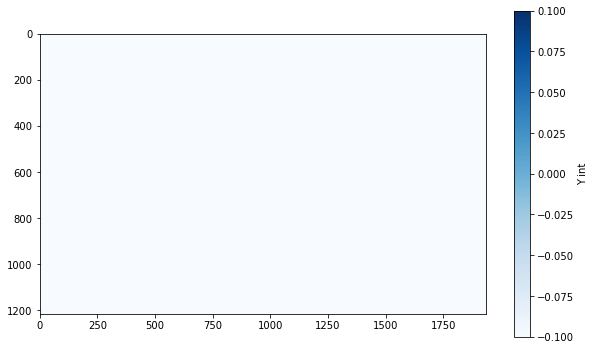

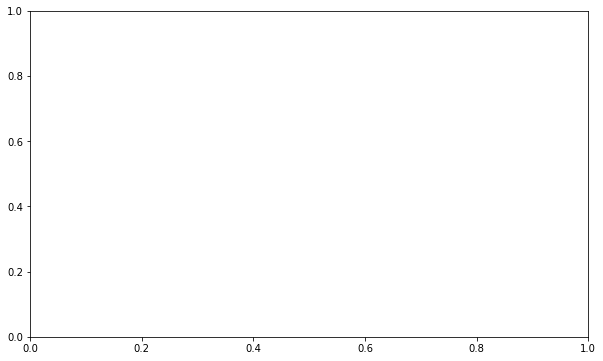

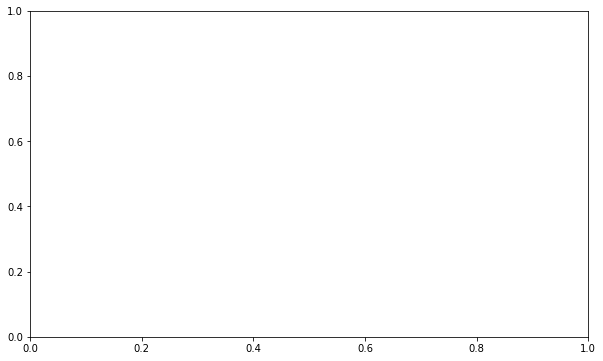

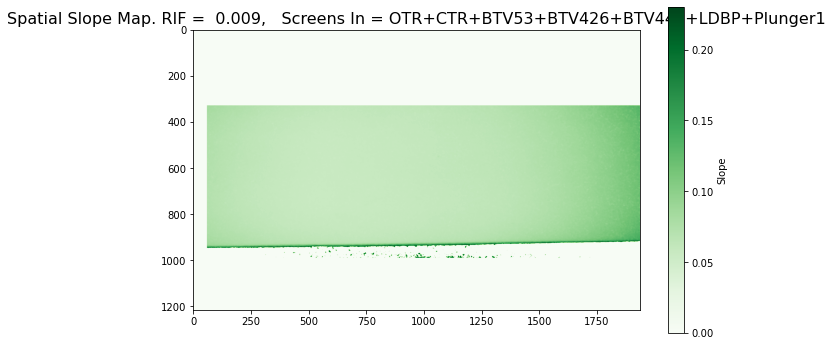

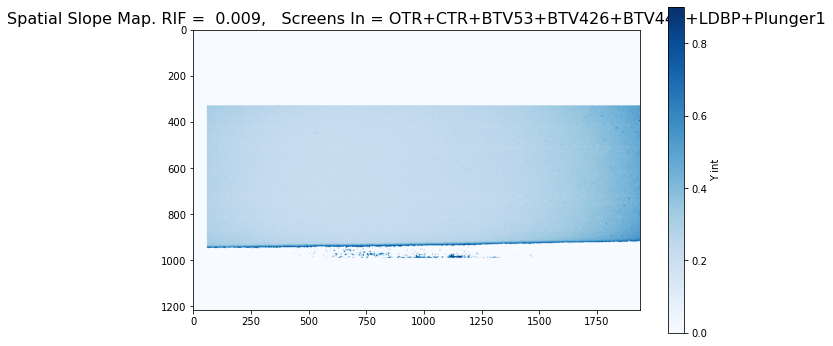

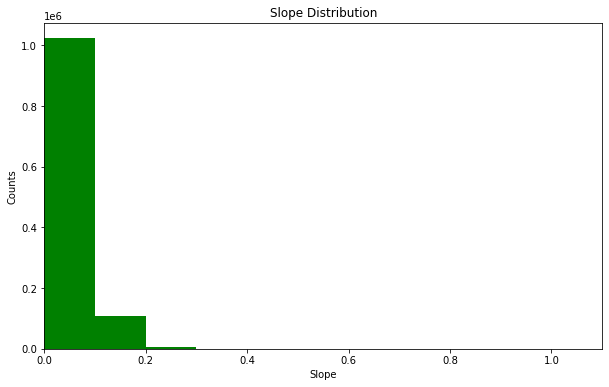

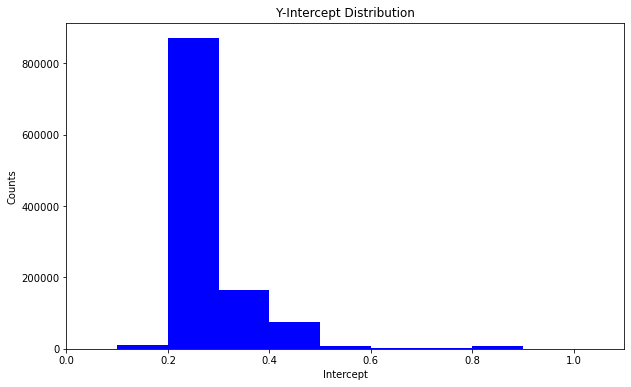

Error


In [ ]:
store_slopes_std_filtering(spectro_4_16_05)

# Laser Firing

In [13]:
Date = '2025/05/17'
DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
event_files = os.listdir(DATA_PATH)
filename = event_files[200]

In [11]:
f = h5py.File('/eos/experiment/awake/event_data/'+Date+'/'+ filename, 'r')

In [8]:
f['AwakeEventData']['EMETER04']['Acq']['value'][0]

0.09801775

In [14]:
counter = 0
laser_values2 = []
## laser firing for values > 0.05

for i in np.arange(0,len(event_files),1):
    
    f = h5py.File('/eos/experiment/awake/event_data/'+Date+'/'+ event_files[i], 'r')
    try:
        
        laser_value = f['AwakeEventData']['EMETER04']['Acq']['value'][0]
        
        if laser_value < 10:
            laser_values2.append(laser_value)
        
    except:
        print('error')
        
#print(counter)

In [ ]:
#rint((laser_values))

Text(0.5, 1.0, 'Laser Charge Distribution')

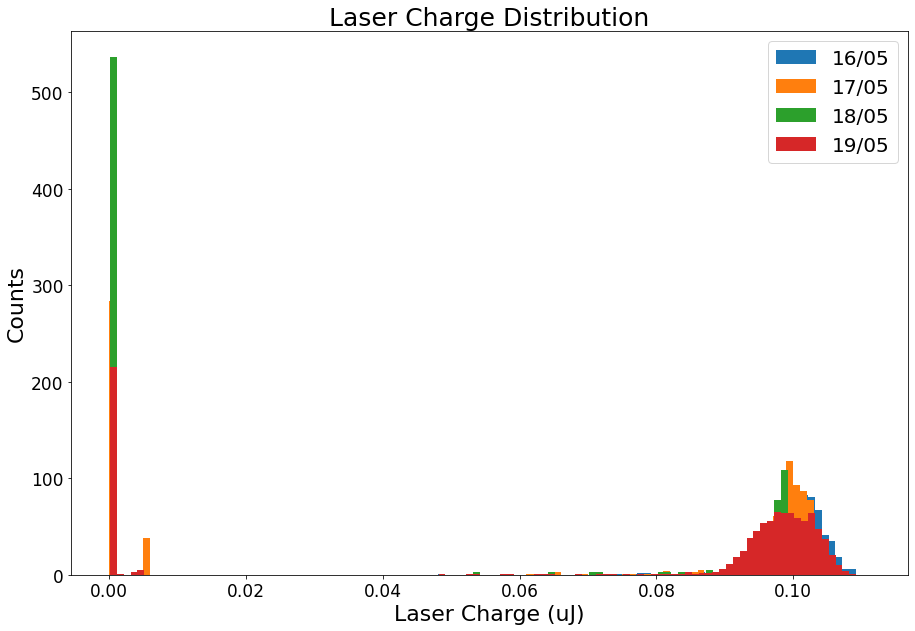

In [16]:
plt.figure(figsize=(15,10))
bin_width= 0.001
bins1 = np.arange(np.min(laser_values), np.max(laser_values) + bin_width, bin_width)
bins2 = np.arange(np.min(laser_values2), np.max(laser_values2) + bin_width, bin_width)
bins3 = np.arange(np.min(laser_values3), np.max(laser_values3) + bin_width, bin_width)
bins4 = np.arange(np.min(laser_values4), np.max(laser_values4) + bin_width, bin_width)


plt.hist(laser_values,density=True,bins=bins1,label='16/05')
plt.hist(laser_values2,density=True,bins=bins2,label='17/05')
plt.hist(laser_values3,density=True,bins=bins3,label='18/05')
plt.hist(laser_values4,density=True,bins=bins4,label='19/05')


plt.xlabel('Laser Charge (uJ)',fontsize=22)
plt.ylabel('Counts',fontsize=22)

plt.xticks(fontsize=17)
plt.yticks(fontsize=17)

plt.legend(fontsize=20)
plt.title('Laser Charge Distribution', fontsize = 25)

In [37]:
list(f['AwakeEventData']['TCC4.SPECTRO1.DigiCam']['AcquiredParameters'])

['acqAcqTrigger',
 'acqCameraBinningHor',
 'acqCameraBinningMode',
 'acqCameraBinningVer',
 'acqCameraBlackLevel',
 'acqCameraDigitalShift',
 'acqCameraExposureAuto',
 'acqCameraExposureTimeUs',
 'acqCameraFlipHor',
 'acqCameraFlipVer',
 'acqCameraFrameEnable',
 'acqCameraFrameRate',
 'acqCameraGain',
 'acqCameraGainAuto',
 'acqCameraGamma',
 'acqCameraGammaEnable',
 'acqCameraGammaSelector',
 'acqCameraPixelFormat',
 'acqCameraTimestampTickFrequency',
 'acqCameraTimestampTickFrequency_units',
 'acqCameraTimestampTickPeriod',
 'acqCameraTimestampTickPeriod_units',
 'acqCameraTriggerDelay',
 'acqCameraTriggerDelay_units',
 'acqImageROI',
 'acqImageROIEnable']

In [16]:
## laser firing for values > 0.05

for i in np.arange(0,len(event_files),1):
    
    f = h5py.File('/eos/experiment/awake/event_data/'+Date+'/'+ event_files[i], 'r')
    
    gain = f['AwakeEventData']['TCC4.SPECTRO1.DigiCam']['AcquiredParameters']['acqCameraGainAuto'][0]
    exposure = f['AwakeEventData']['TCC4.SPECTRO1.DigiCam']['AcquiredParameters']['acqCameraExposureAuto'][0]
    exposure2 = f['AwakeEventData']['TCC4.SPECTRO1.DigiCam']['AcquiredParameters']['acqCameraExposureTimeUs'][0]

    print(gain, exposure, exposure2)

1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1

In [18]:
## laser firing for values > 0.05

for i in np.arange(0,len(event_files),1):
    
    f = h5py.File('/eos/experiment/awake/event_data/'+Date+'/'+ event_files[i], 'r')
    
    gain = f['AwakeEventData']['TCC4.SPECTRO1.DigiCam']['AcquiredParameters']['acqCameraGainAuto'][0]
    exposure = f['AwakeEventData']['TCC4.SPECTRO1.DigiCam']['AcquiredParameters']['acqCameraExposureAuto'][0]
    exposure2 = f['AwakeEventData']['TCC4.SPECTRO1.DigiCam']['AcquiredParameters']['acqCameraExposureTimeUs'][0]

    print(gain, exposure, exposure2)

1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1

1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1 1 1000
1

# Filter before fitting

In [10]:
def std_filtering_before_fit(rif_data):
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_laser_values = list(rif_data[rif])
        
        for laser in list_laser_values:
            list_screen_combos = list(rif_data[rif][laser])
        
            for screen_label in list_screen_combos:
                fig, ax = plt.subplots(figsize=(10, 6))
                fig2, ax2 = plt.subplots(figsize=(10, 6))
                fig3, ax3 = plt.subplots(figsize=(10, 6))
                fig4, ax4 = plt.subplots(figsize=(10, 6))

                data = rif_data[rif][laser][screen_label]
                index_count = list(data)

                list_slopes = []
                list_int = []
                slope_heat_map = np.zeros((1216, 1936))
                intercept_heat_map = np.zeros((1216, 1936))

                for i in index_count:

                    x = np.array(data[i]['fit_parameters'])
                    y = np.array(data[i]['proton_count'])      

                    mean_x = np.mean(x)
                    mean_y = np.mean(y)

                    std_x = np.std(x)
                    std_y = np.std(y)

                    mask = (np.abs(x - mean_x) <= 2 * std_x) & (np.abs(y - mean_y) <= 2 * std_y)

                    # Filter out outliers > 2 std deviations
                    filtered_x = x[mask]
                    filtered_y = y[mask]

                    if len(filtered_x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                        params = curve_fit(fit_line, filtered_y, filtered_x,p0=[1,0])[0]
                        a, b = params
                        list_slopes.append(a)
                        list_int.append(b)

                        slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                        intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b


                im = ax.imshow(slope_heat_map,cmap='Greens',origin='upper')
                ax.imshow(slope_heat_map,cmap='Greens')
                fig.colorbar(im, ax=ax, label ='Slope')

                im2 = ax2.imshow(intercept_heat_map,cmap='Blues',origin='upper')
                ax2.imshow(intercept_heat_map,cmap='Blues')
                fig2.colorbar(im2, ax=ax2, label ='Y int')


                bin_width = 0.1

                # Histogram for slopes
                min_slope = np.floor(min(list_slopes))
                max_slope = np.ceil(max(list_slopes))
                bins = np.arange(min_slope, max_slope + bin_width, bin_width)
                ax3.hist(list_slopes, color='green')
                ax3.set_title('Slope Distribution')
                ax3.set_xlabel('Slope')
                ax3.set_ylabel('Counts')
                ax3.set_xlim([min_slope*0.9, max_slope*1.1])

                # Histogram for intercepts
                min_int = np.floor(min(list_int))
                max_int = np.ceil(max(list_int))
                bins2 = np.arange(min_int, max_int + bin_width, bin_width)
                ax4.hist(list_int, bins=bins2, color='blue')
                ax4.set_title('Y-Intercept Distribution')
                ax4.set_xlabel('Intercept')
                ax4.set_ylabel('Counts')
                ax4.set_xlim([min_int*0.9, max_int*1.1])

                ax.set_title(f'Slope Map. RIF =  {round(rif - 1132482.599, 4)}, Screens In = {screen_label}, Laser = {laser}', fontsize=16)
                ax2.set_title(f' Y Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label} Laser = {laser}', fontsize=16)
                plt.show()

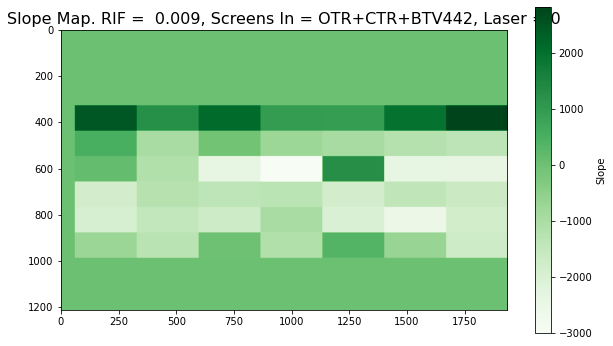

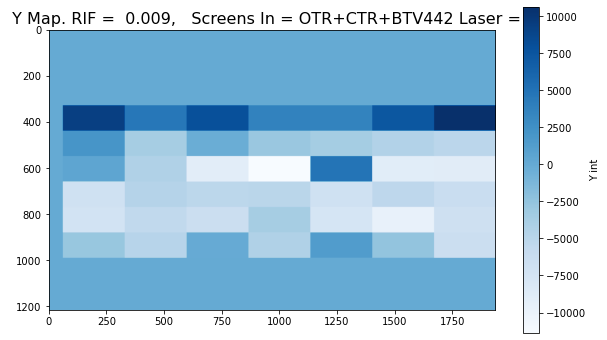

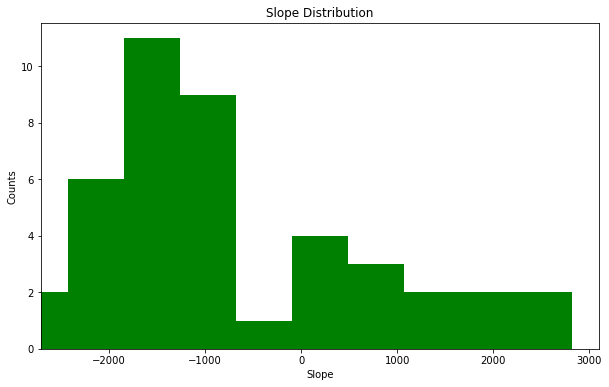

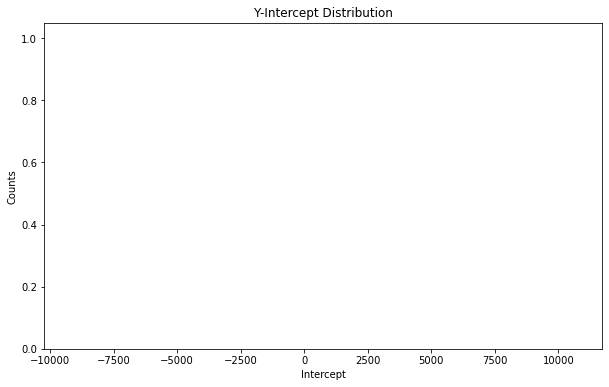

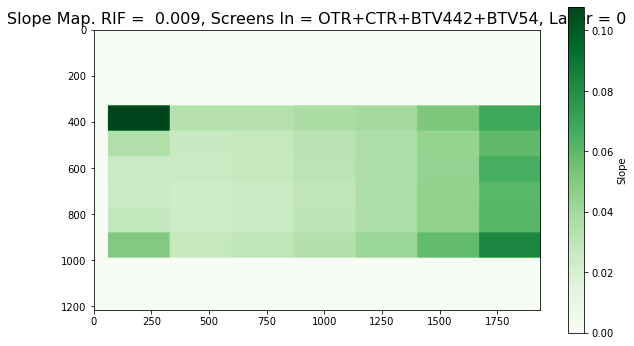

...

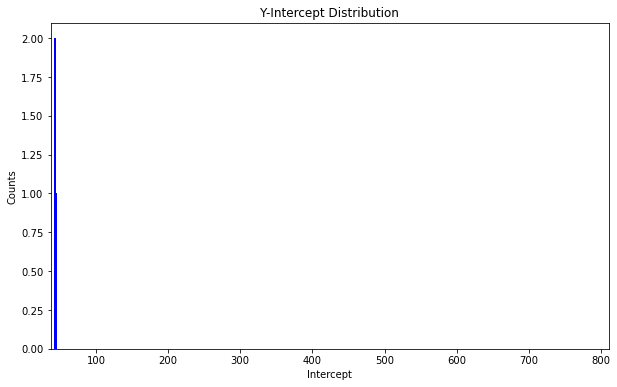

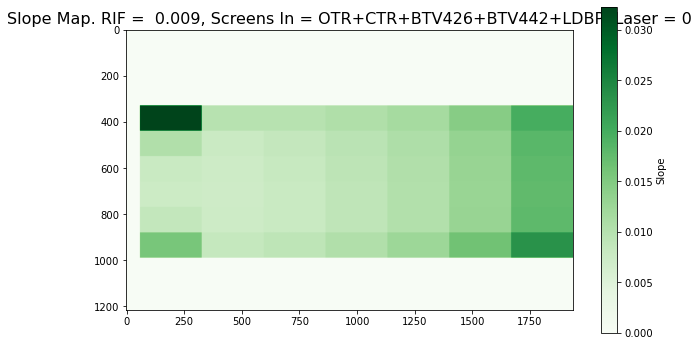

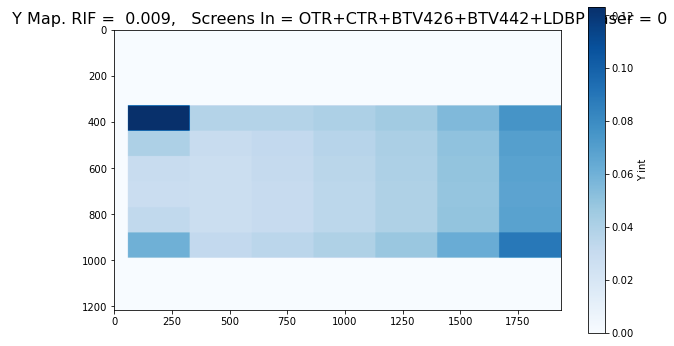

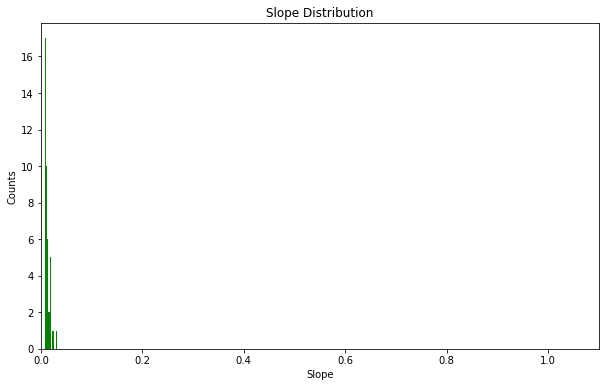

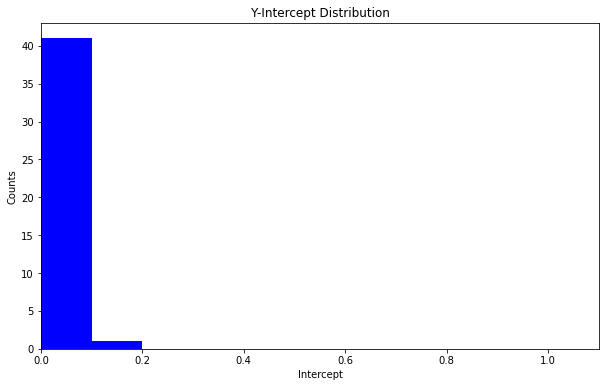

Error


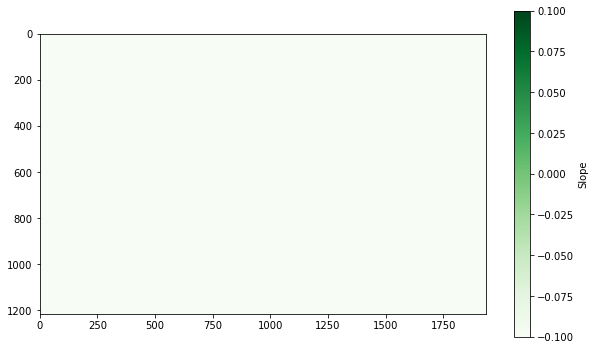

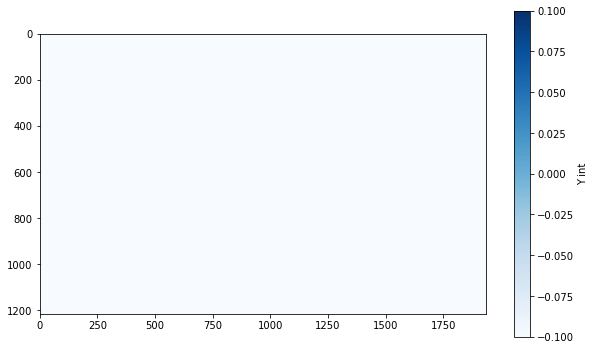

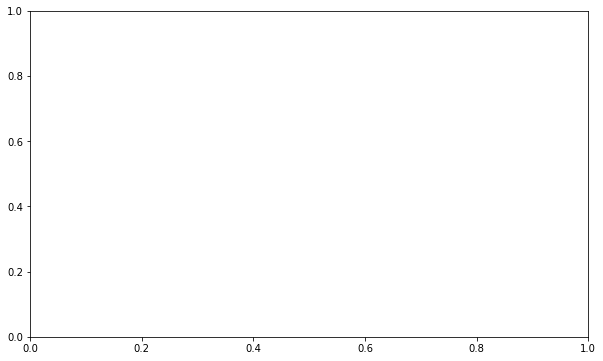

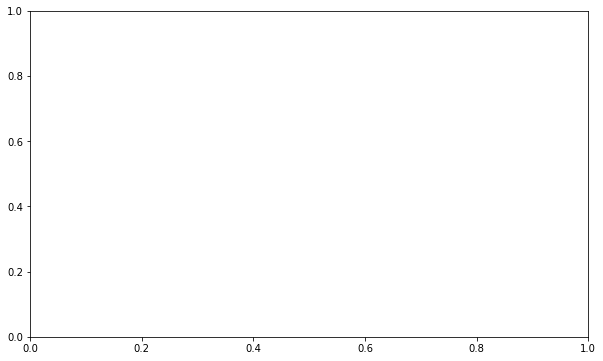

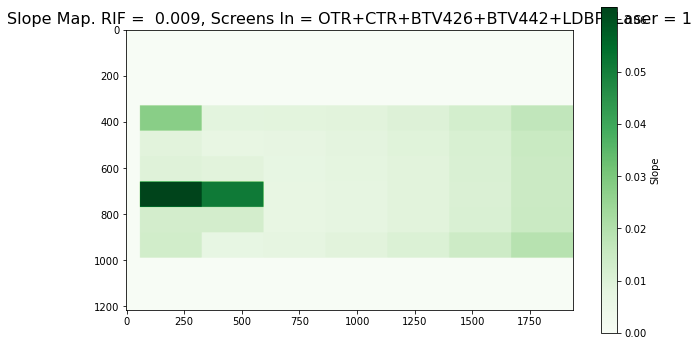

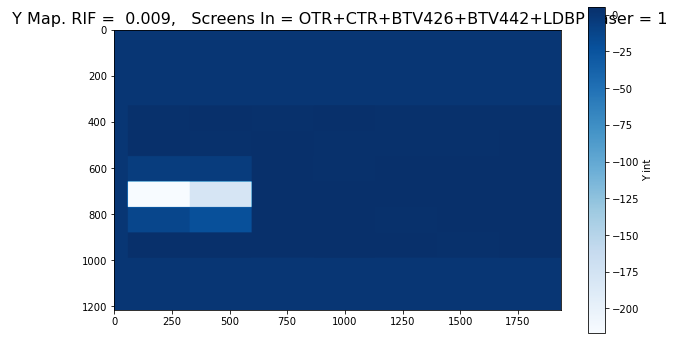

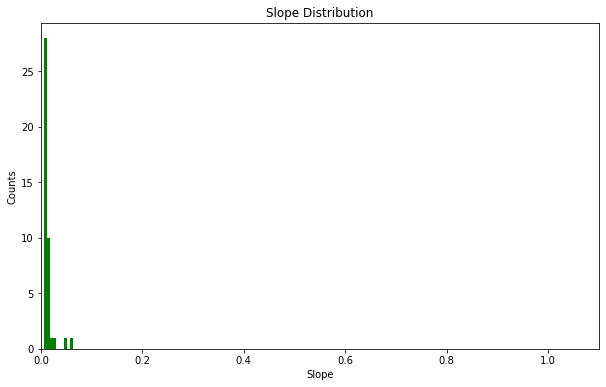

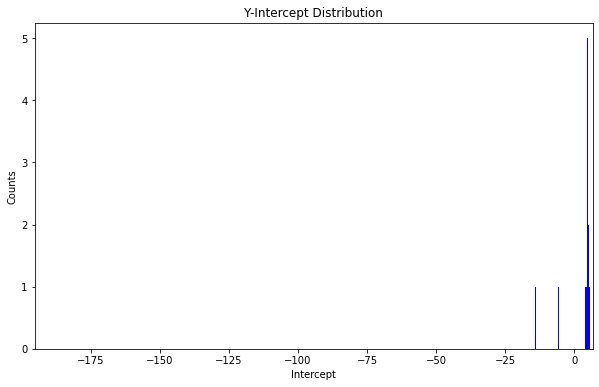

Error


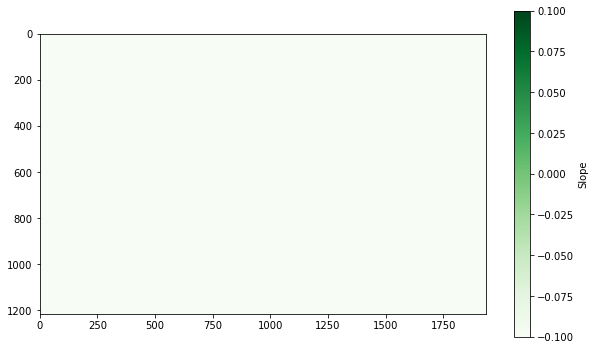

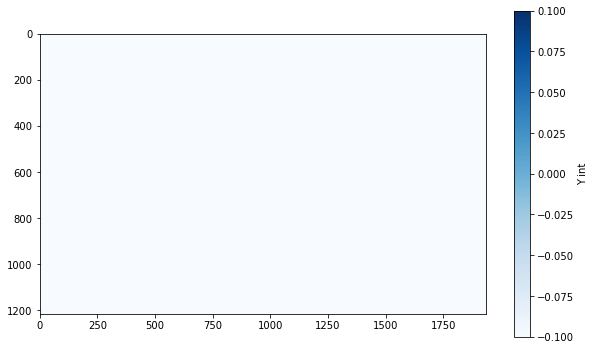

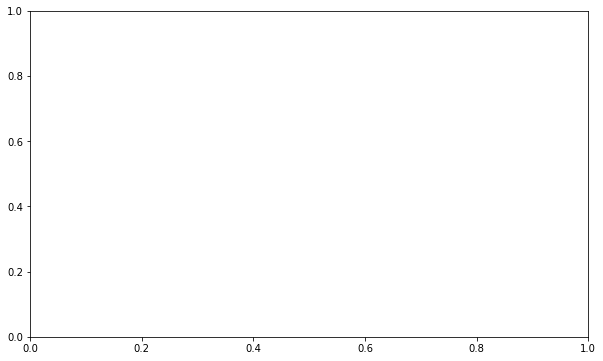

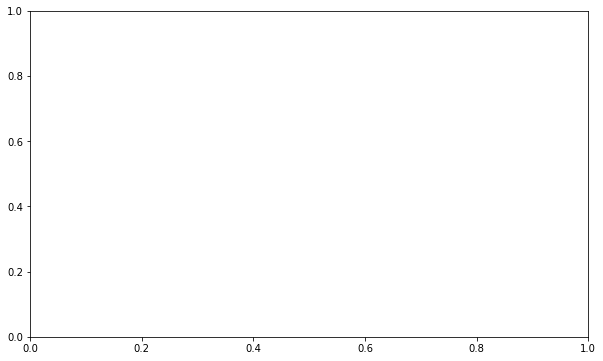

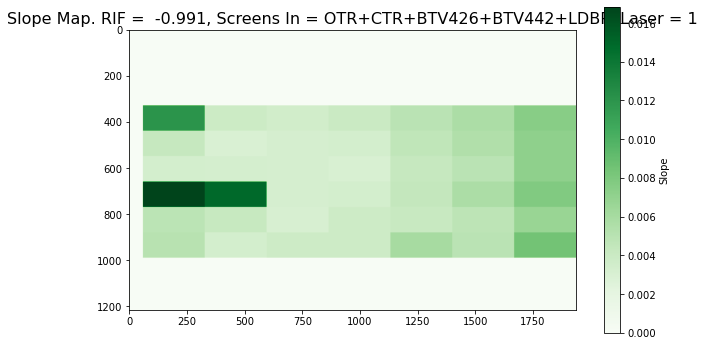

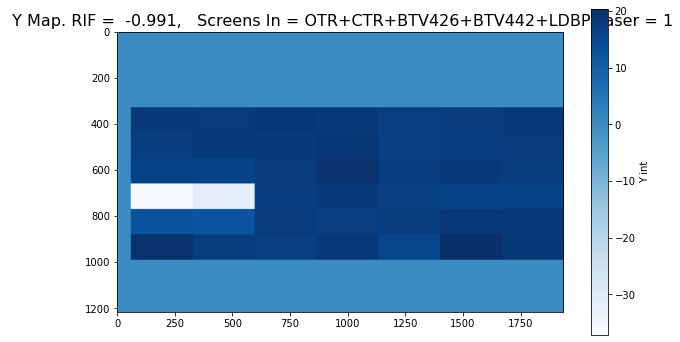

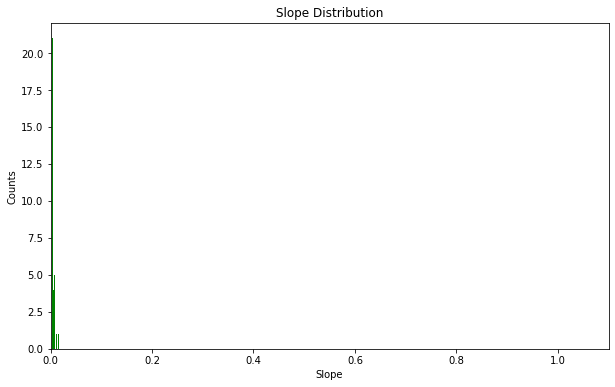

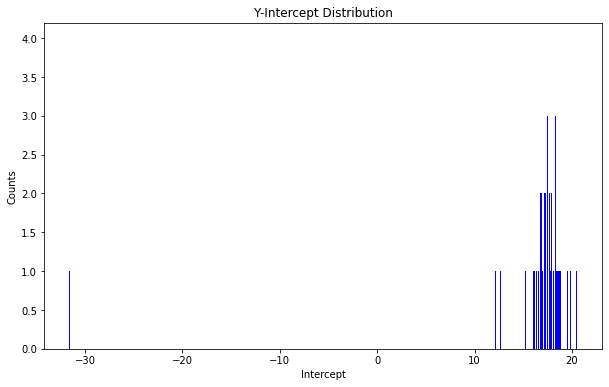

In [46]:
std_filtering_before_fit(spectro_1_17_05)

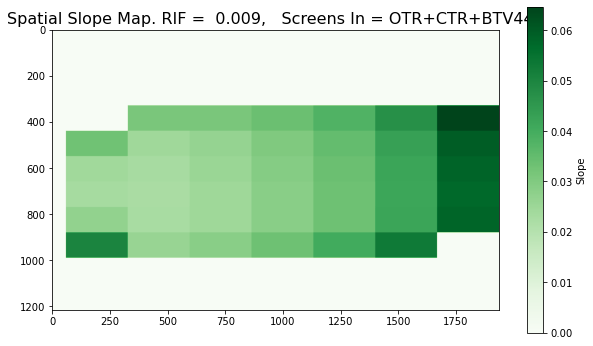

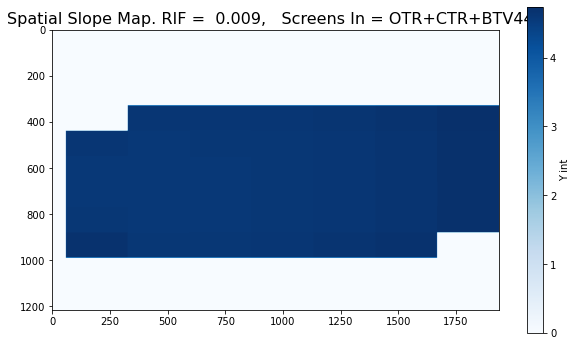

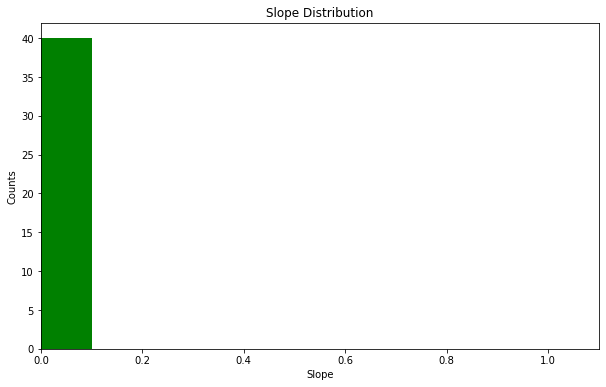

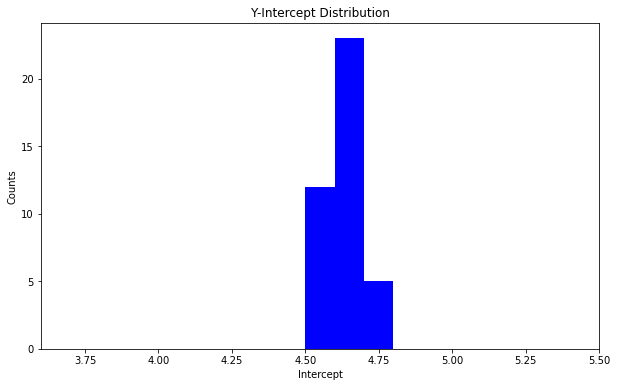

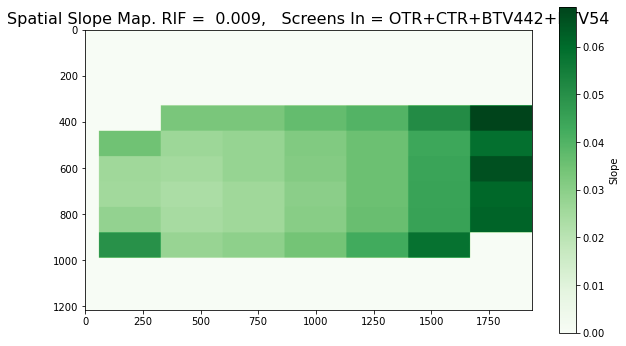

...

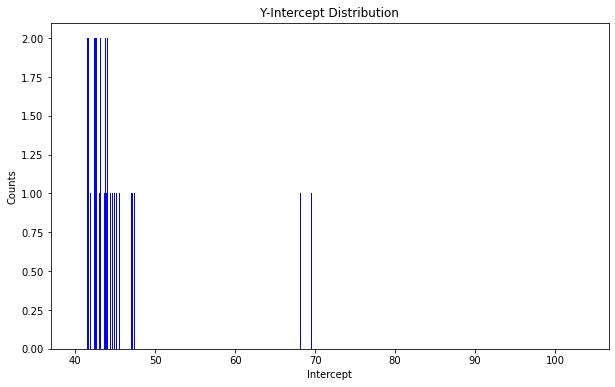

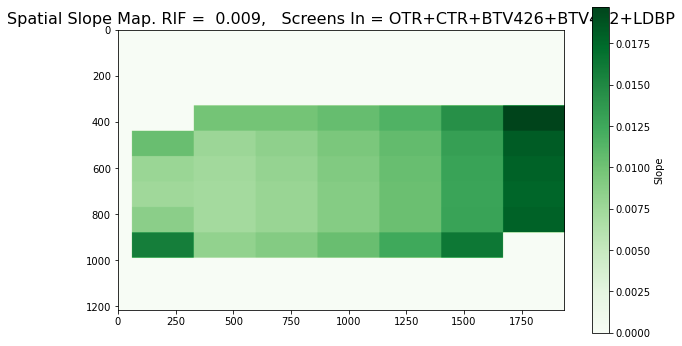

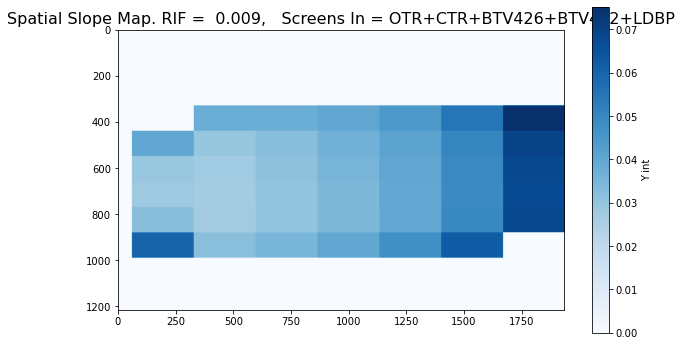

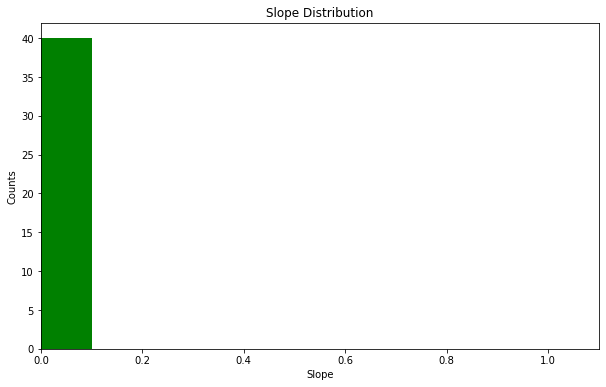

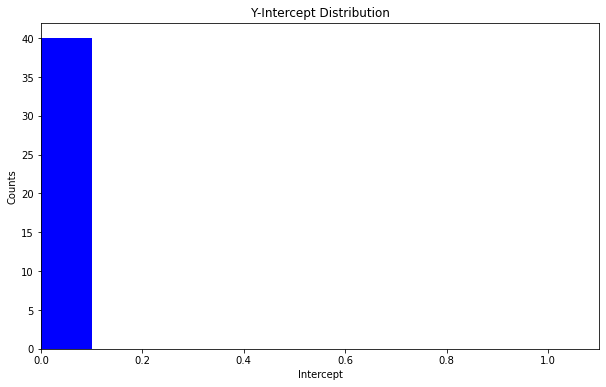

/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:1

Error


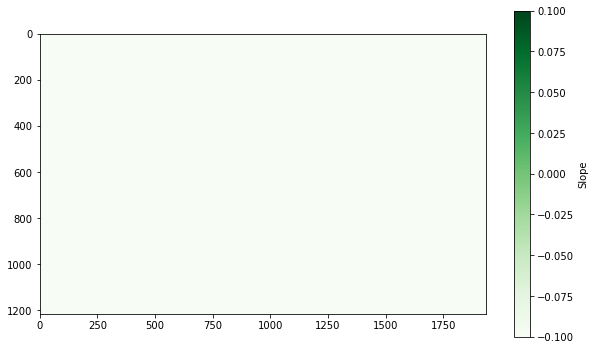

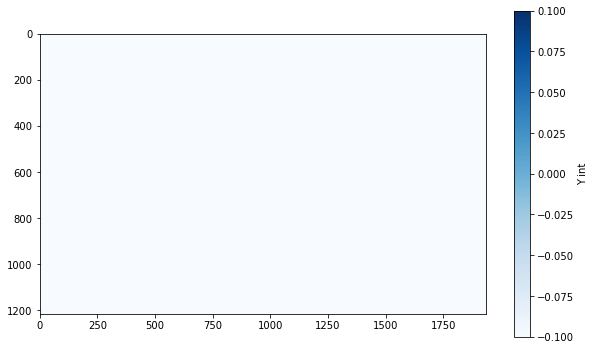

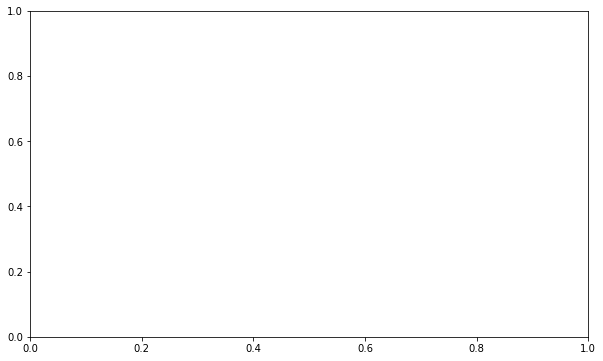

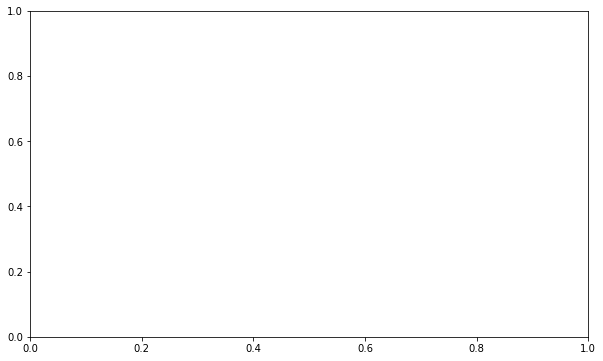

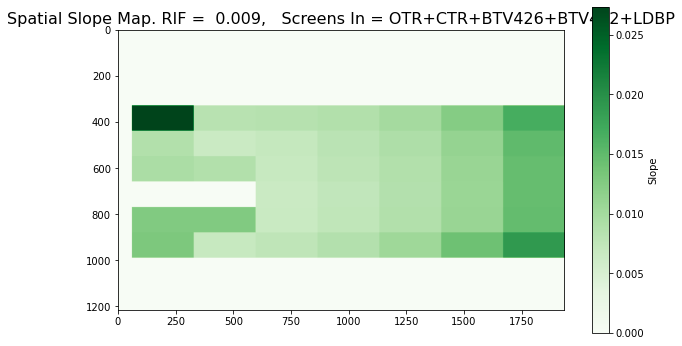

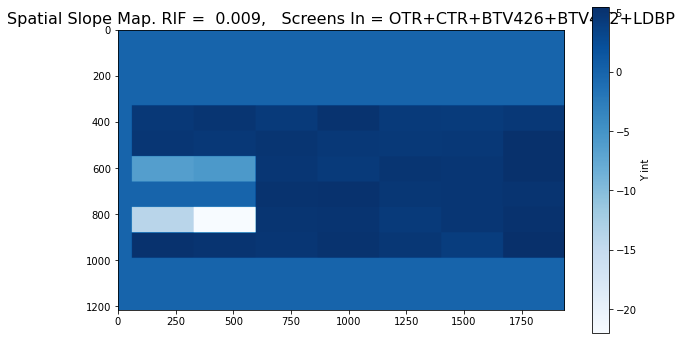

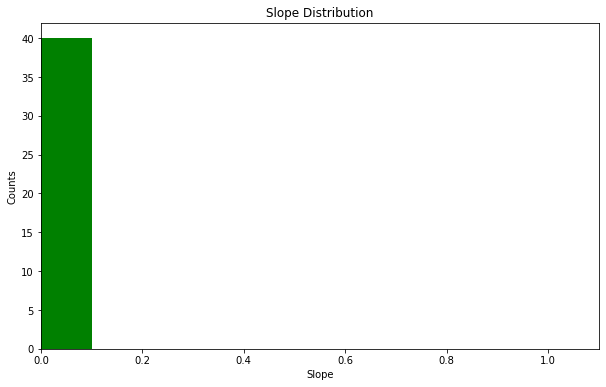

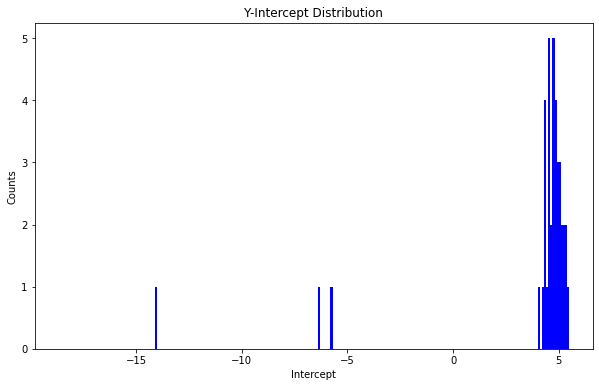

Error


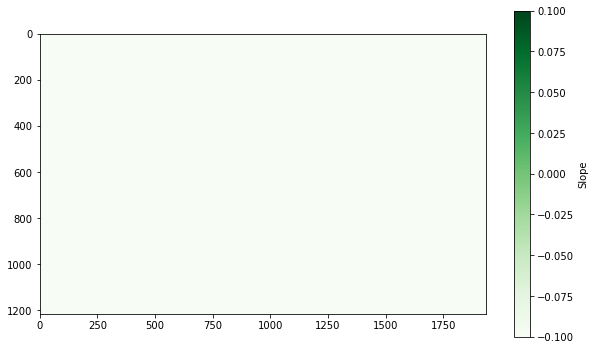

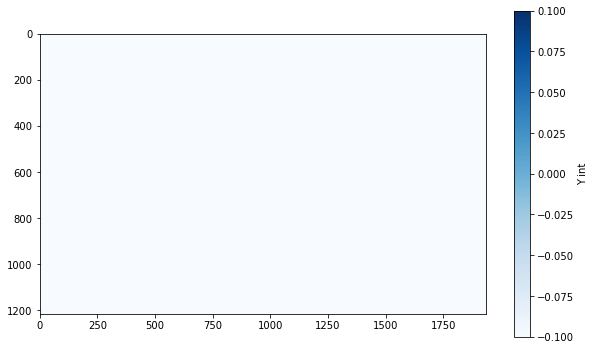

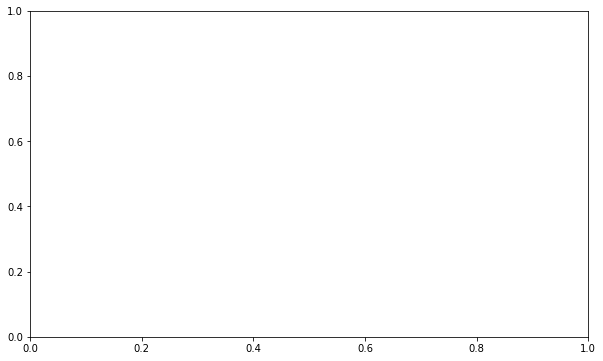

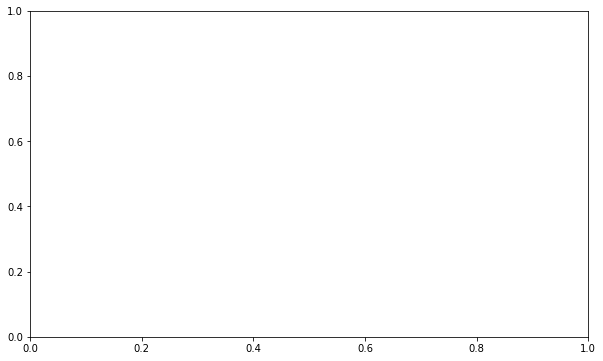

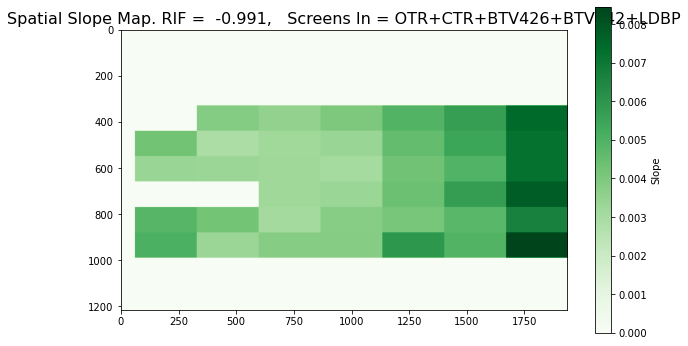

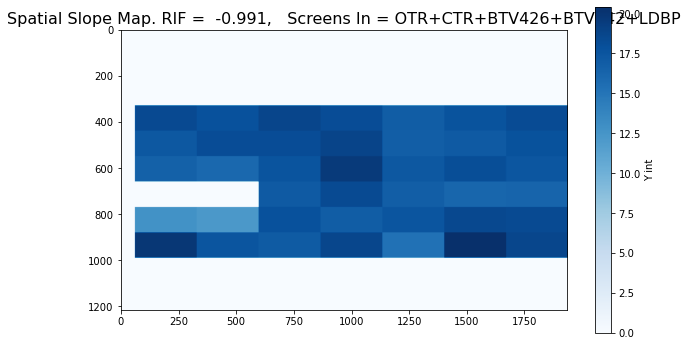

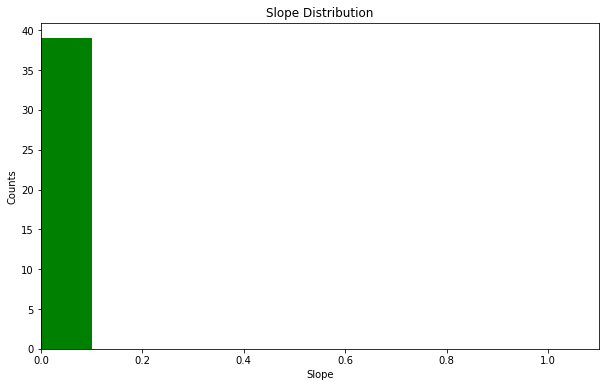

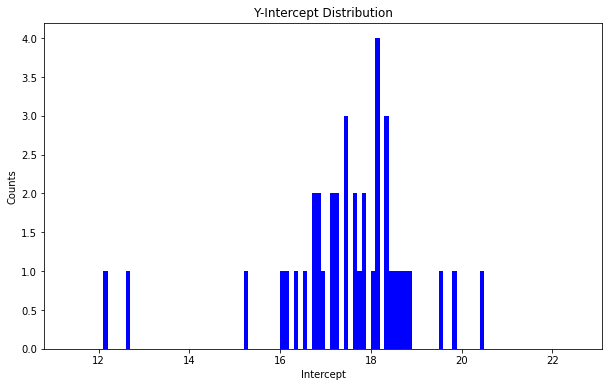

In [51]:
store_slopes_std_filtering(spectro_1_17_05)

In [10]:
spectro_1_17_05_= sort_by_space_scin_screen(220,469,100,'2025/05/17',1)

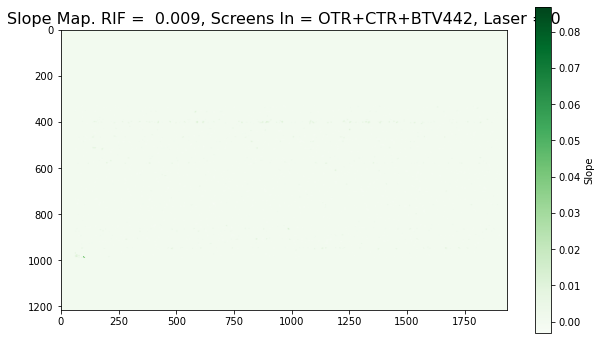

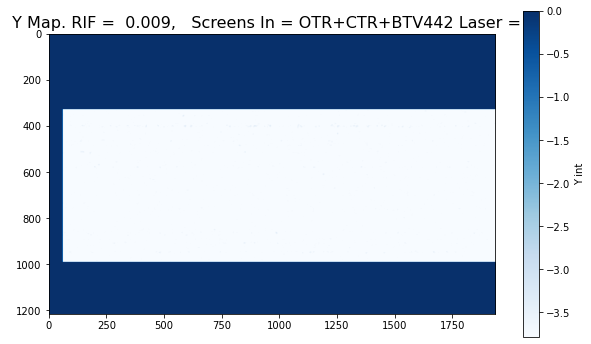

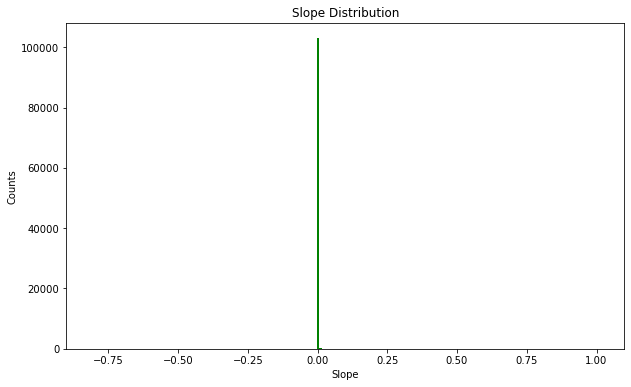

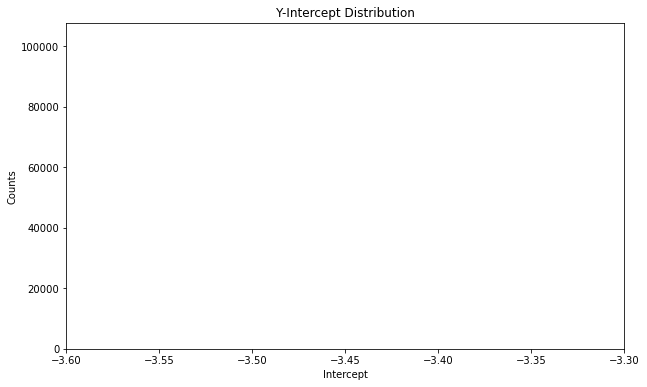

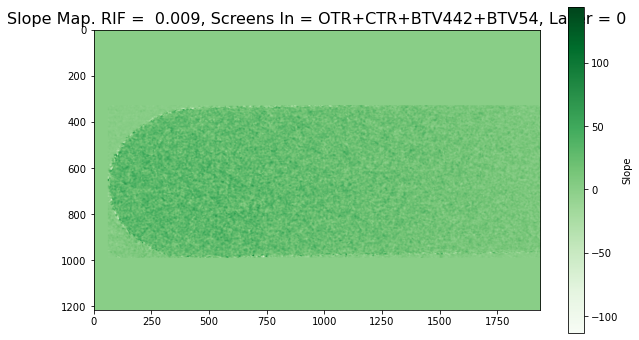

...

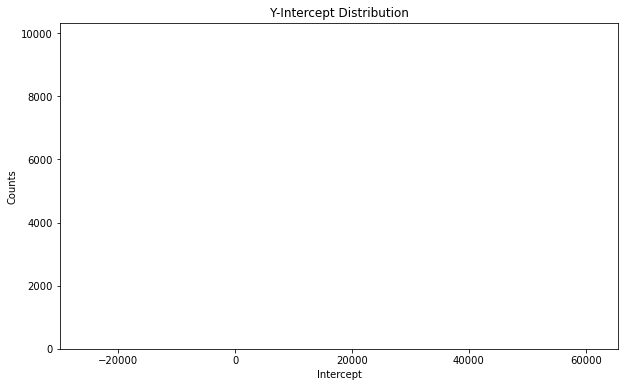

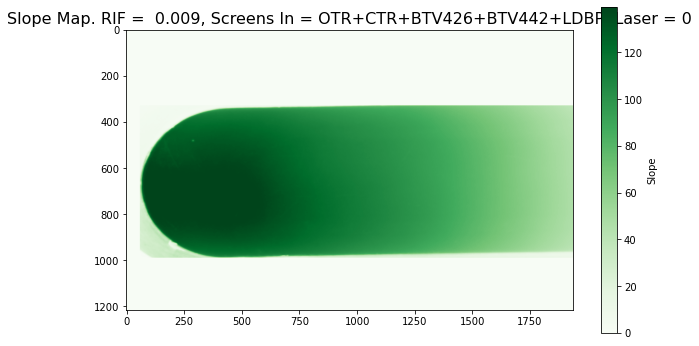

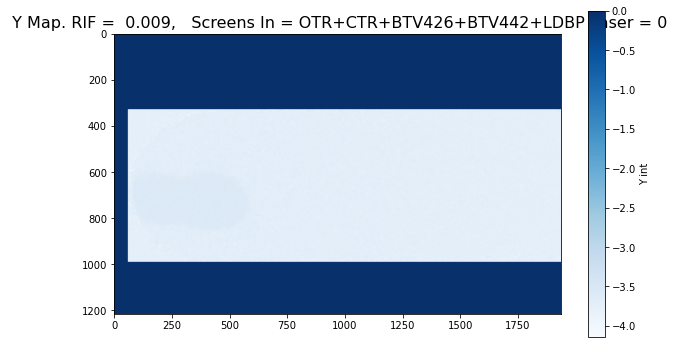

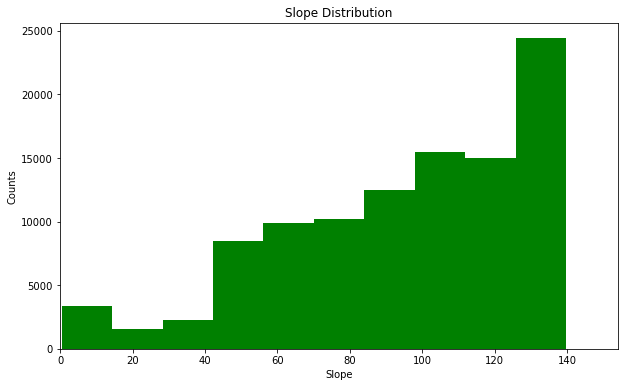

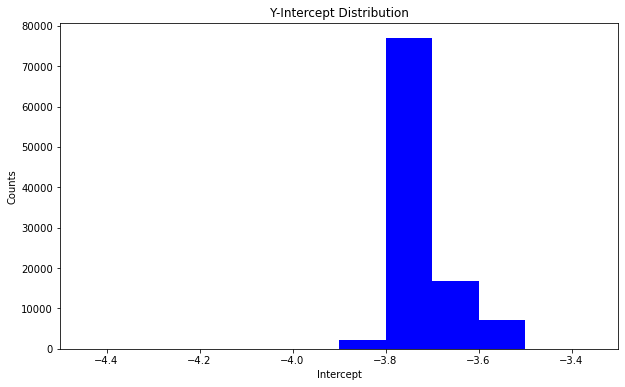

Error


/tmp/ipykernel_458/2107211891.py:44: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, filtered_y, filtered_x)[0]


Error
Error
Error


Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x7fdf12c51390>>
Traceback (most recent call last):
  File "/usr/local/lib/swan/extensions/ipykernel/ipkernel.py", line 775, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(

KeyboardInterrupt: 


Error in callback <function flush_figures at 0x7fde15d309a0> (for post_execute):


KeyboardInterrupt: 

In [12]:
std_filtering_before_fit(spectro_1_17_05_)

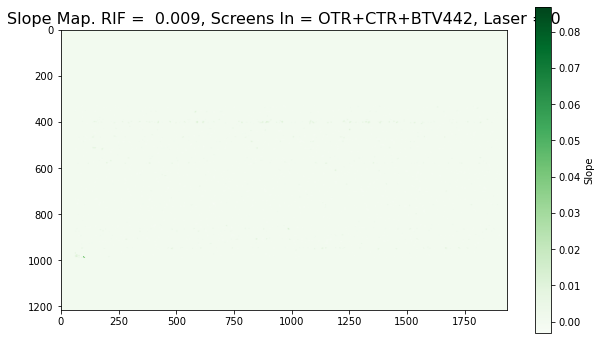

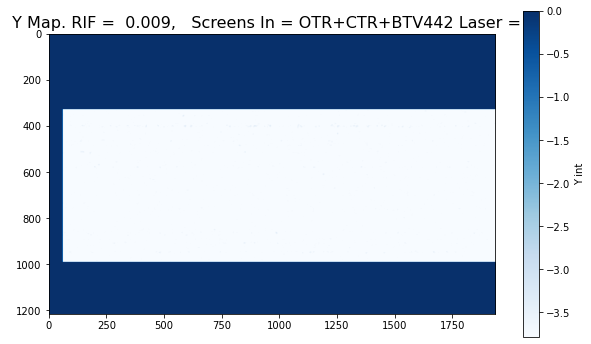

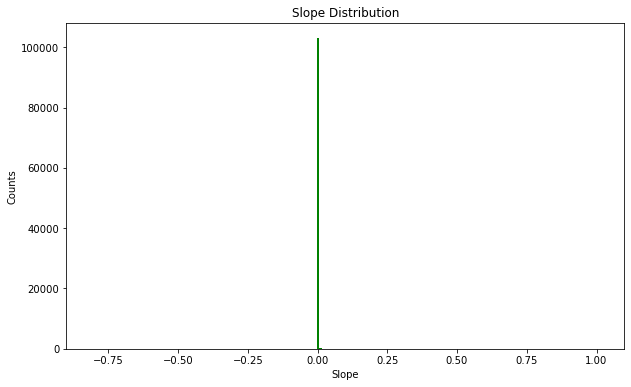

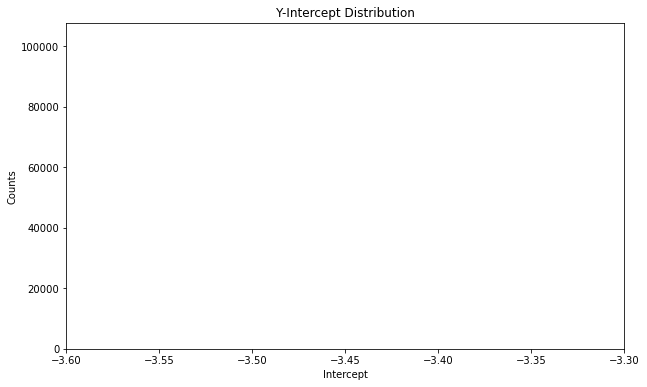

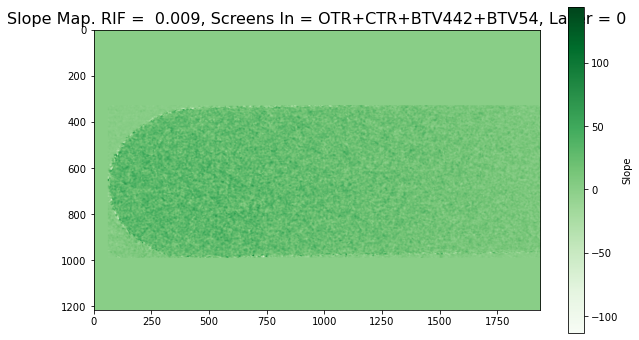

...

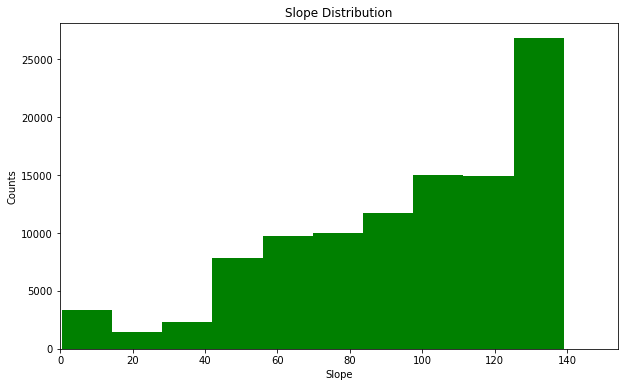

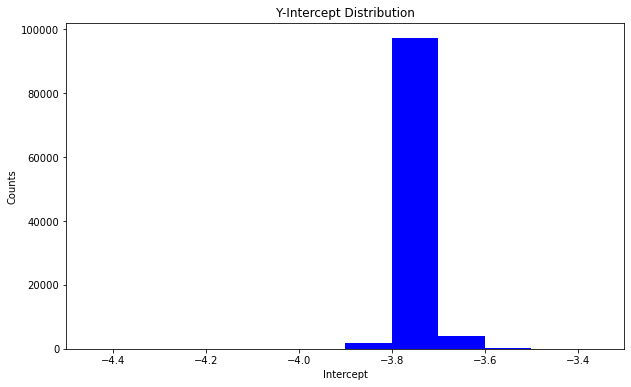

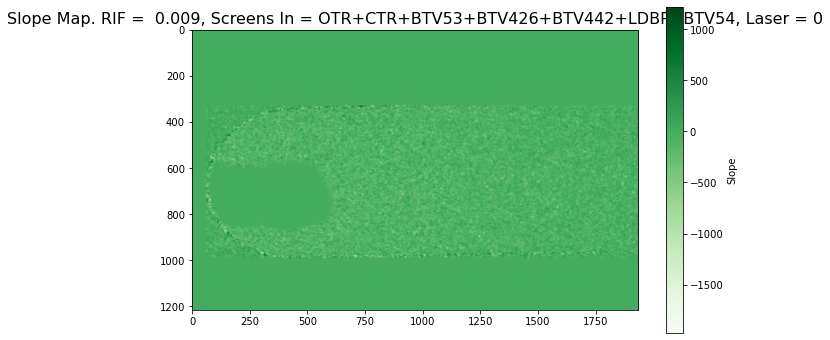

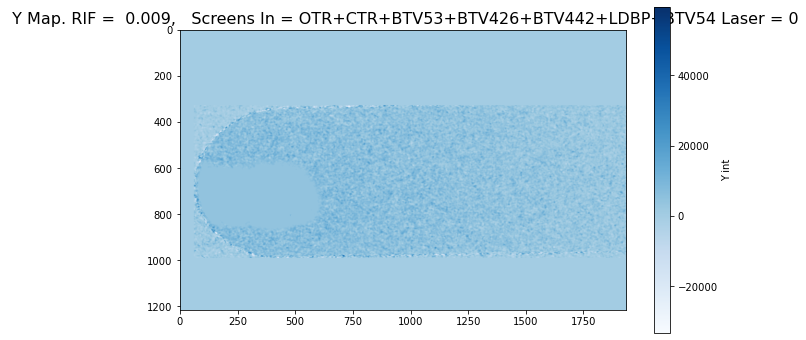

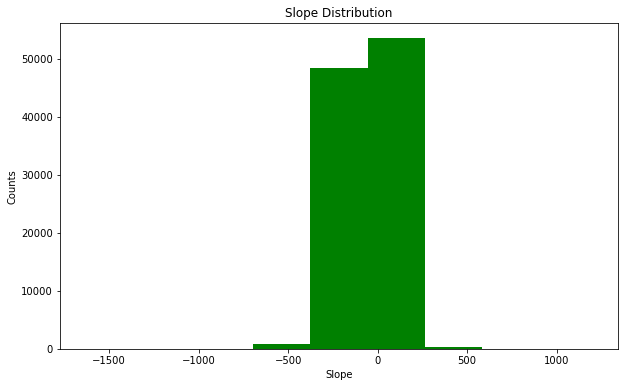

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/IPython/core/interactiveshell.py", line 3441, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "/tmp/ipykernel_458/1290169300.py", line 1, in <module>
    std_filtering_before_fit(spectro_1_17_05_)
  File "/tmp/ipykernel_458/1525358209.py", line 84, in std_filtering_before_fit
    plt.show()
  File "/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/matplotlib/pyplot.py", line 527, in show
    return _get_backend_mod().show(*args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/matplotlib_inline/backend_inline.py", line 41, in show
    display(
  File "/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/IPython/core/display.py", line 320,

TypeError: object of type 'NoneType' has no len()

In [14]:
std_filtering_before_fit(spectro_1_17_05_)

/tmp/ipykernel_458/4221633037.py:42: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, filtered_y, filtered_x,p0=[1,0])[0]


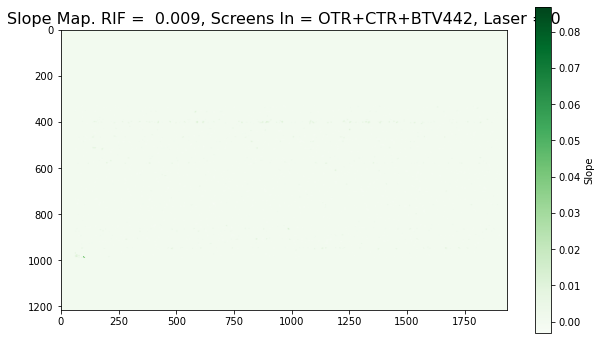

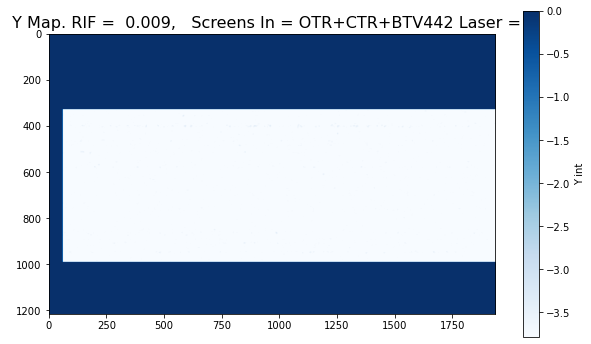

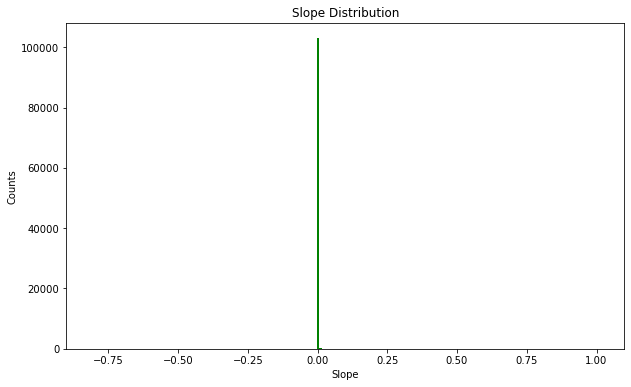

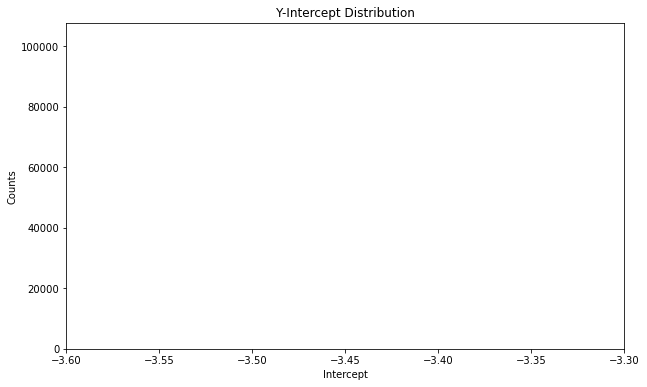

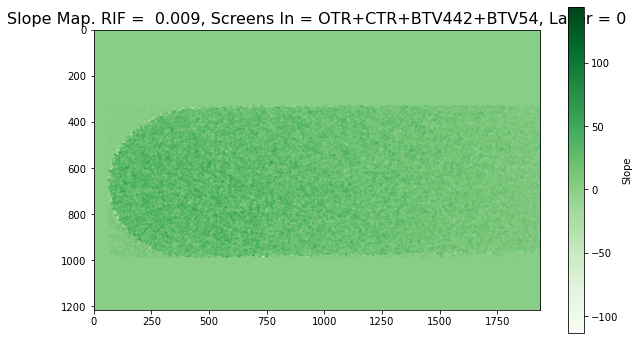

...

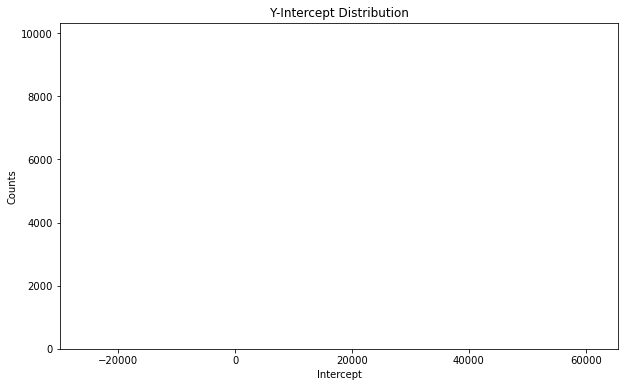

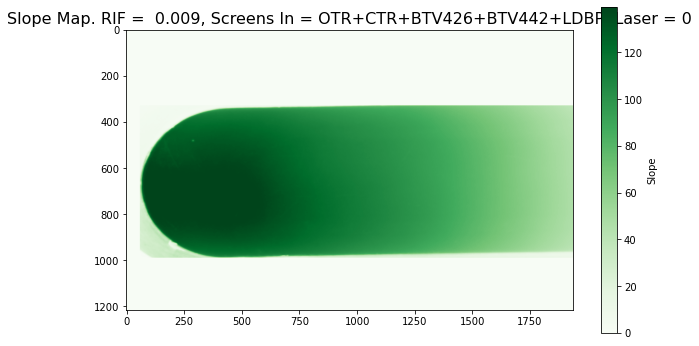

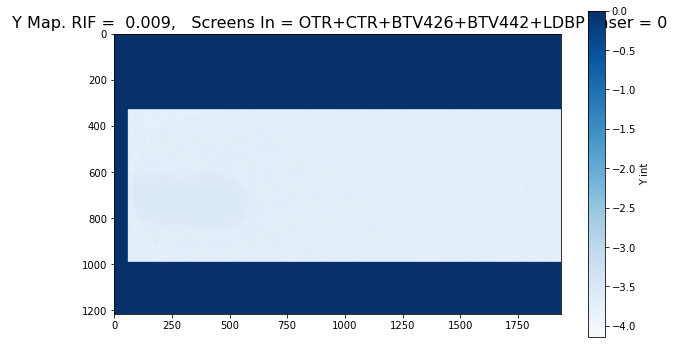

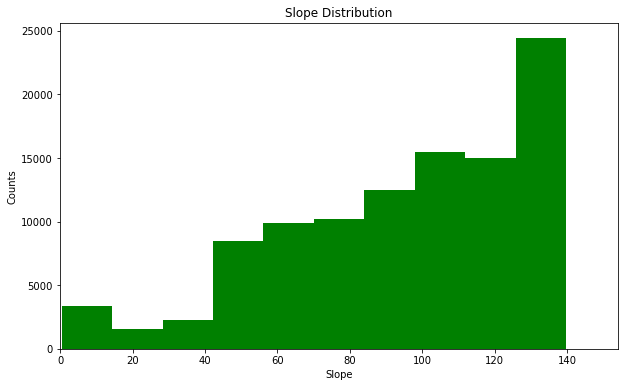

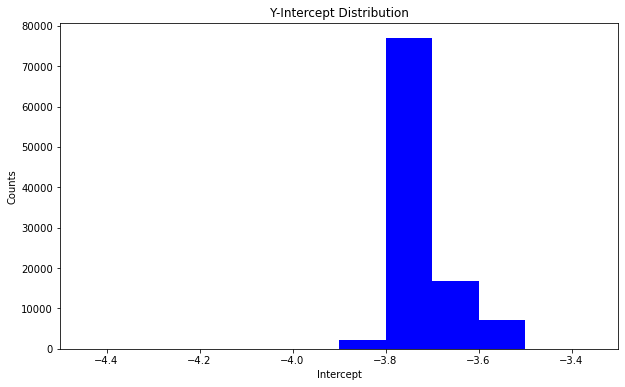

ValueError: min() arg is an empty sequence

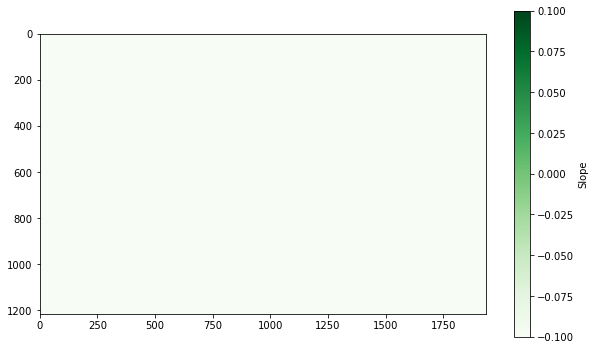

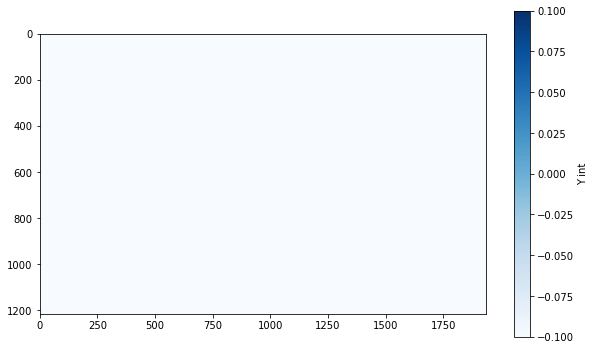

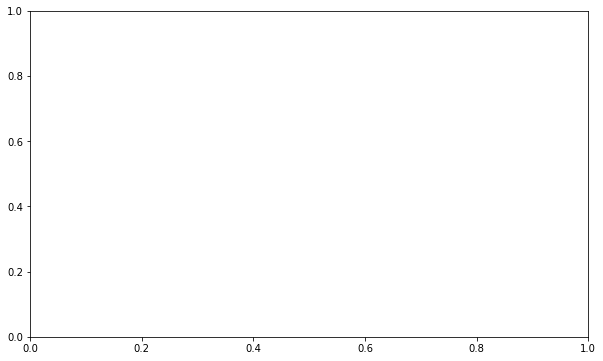

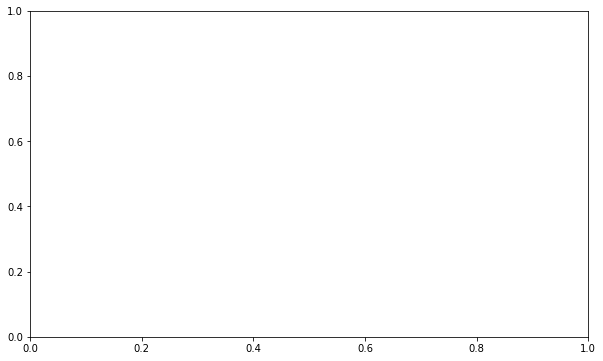

In [17]:
## with guess parameters [1,0]
std_filtering_before_fit(spectro_1_17_05_)

In [14]:
spectro_1_16_05_= sort_by_space_scin_screen(220,469,100,'2025/05/16',1)

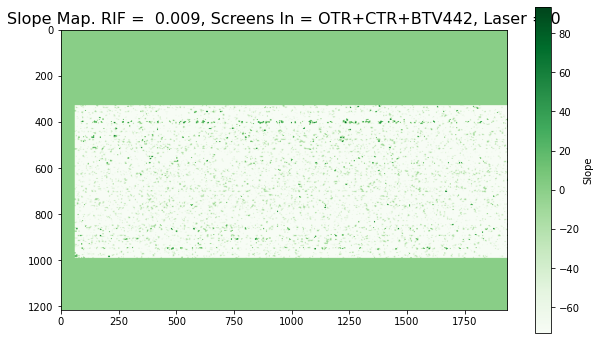

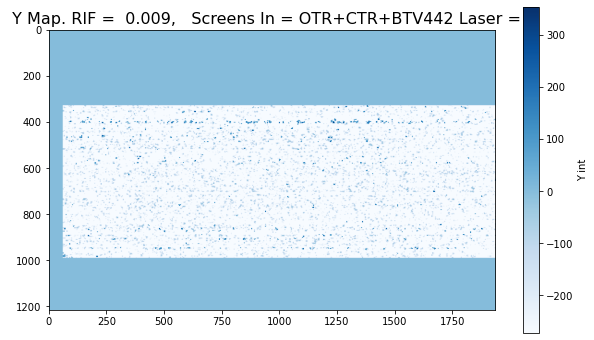

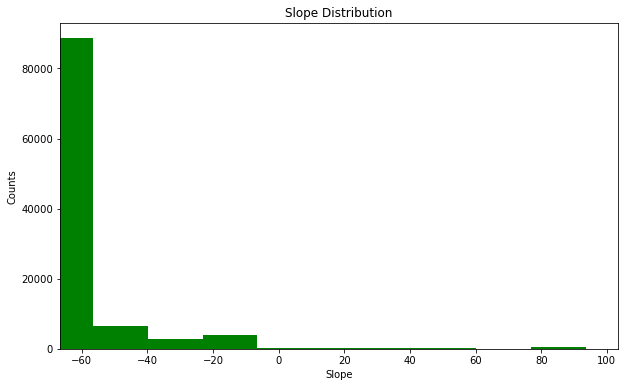

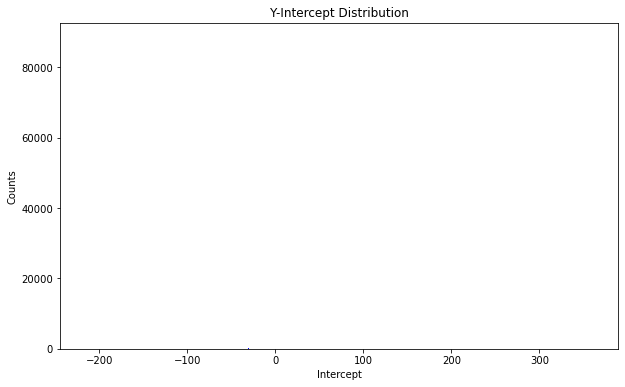

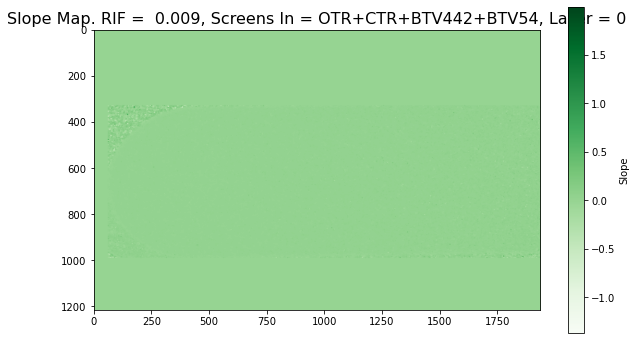

...

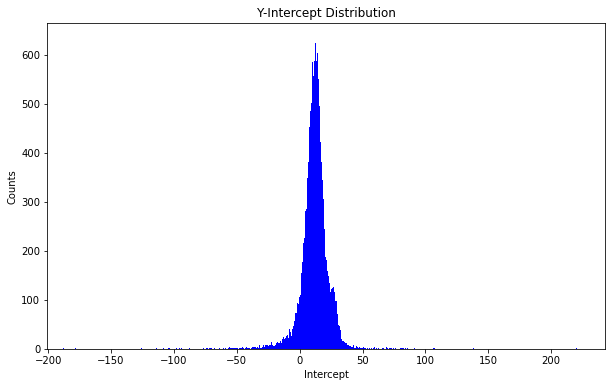

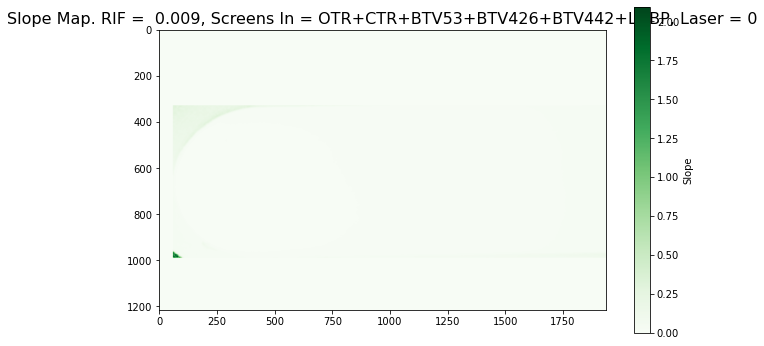

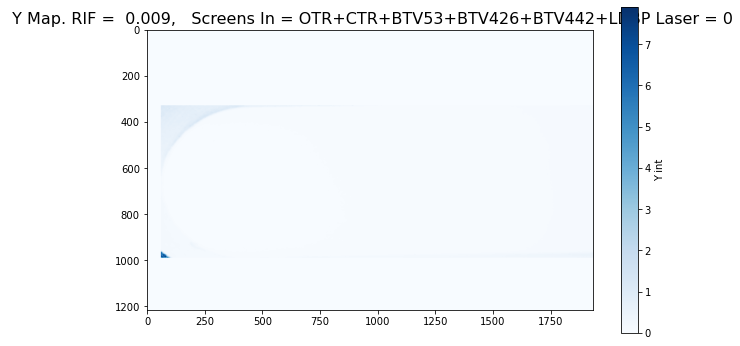

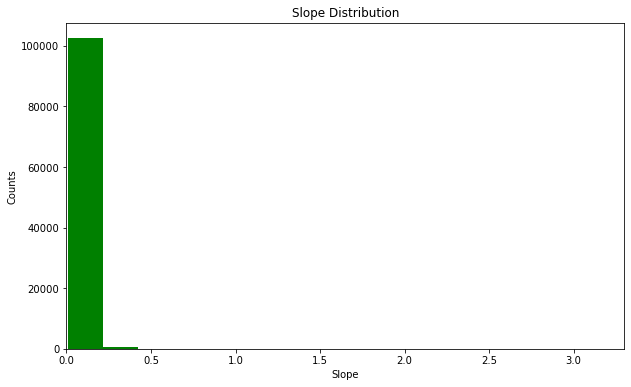

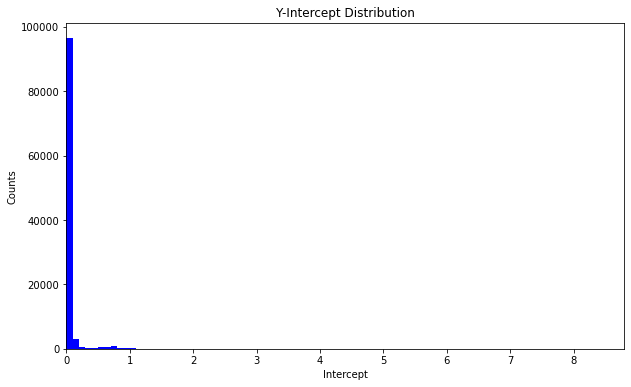

/tmp/ipykernel_457/2123038471.py:44: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, filtered_x, filtered_y)[0]


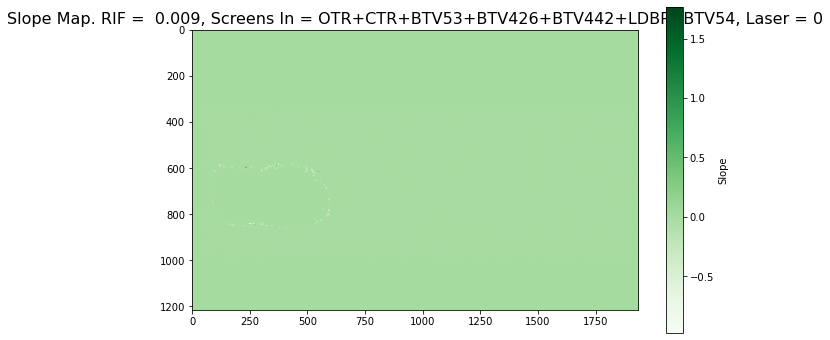

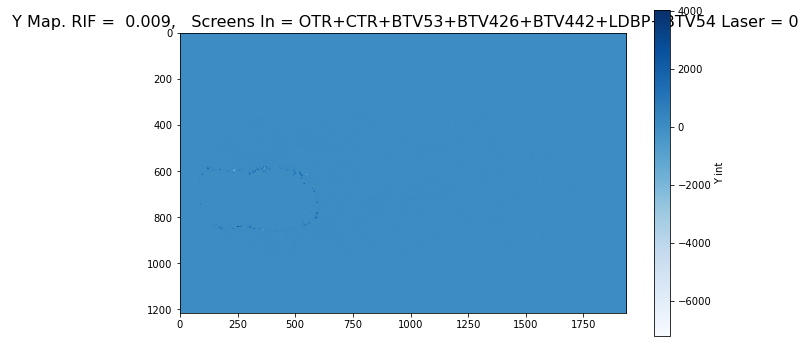

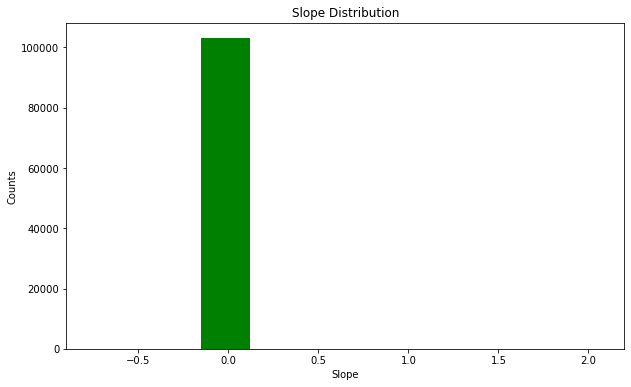

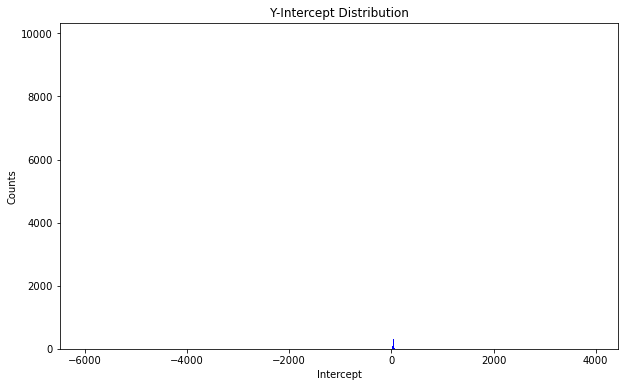

In [ ]:
std_filtering_before_fit(spectro_1_17_05_)

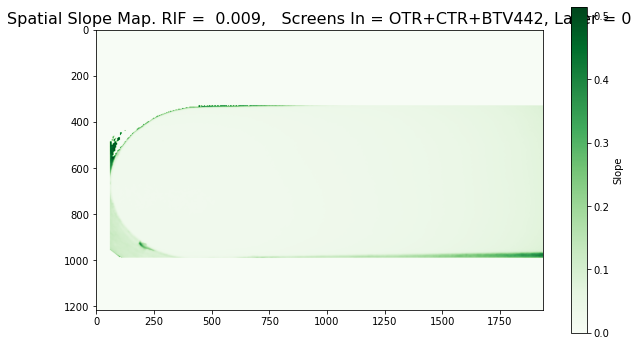

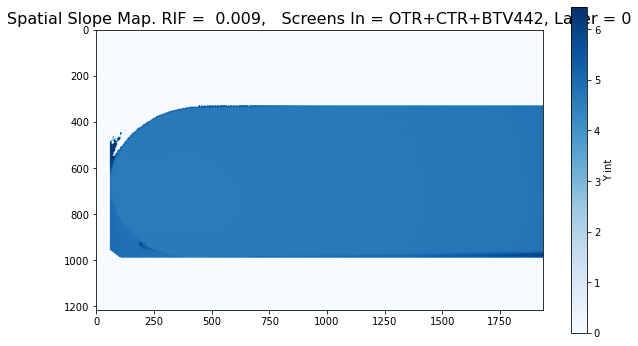

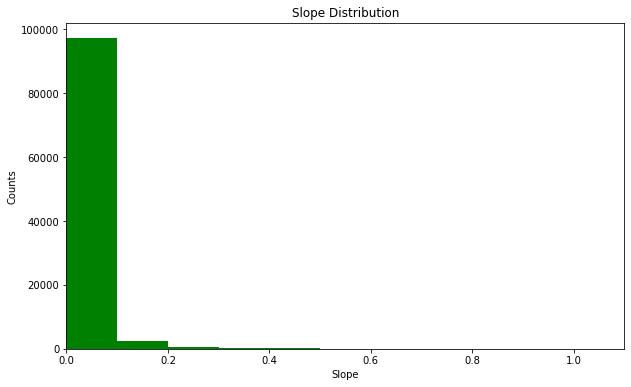

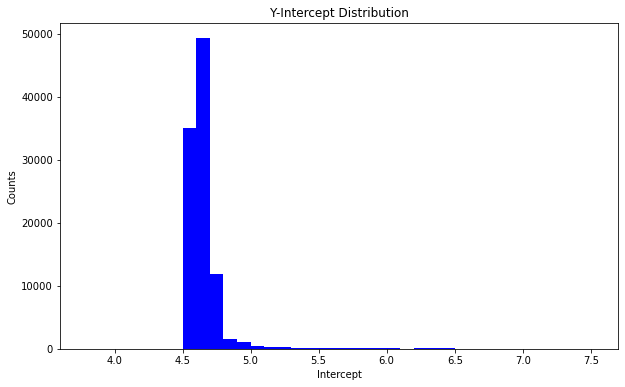

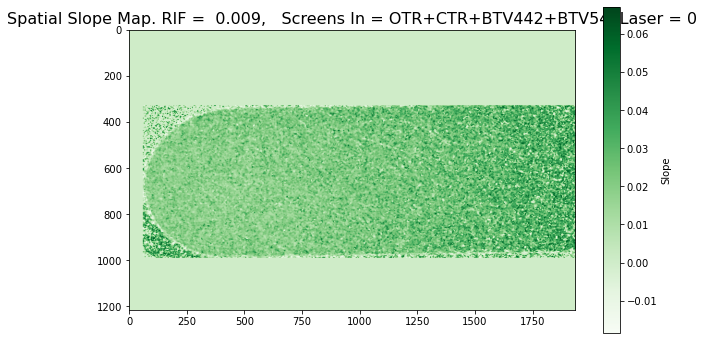

...

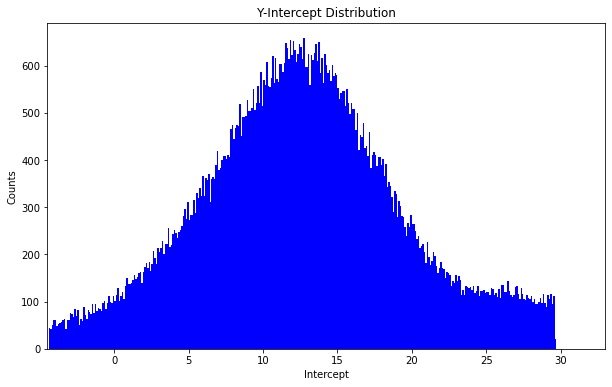

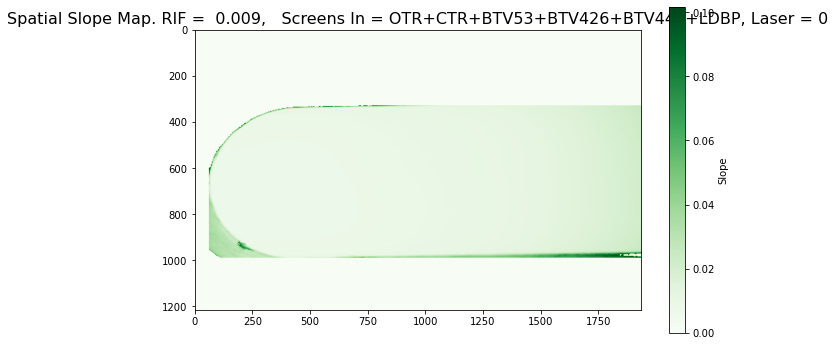

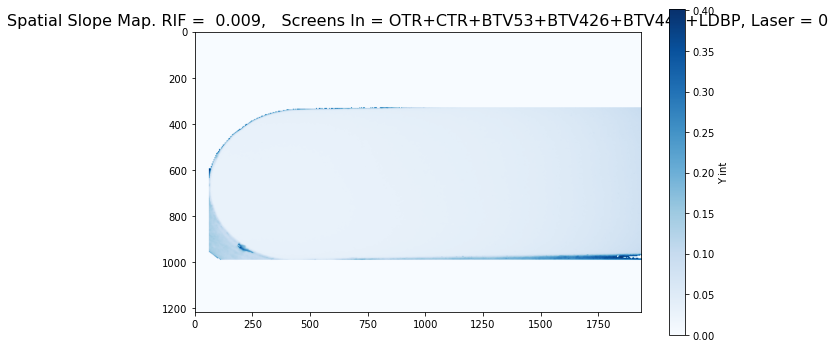

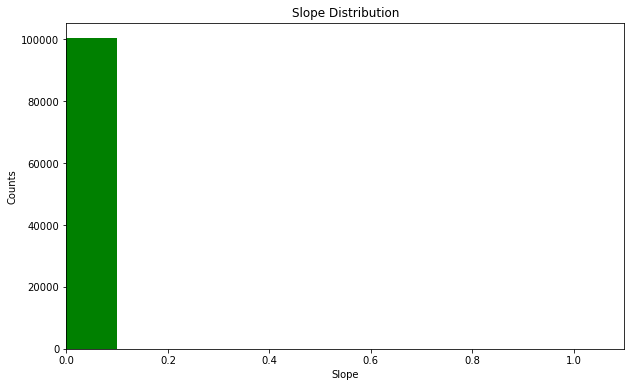

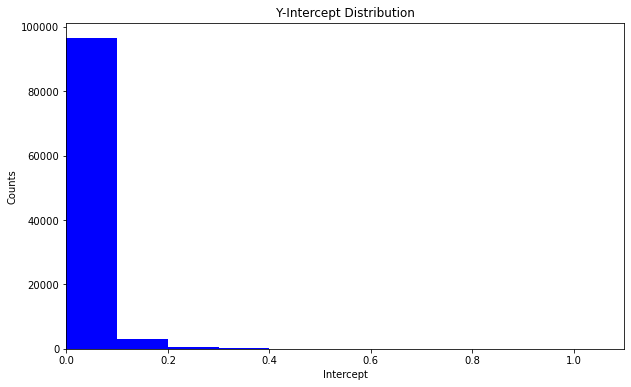

/tmp/ipykernel_457/1103855087.py:33: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


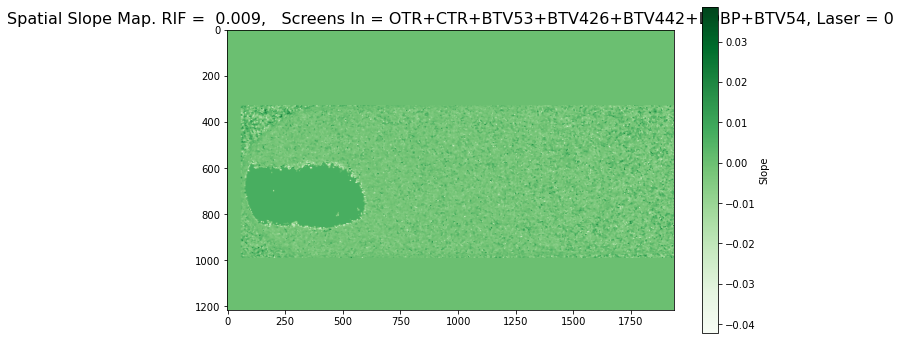

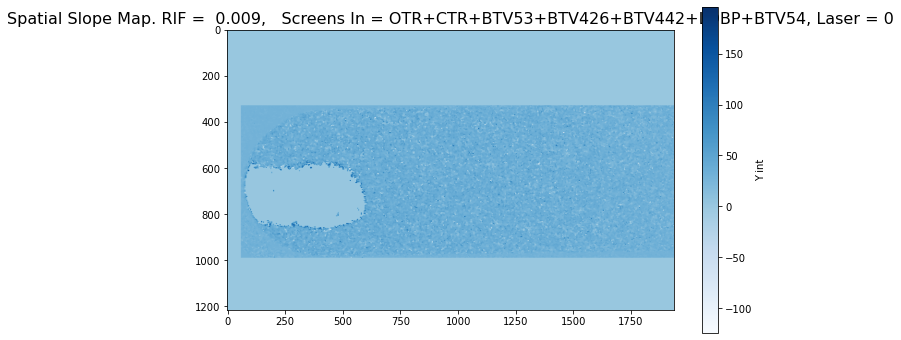

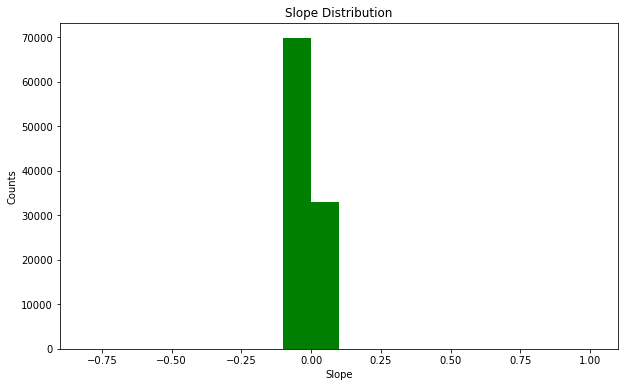

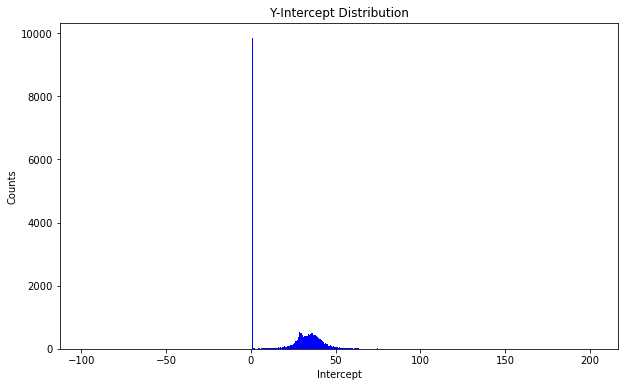

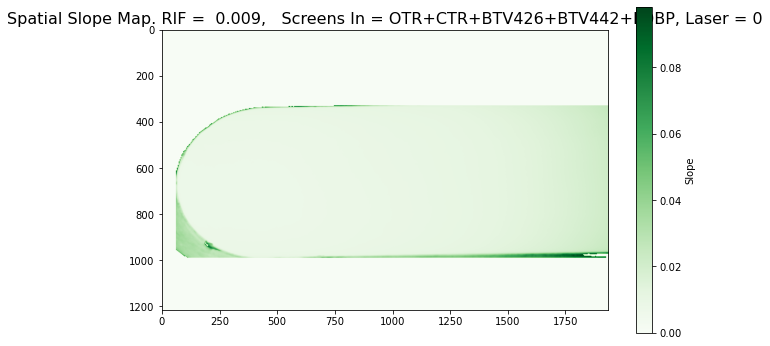

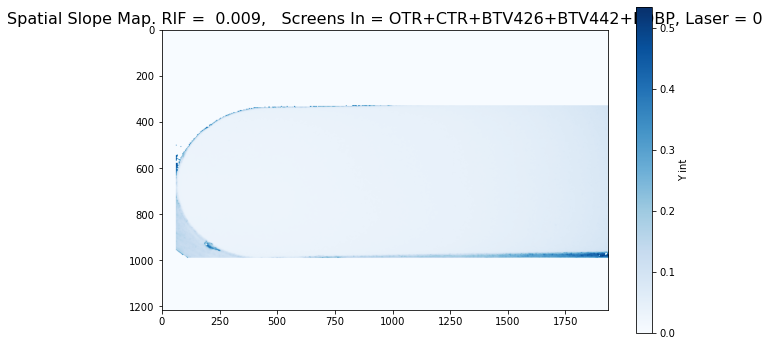

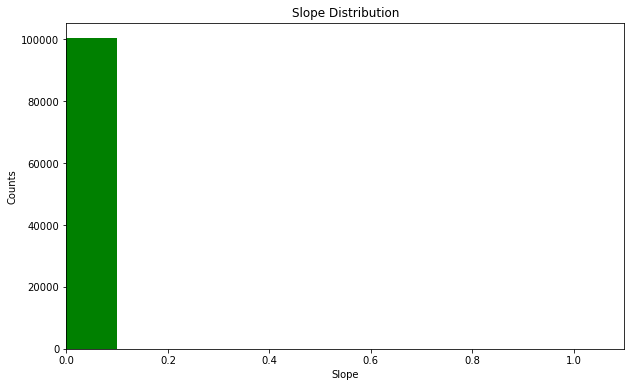

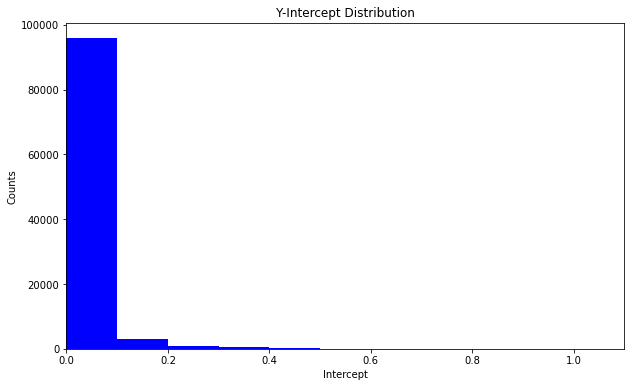

Error


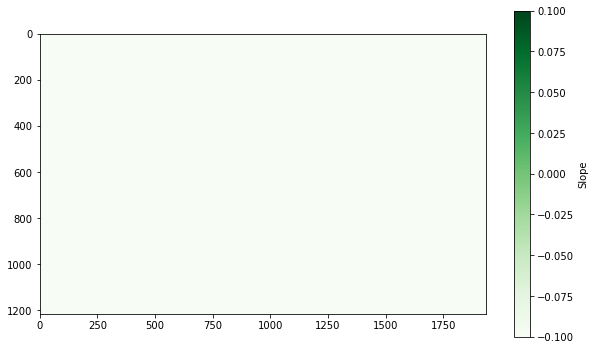

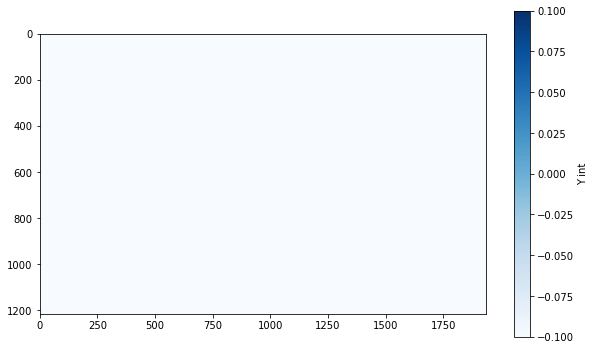

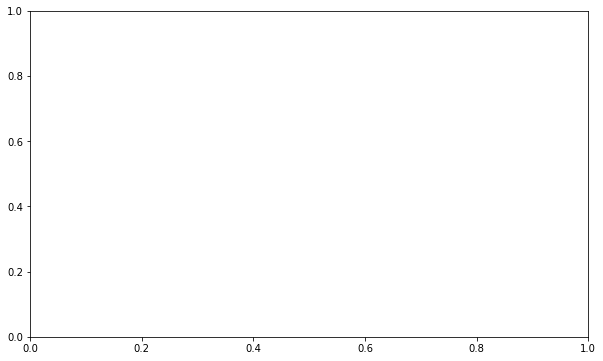

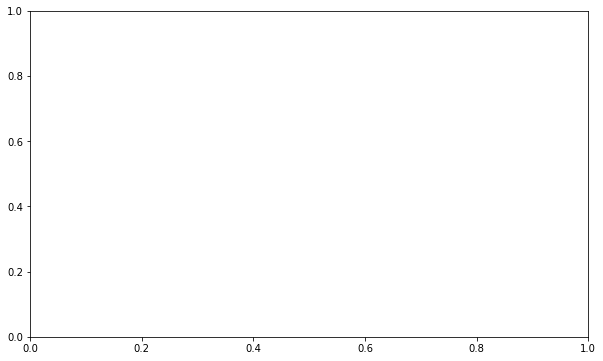

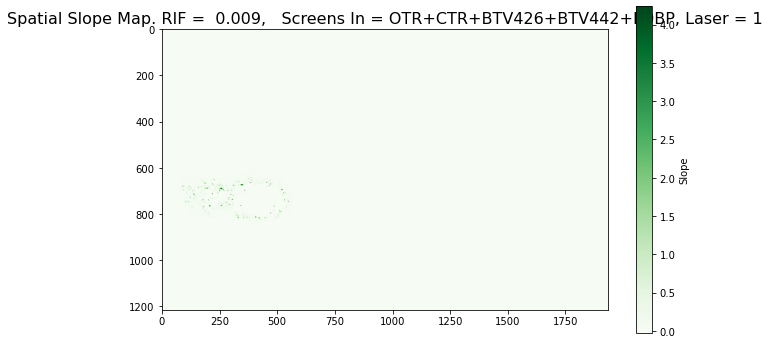

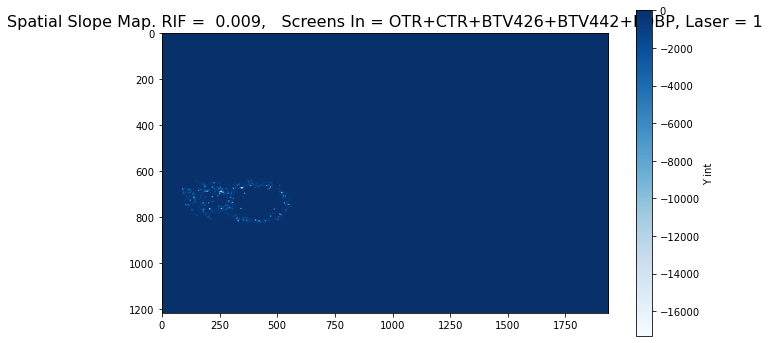

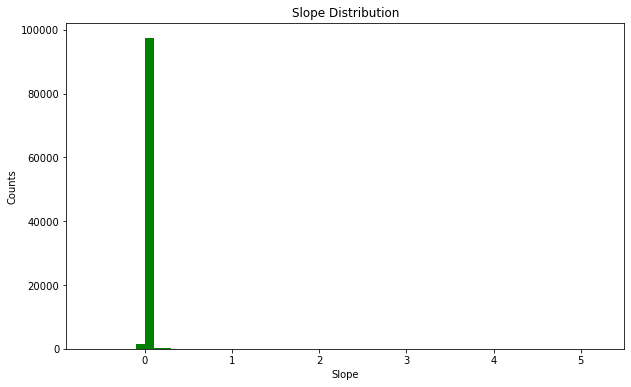

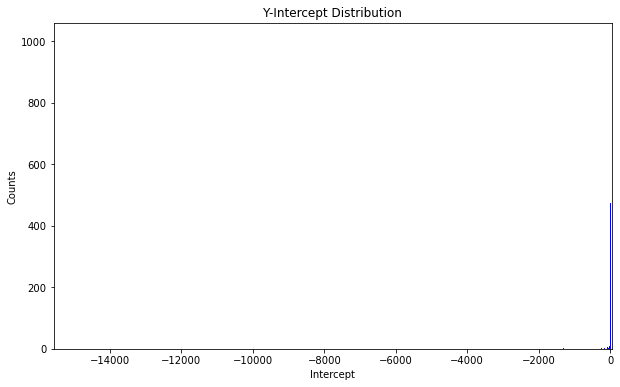

Error


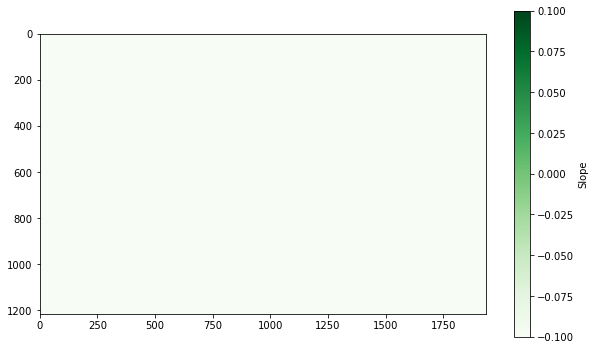

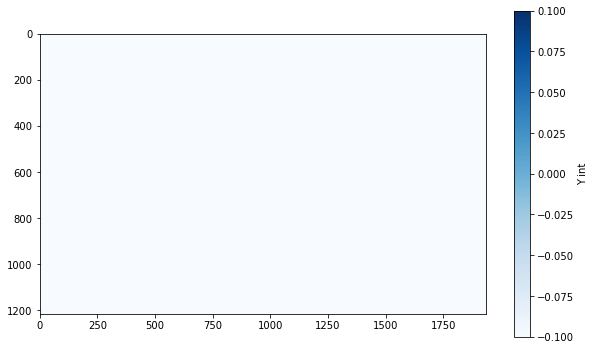

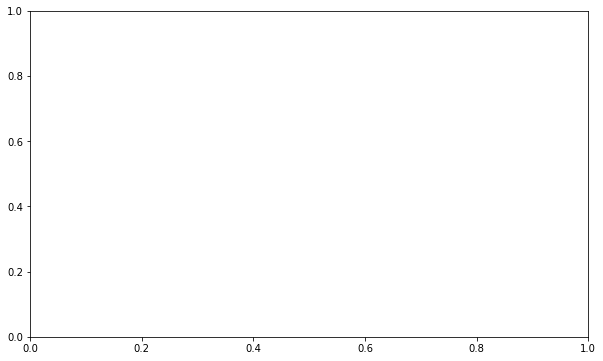

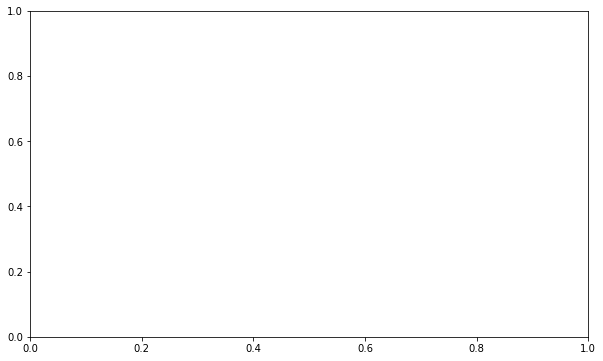

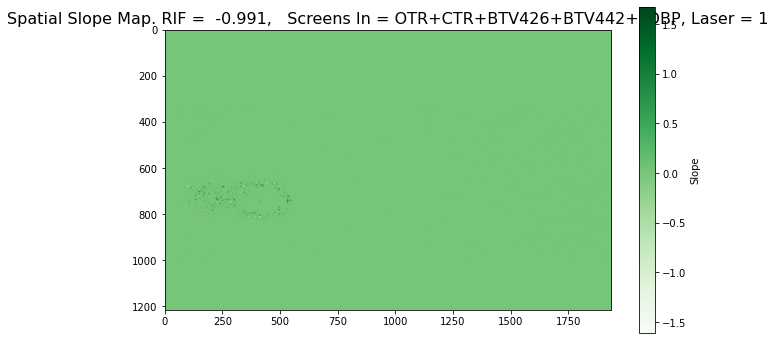

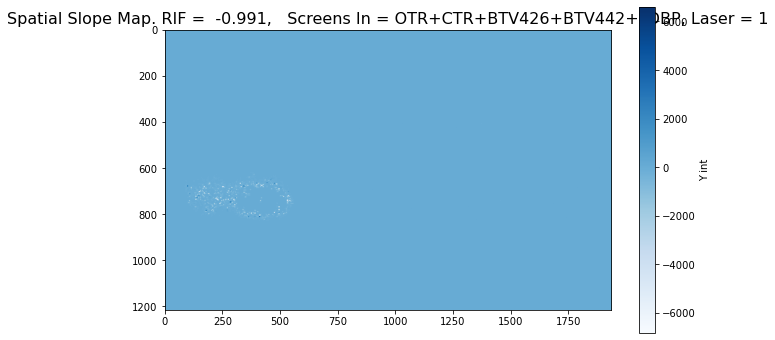

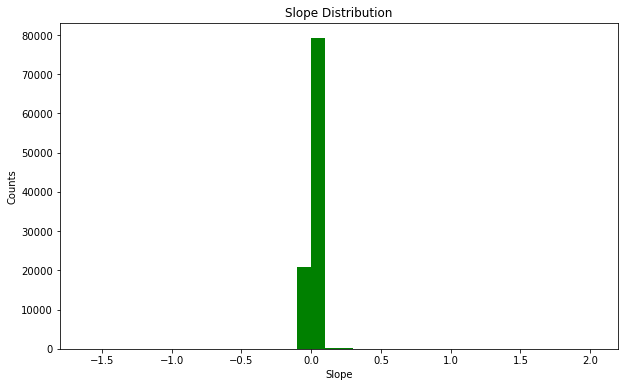

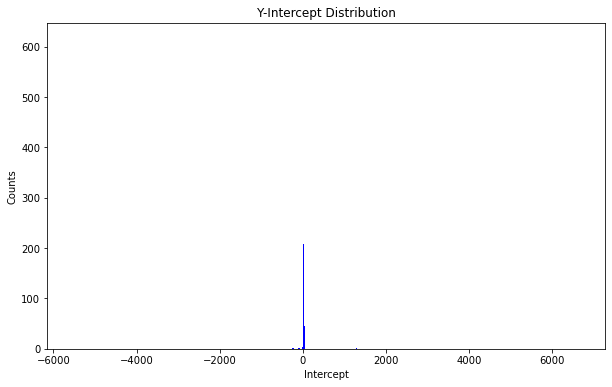

In [13]:
store_slopes_std_filtering(spectro_1_17_05_)

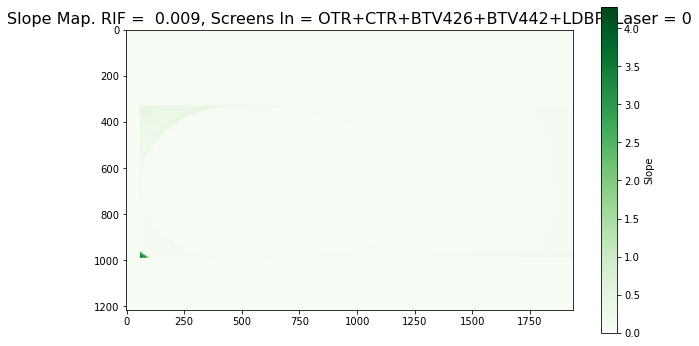

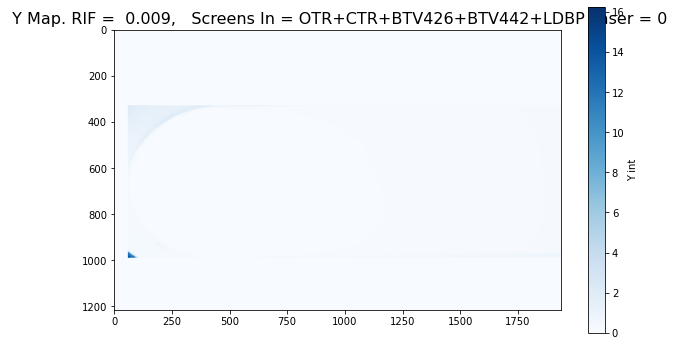

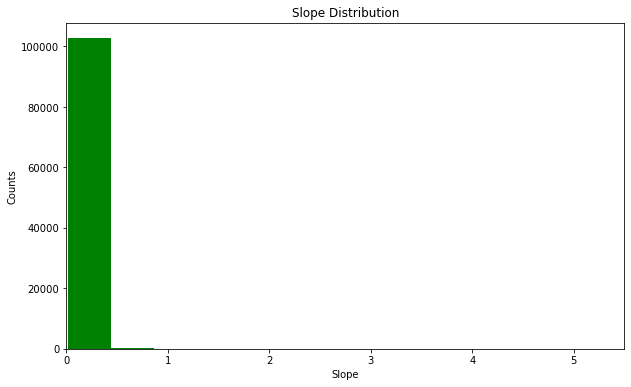

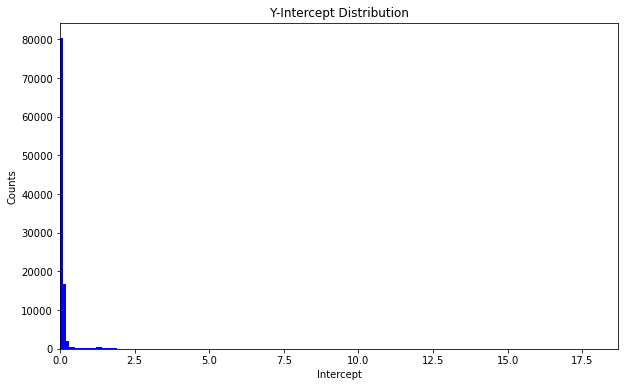

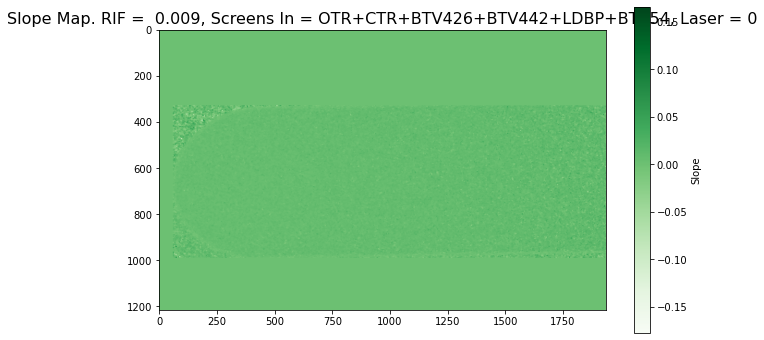

...

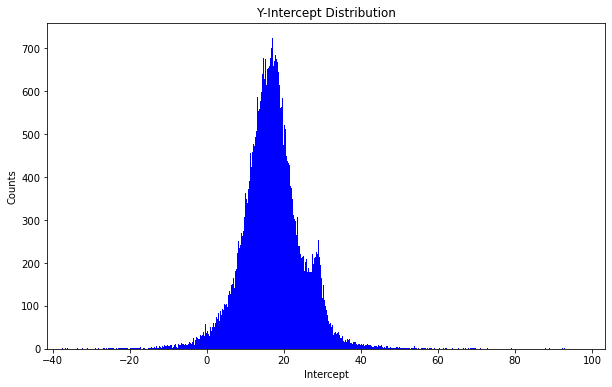

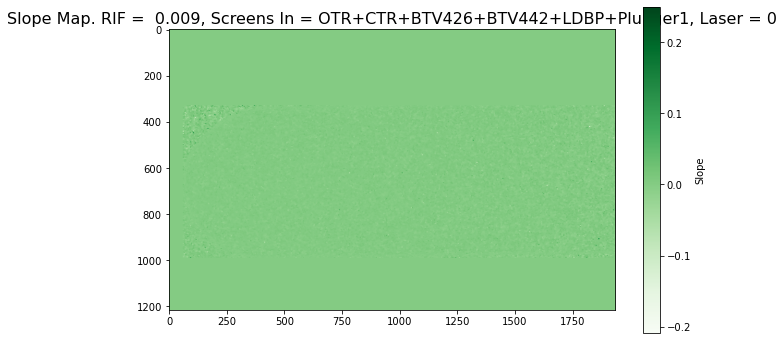

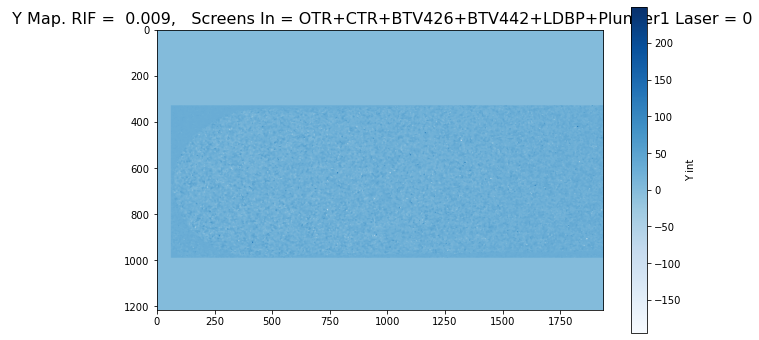

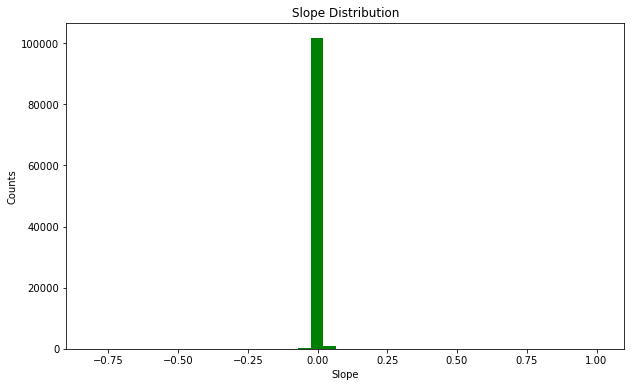

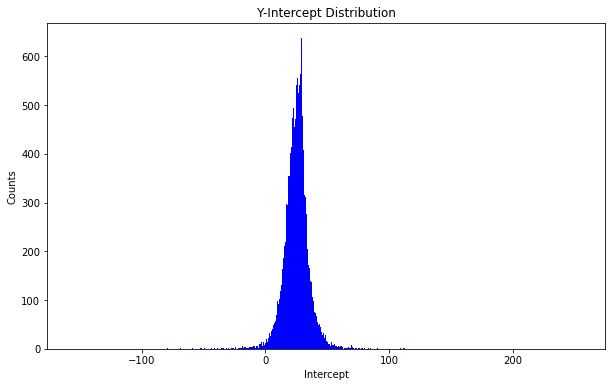

Error


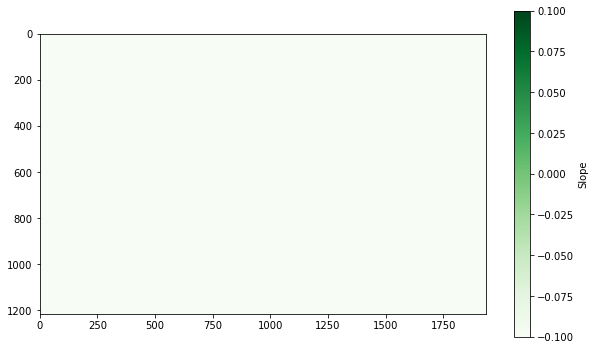

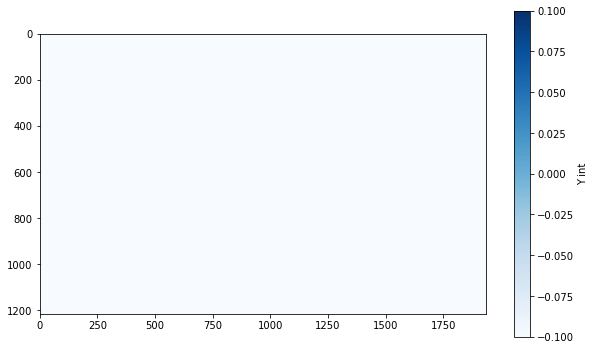

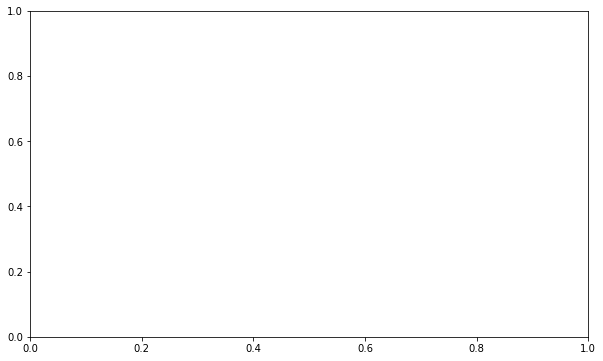

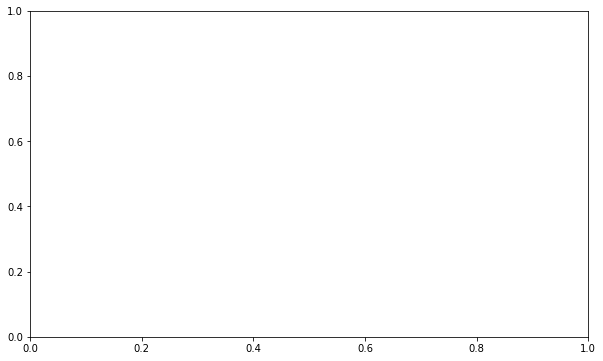

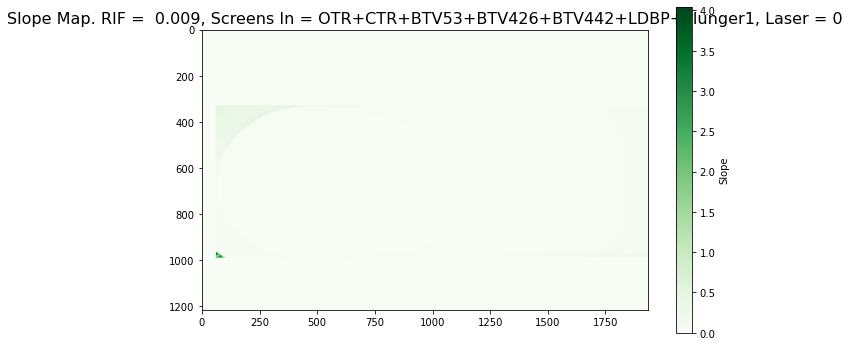

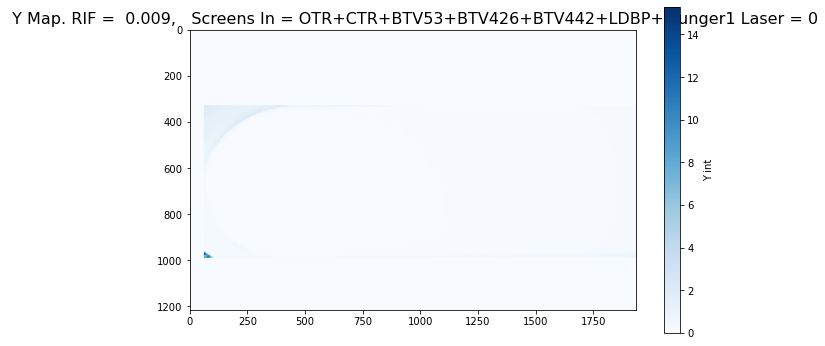

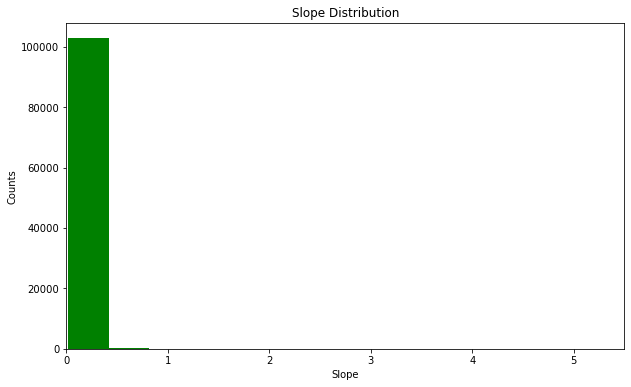

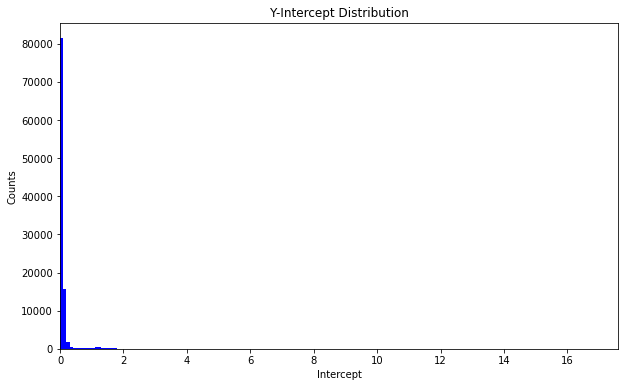

Error


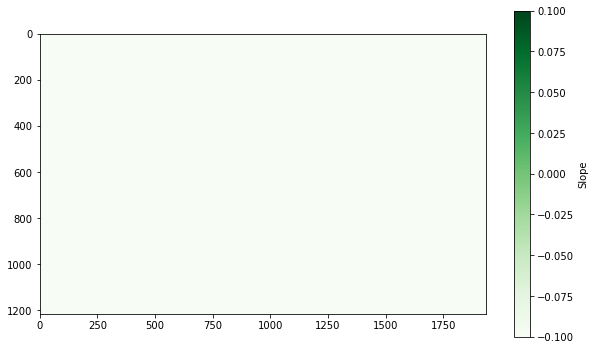

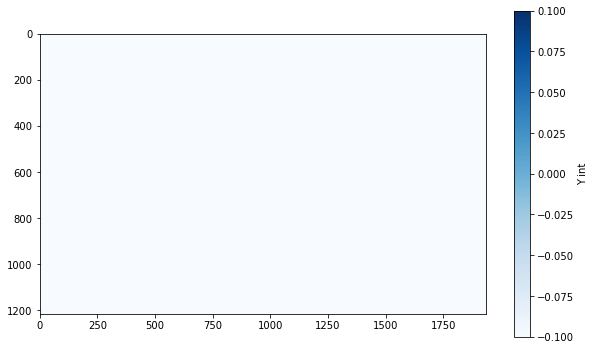

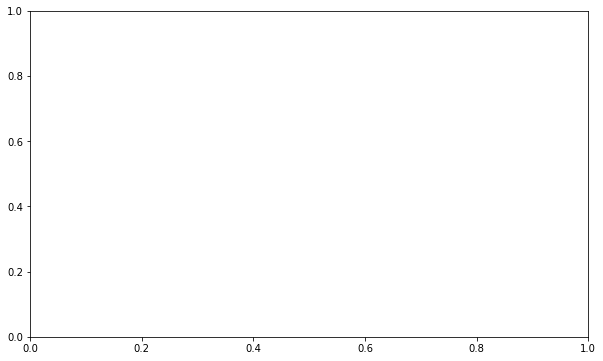

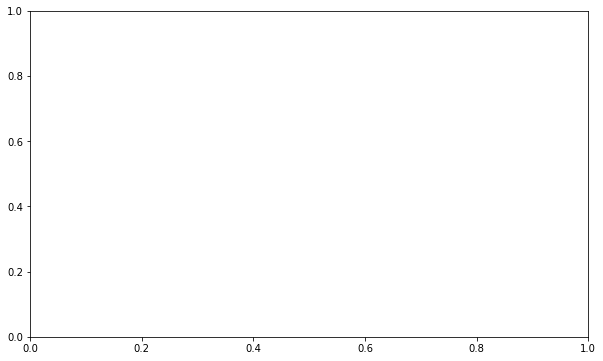

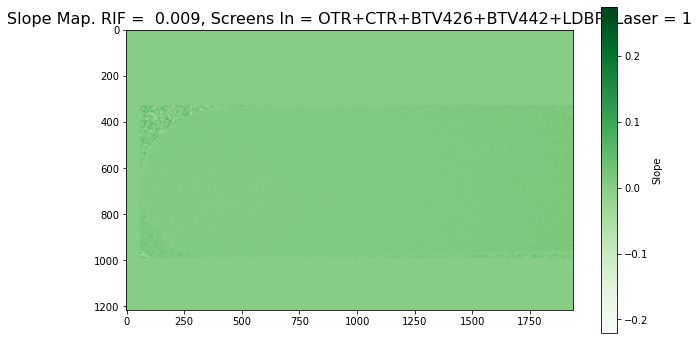

...

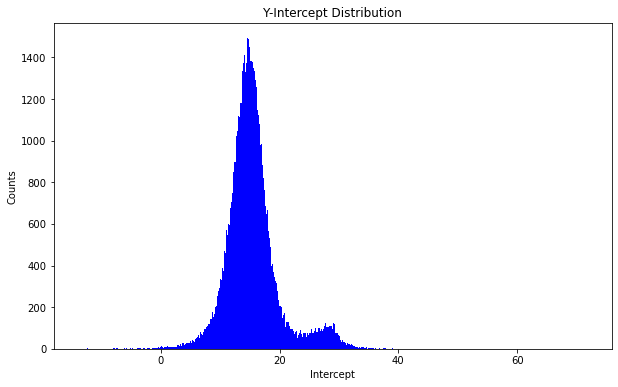

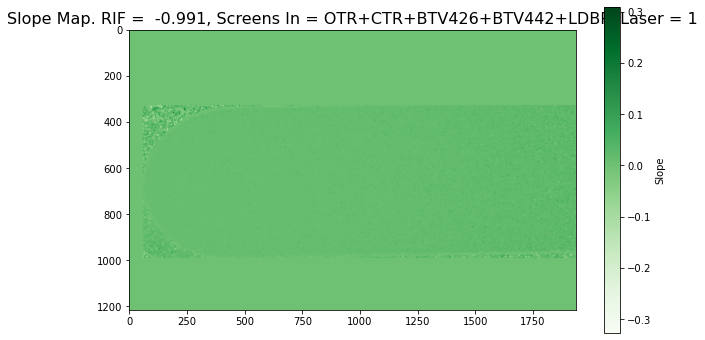

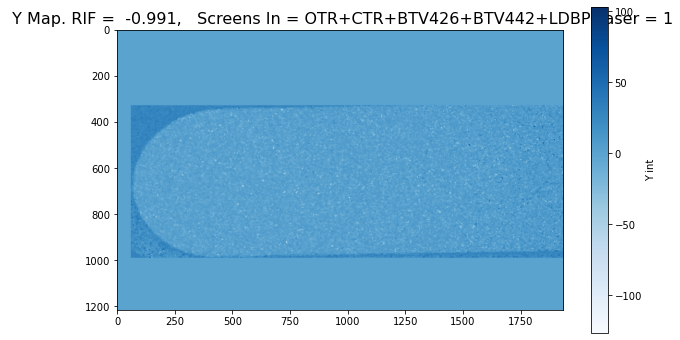

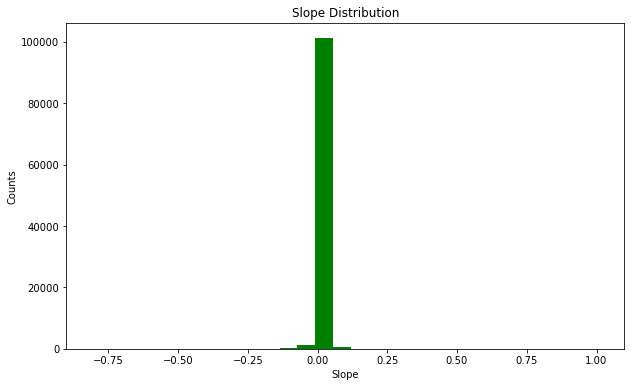

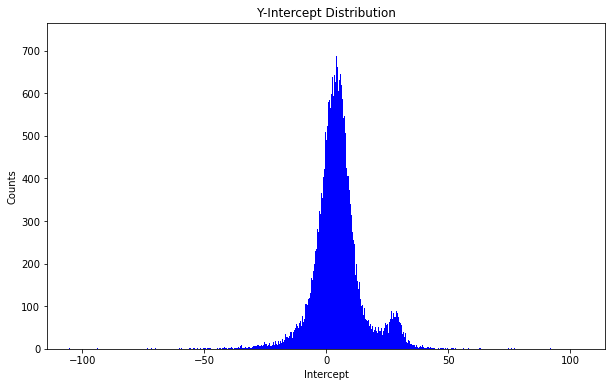

In [15]:
std_filtering_before_fit(spectro_1_16_05_)

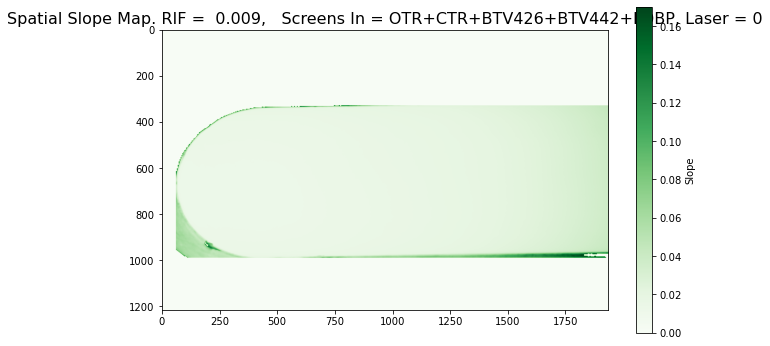

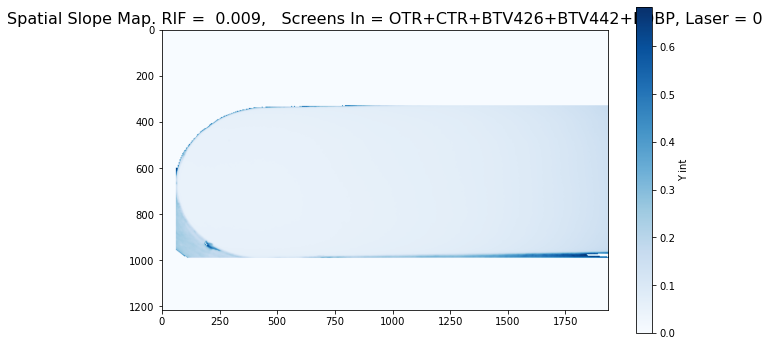

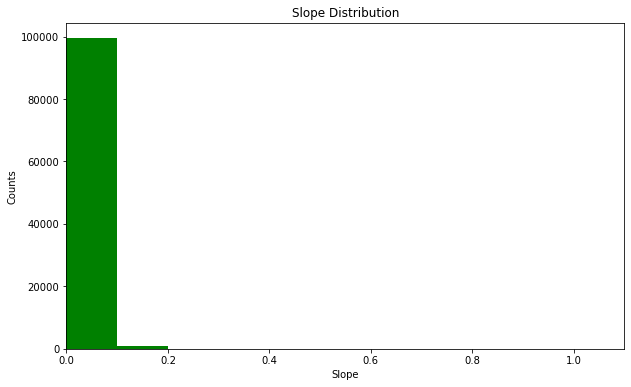

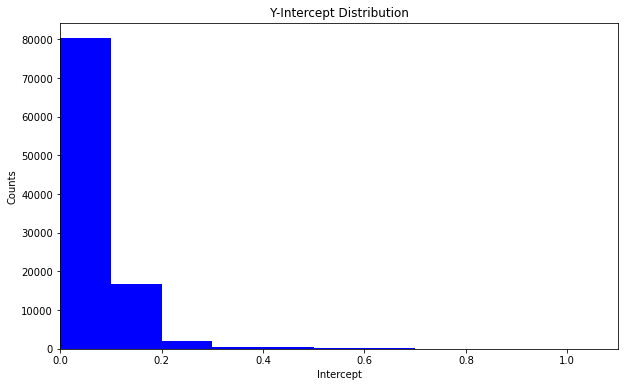

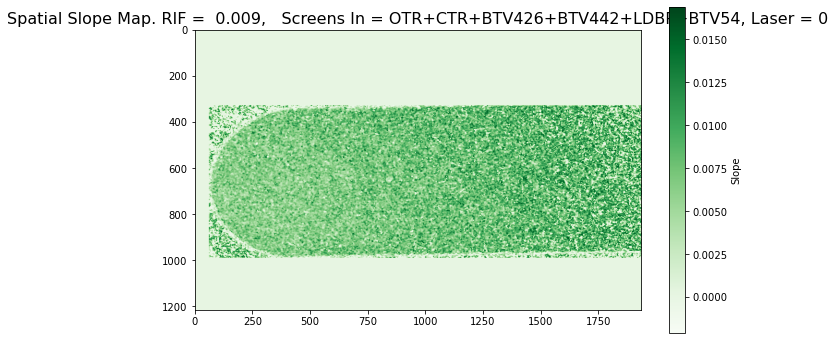

...

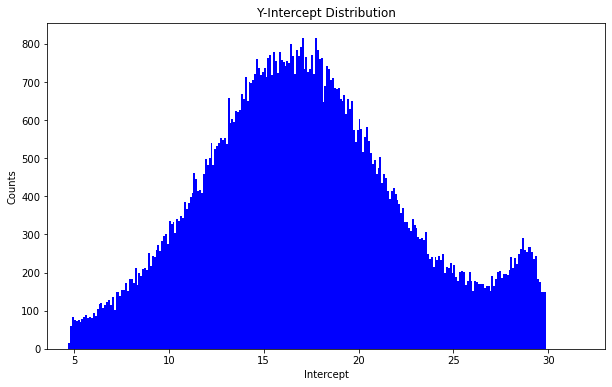

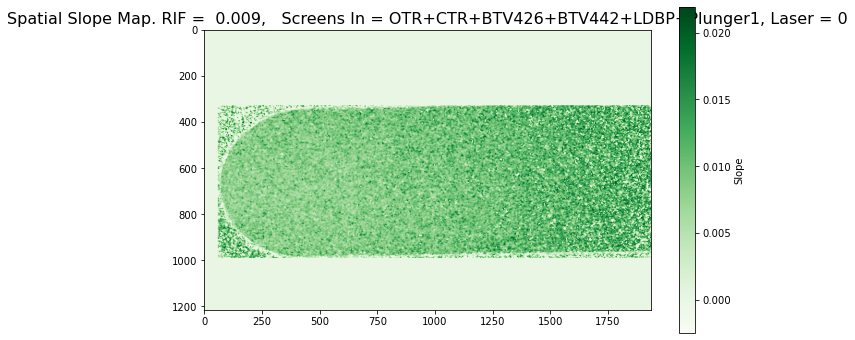

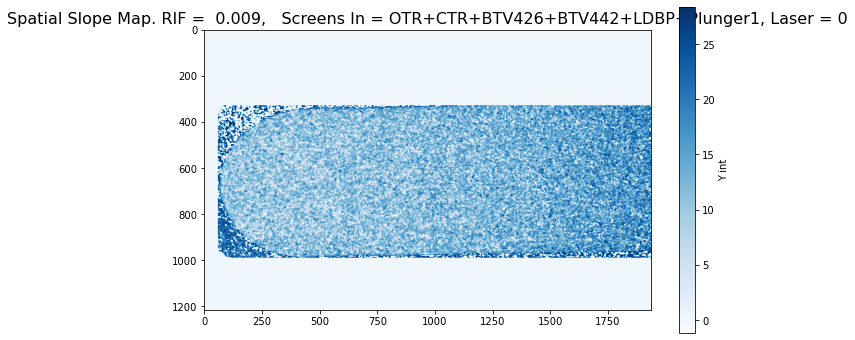

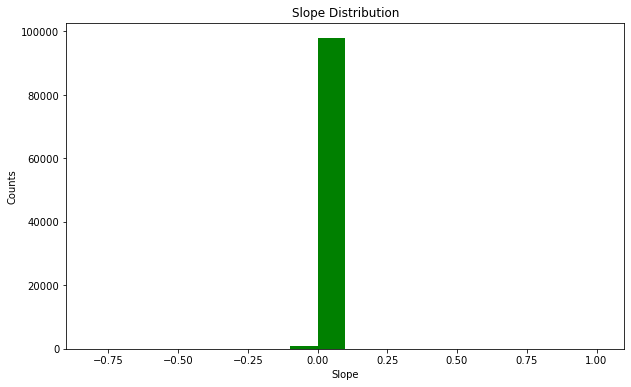

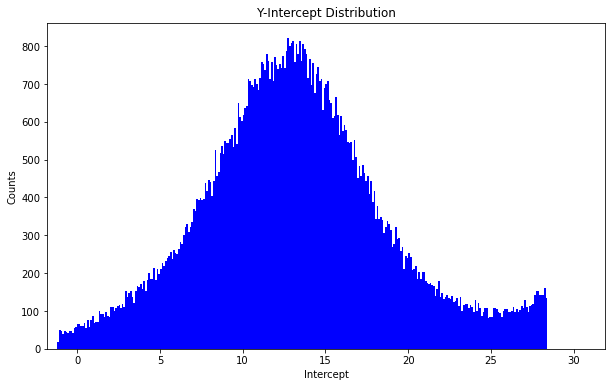

Error


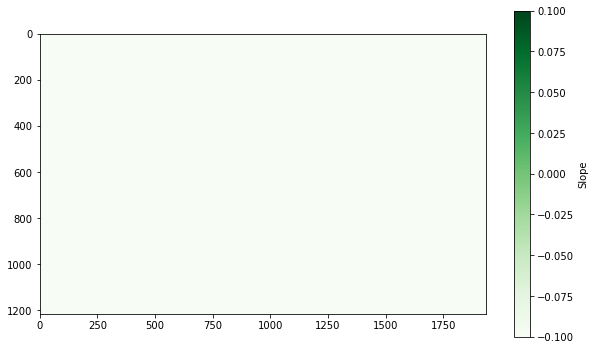

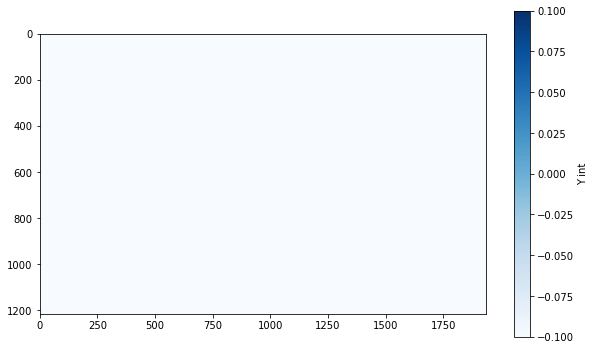

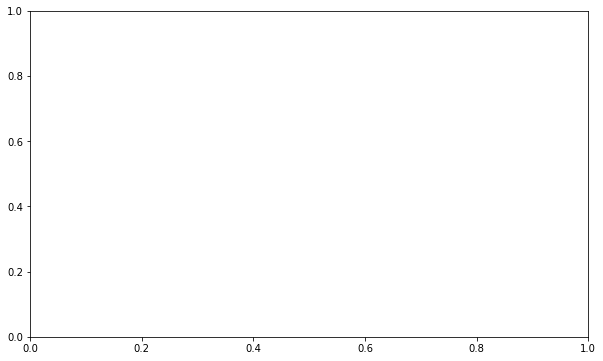

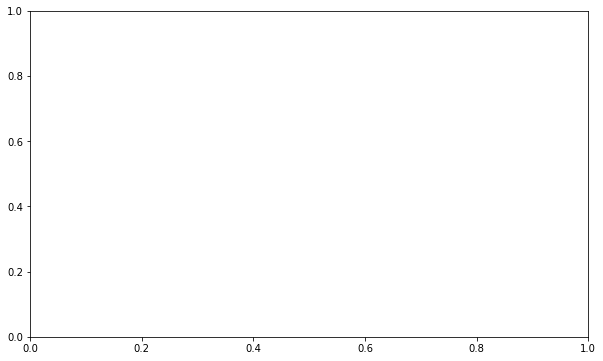

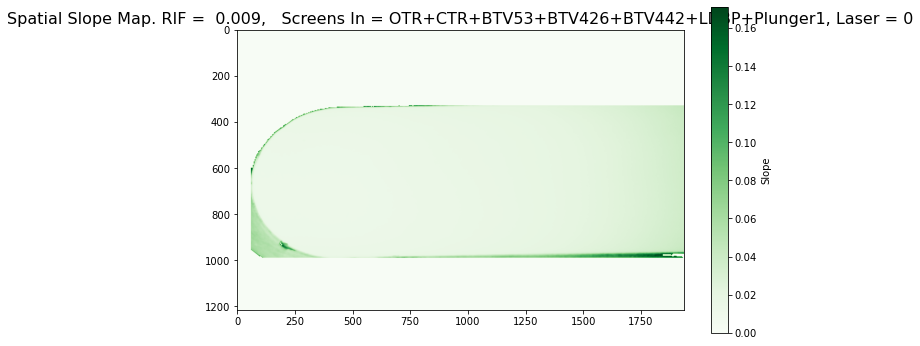

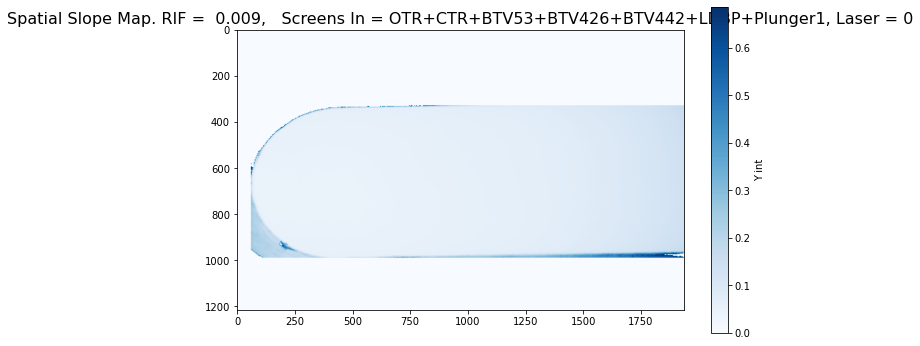

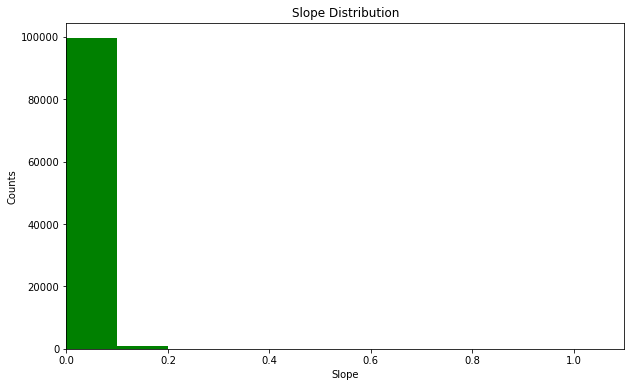

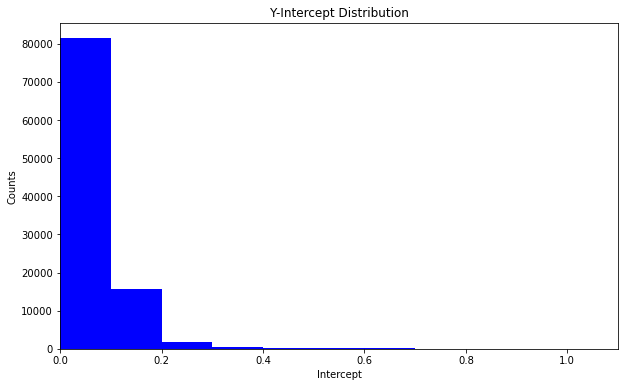

Error


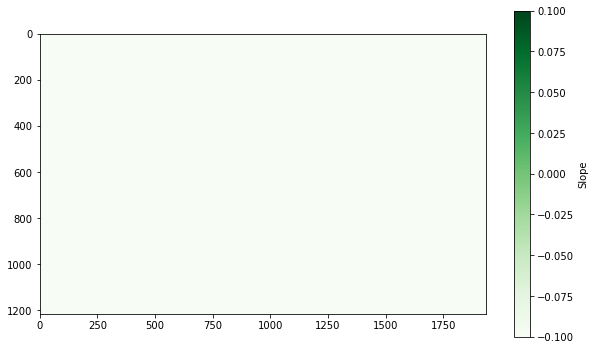

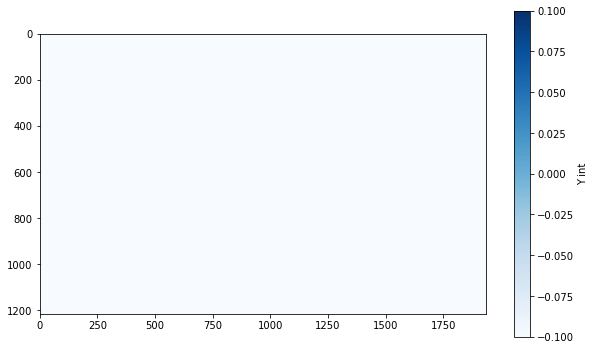

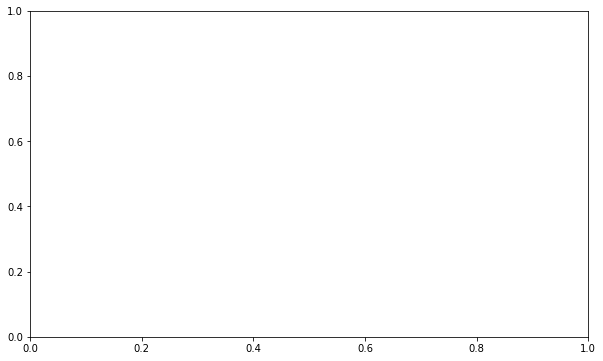

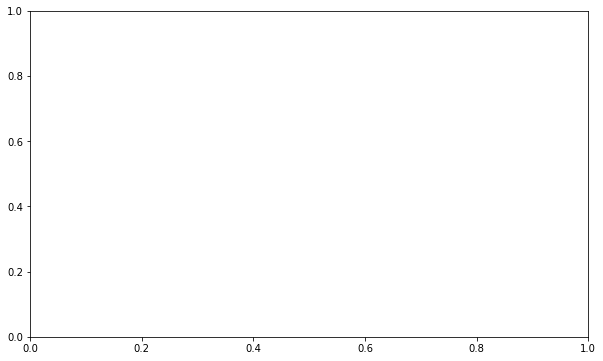

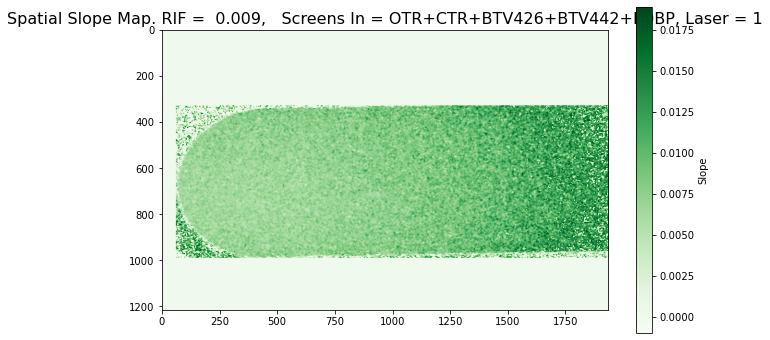

...

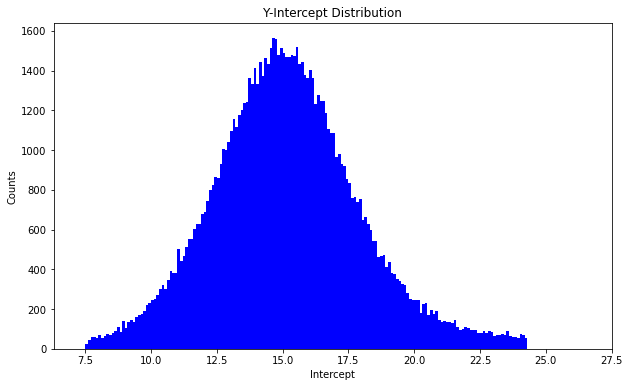

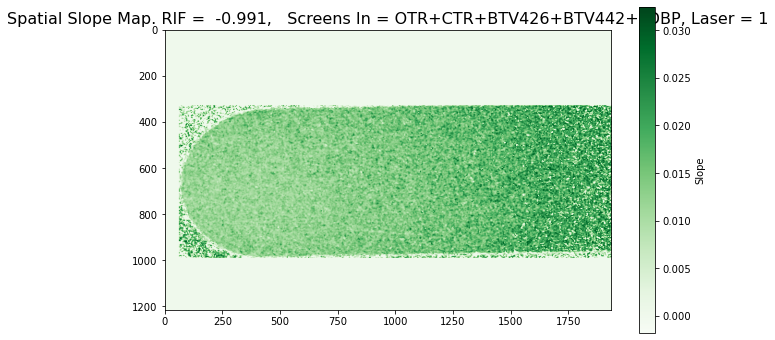

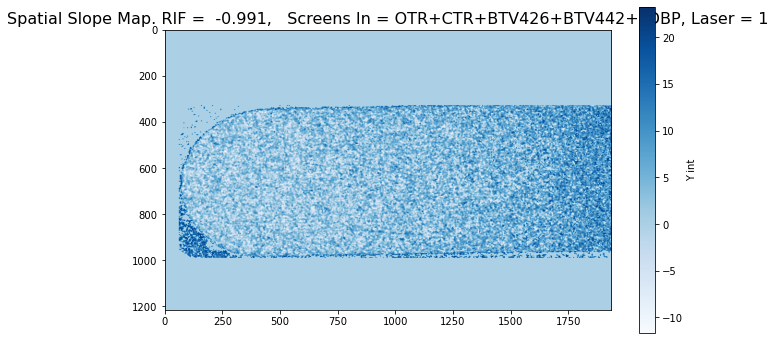

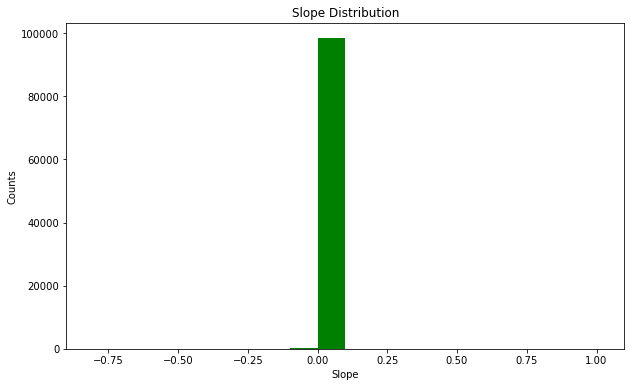

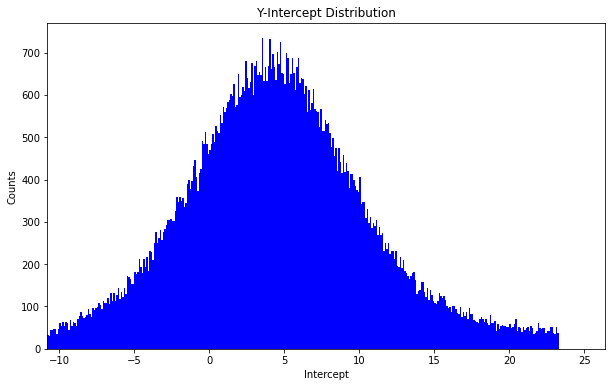

In [16]:
store_slopes_std_filtering(spectro_1_16_05_)

# CHECK FOR SATURATION

In [12]:
spectro_1_17_05 = sort_by_space_scin_screen(220,469,100,'2025/05/17',1)

In [50]:
list(spectro_1_17_05[1132482.608][0])

['OTR+CTR+BTV442',
 'OTR+CTR+BTV442+BTV54',
 'OTR+CTR+BTV53+BTV426+BTV442+LDBP',
 'OTR+CTR+BTV53+BTV426+BTV442+LDBP+BTV54',
 'OTR+CTR+BTV426+BTV442+LDBP',
 'OTR+CTR+BTV426+BTV442+LDBP+BTV54']

In [13]:
round(1132482.608 - 1132482.599, 4)

0.009

/tmp/ipykernel_458/3931593847.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, y, x,p0=[1,0])[0]


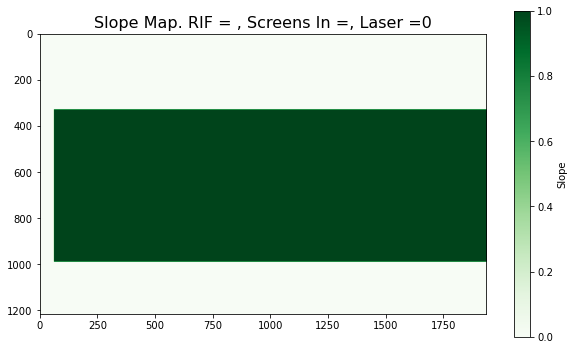

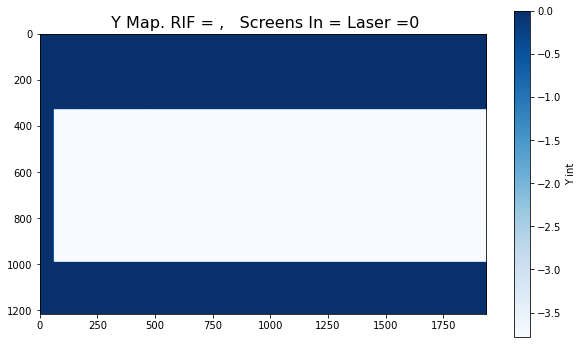

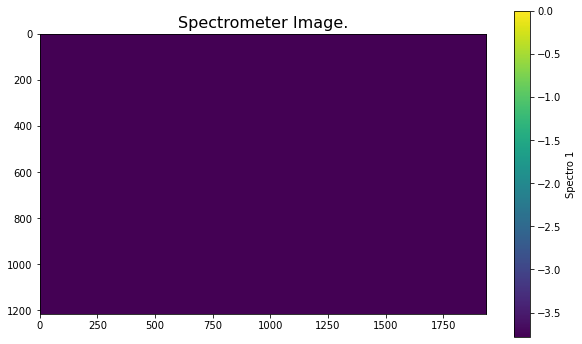

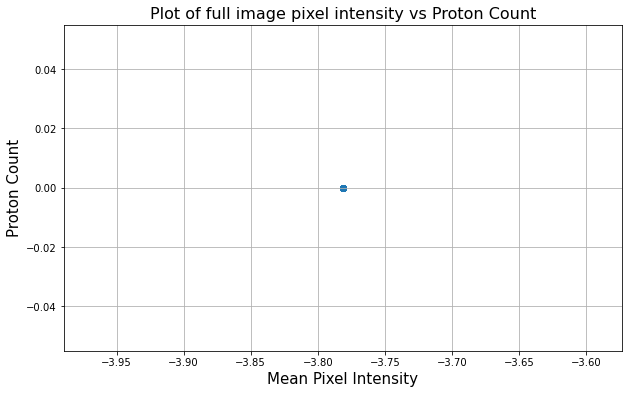

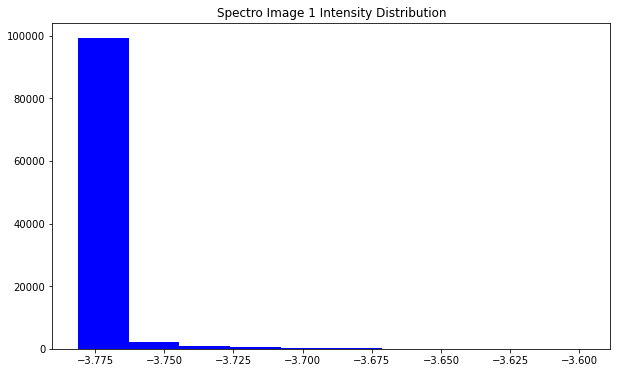

In [13]:
fig, ax = plt.subplots(figsize=(10, 6))
fig2, ax2 = plt.subplots(figsize=(10, 6))
fig3, ax3 = plt.subplots(figsize=(10, 6))
fig4, ax4 = plt.subplots(figsize=(10, 6))
fig5, ax5 = plt.subplots(figsize=(10, 6))

data = spectro_1_17_05[1132482.608][0]['OTR+CTR+BTV442']
index_count = list(data)

list_slopes = []
list_int = []
slope_heat_map = np.zeros((1216, 1936))
intercept_heat_map = np.zeros((1216, 1936))

spectro_map = np.zeros((1216, 1936))
list_intensities = []

for i in index_count:

    x = np.array(data[i]['fit_parameters'])
    #print(len(x))
    y = np.array(data[i]['proton_count'])      

    mean_x = np.mean(x)
    mean_y = np.mean(y)

    std_x = np.std(x)
    std_y = np.std(y)

    mask = (np.abs(x - mean_x) <= 2 * std_x) & (np.abs(y - mean_y) <= 2 * std_y)

    # Filter out outliers > 2 std deviations
    filtered_x = x[mask]
    filtered_y = y[mask]

    if len(filtered_x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
        params = curve_fit(fit_line, y, x,p0=[1,0])[0]
        a, b = params
        list_slopes.append(a)
        list_int.append(b)
        list_intensities.append(mean_x)

        slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
        intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b
        
        spectro_map[i[0]:i[1],i[2]:i[3]] = mean_x 


im = ax.imshow(slope_heat_map,cmap='Greens',origin='upper')
ax.imshow(slope_heat_map,cmap='Greens')
fig.colorbar(im, ax=ax, label ='Slope')

im2 = ax2.imshow(intercept_heat_map,cmap='Blues',origin='upper')
ax2.imshow(intercept_heat_map,cmap='Blues')
fig2.colorbar(im2, ax=ax2, label ='Y int')

im3 = ax3.imshow(spectro_map)
ax3.imshow(spectro_map,vmax=4095)
fig.colorbar(im3, ax=ax3, label ='Spectro 1')

ax4.scatter(x,y)
ax4.set_xlabel('Mean Pixel Intensity', fontsize=15)
ax4.set_ylabel('Proton Count', fontsize=15)
ax4.grid()

bin_width = 0.5

# Histogram for pixel intensities
min_intensity = np.floor(min(list_intensities))
max_intensity = np.ceil(max(list_intensities))
bins = np.arange(min_intensity, max_intensity + bin_width, bin_width)

ax5.hist(list_intensities,color='Blue')
ax5.set_title('Spectro Image 1 Intensity Distribution')

ax.set_title(f'Slope Map. RIF = , Screens In =, Laser =0', fontsize=16)
ax2.set_title(f' Y Map. RIF = ,   Screens In = Laser =0', fontsize=16)

ax3.set_title(f'Spectrometer Image.', fontsize=16)
ax4.set_title(f'Plot of full image pixel intensity vs Proton Count', fontsize=16)

plt.show()

In [14]:
counter = 0
new_intensities = []

for i in list_intensities:
    
    if i > 4000:
        counter +=1
        
    else:
        new_intensities.append(i)
        
        
print(counter)
print(counter/len(list_intensities))

0
0.0


/tmp/ipykernel_458/3221297367.py:37: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, filtered_y, filtered_x,p0=[1,0])[0]


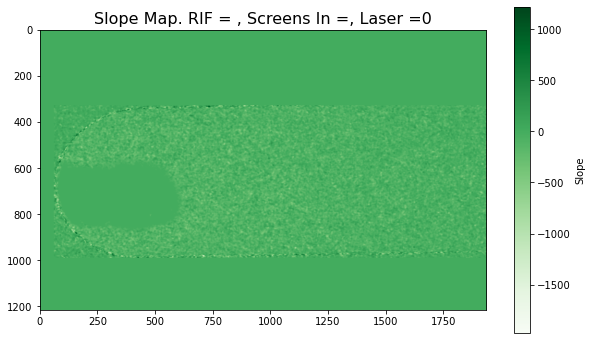

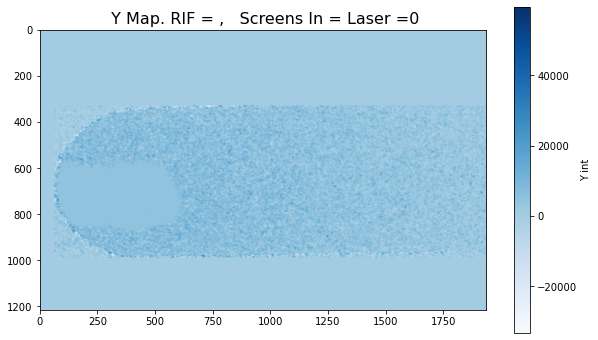

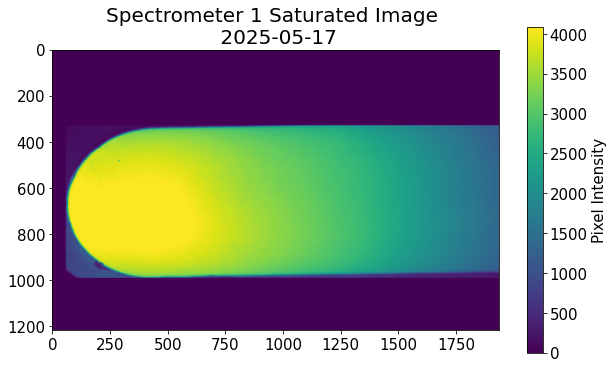

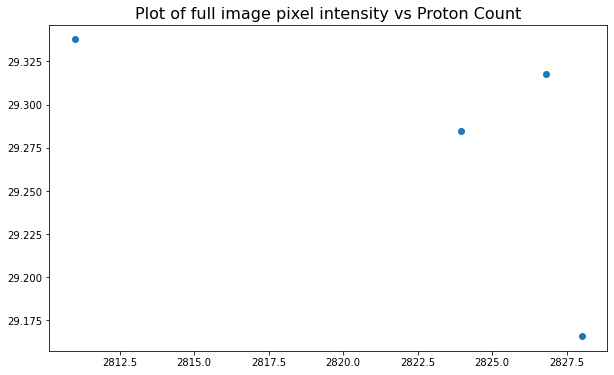

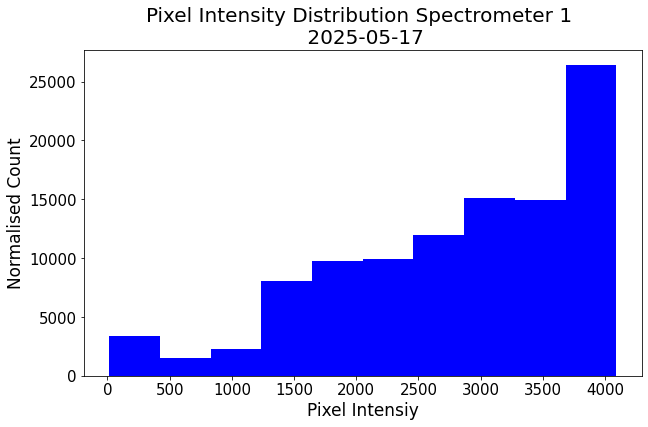

In [30]:
fig, ax = plt.subplots(figsize=(10, 6))
fig2, ax2 = plt.subplots(figsize=(10, 6))
fig3, ax3 = plt.subplots(figsize=(10, 6))
fig4, ax4 = plt.subplots(figsize=(10, 6))
fig5, ax5 = plt.subplots(figsize=(10, 6))

data = spectro_1_17_05[1132482.608][0]['OTR+CTR+BTV53+BTV426+BTV442+LDBP+BTV54']
index_count = list(data)

list_slopes = []
list_int = []
slope_heat_map = np.zeros((1216, 1936))
intercept_heat_map = np.zeros((1216, 1936))

spectro_map = np.zeros((1216, 1936))
list_intensities = []

for i in index_count:

    x = np.array(data[i]['fit_parameters'])
    #print(len(x))
    y = np.array(data[i]['proton_count'])      

    mean_x = np.mean(x)
    mean_y = np.mean(y)

    std_x = np.std(x)
    std_y = np.std(y)

    mask = (np.abs(x - mean_x) <= 2 * std_x) & (np.abs(y - mean_y) <= 2 * std_y)

    # Filter out outliers > 2 std deviations
    filtered_x = x[mask]
    filtered_y = y[mask]

    if len(filtered_x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
        params = curve_fit(fit_line, filtered_y, filtered_x,p0=[1,0])[0]
        a, b = params
        list_slopes.append(a)
        list_int.append(b)
        list_intensities.append(mean_x)

        slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
        intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b
        
        spectro_map[i[0]:i[1],i[2]:i[3]] = mean_x 


im = ax.imshow(slope_heat_map,cmap='Greens',origin='upper')
ax.imshow(slope_heat_map,cmap='Greens')
fig.colorbar(im, ax=ax, label ='Slope')

im2 = ax2.imshow(intercept_heat_map,cmap='Blues',origin='upper')
ax2.imshow(intercept_heat_map,cmap='Blues')
fig2.colorbar(im2, ax=ax2, label ='Y int')

im3 = ax3.imshow(spectro_map)
ax3.imshow(spectro_map)
cbar = fig.colorbar(im3, ax=ax3)
cbar.ax.tick_params(labelsize=15)
cbar.set_label('Pixel Intensity',fontsize=15)

ax4.scatter(data['full_image']['fit_parameters'],data['full_image']['proton_count'])

bin_width = 0.5

# Histogram for pixel intensities
min_intensity = np.floor(min(list_intensities))
max_intensity = np.ceil(max(list_intensities))
bins = np.arange(min_intensity, max_intensity + bin_width, bin_width)

ax5.hist(list_intensities,color='Blue')
ax5.set_title('Pixel Intensity Distribution Spectrometer 1 \n 2025-05-17',fontsize=20)
ax5.tick_params(axis='both', which='major', labelsize=15)
ax5.set_xlabel('Pixel Intensiy', fontsize=17)
ax5.set_ylabel('Normalised Count', fontsize=17)


ax.set_title(f'Slope Map. RIF = , Screens In =, Laser =0', fontsize=16)
ax2.set_title(f' Y Map. RIF = ,   Screens In = Laser =0', fontsize=16)

ax3.set_title(f'Spectrometer 1 Saturated Image \n 2025-05-17', fontsize=20)
ax3.tick_params(axis='both', which='major', labelsize=15)
ax4.set_title(f'Plot of full image pixel intensity vs Proton Count', fontsize=16)

plt.show()

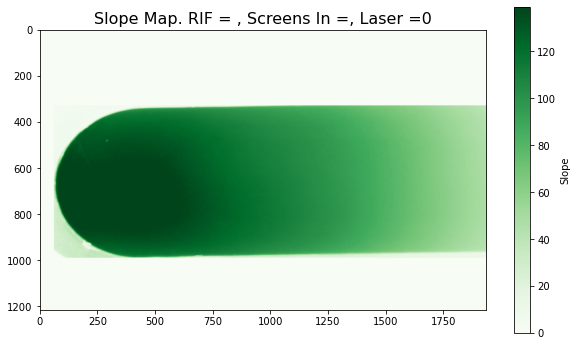

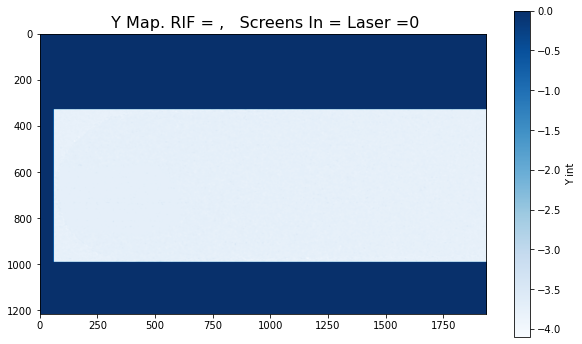

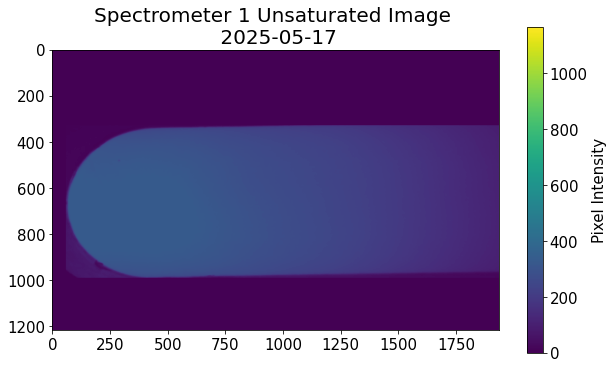

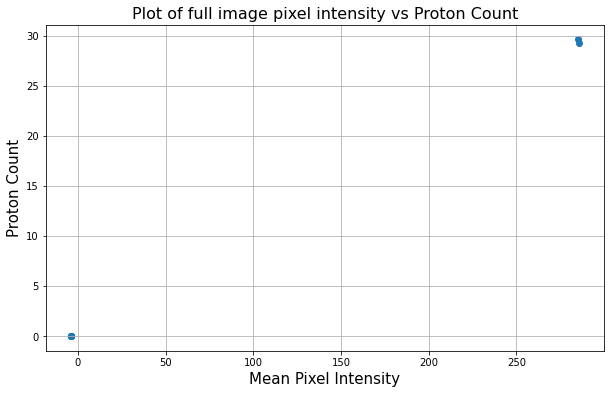

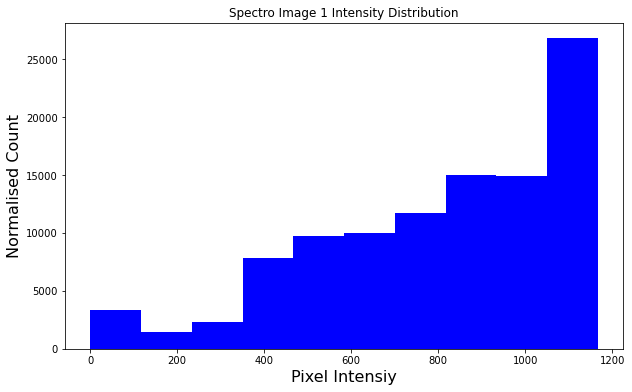

In [29]:
fig, ax = plt.subplots(figsize=(10, 6))
fig2, ax2 = plt.subplots(figsize=(10, 6))
fig3, ax3 = plt.subplots(figsize=(10, 6))
fig4, ax4 = plt.subplots(figsize=(10, 6))
fig5, ax5 = plt.subplots(figsize=(10, 6))

data = spectro_1_17_05[1132482.608][0]['OTR+CTR+BTV53+BTV426+BTV442+LDBP']
index_count = list(data)

list_slopes = []
list_int = []
slope_heat_map = np.zeros((1216, 1936))
intercept_heat_map = np.zeros((1216, 1936))

spectro_map = np.zeros((1216, 1936))
list_intensities2 = []

for i in index_count:

    x = np.array(data[i]['fit_parameters'])
    #print(len(x))
    y = np.array(data[i]['proton_count'])      

    mean_x = np.mean(x)
    mean_y = np.mean(y)

    std_x = np.std(x)
    std_y = np.std(y)

    mask = (np.abs(x - mean_x) <= 2 * std_x) & (np.abs(y - mean_y) <= 2 * std_y)

    # Filter out outliers > 2 std deviations
    filtered_x = x[mask]
    filtered_y = y[mask]

    if len(filtered_x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
        params = curve_fit(fit_line, y, x,p0=[1,0])[0]
        a, b = params
        list_slopes.append(a)
        list_int.append(b)
        list_intensities2.append(mean_x)

        slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
        intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b
        
        spectro_map[i[0]:i[1],i[2]:i[3]] = mean_x 


im = ax.imshow(slope_heat_map,cmap='Greens',origin='upper')
ax.imshow(slope_heat_map,cmap='Greens')
fig.colorbar(im, ax=ax, label ='Slope')

im2 = ax2.imshow(intercept_heat_map,cmap='Blues',origin='upper')
ax2.imshow(intercept_heat_map,cmap='Blues')
fig2.colorbar(im2, ax=ax2, label ='Y int')

im3 = ax3.imshow(spectro_map)
ax3.imshow(spectro_map,vmax=4095)
cbar = fig.colorbar(im3, ax=ax3)
cbar.ax.tick_params(labelsize=15)
cbar.set_label('Pixel Intensity',fontsize=15)

ax4.scatter(x,y)
ax4.set_xlabel('Mean Pixel Intensity', fontsize=15)
ax4.set_ylabel('Proton Count', fontsize=15)
ax4.grid()

bin_width = 0.5

# Histogram for pixel intensities
min_intensity = np.floor(min(list_intensities2))
max_intensity = np.ceil(max(list_intensities2))
bins = np.arange(min_intensity, max_intensity + bin_width, bin_width)

ax5.hist(list_intensities2,color='Blue')
ax5.set_title('Spectro Image 1 Intensity Distribution')
ax5.set_xlabel('Pixel Intensiy', fontsize=16)
ax5.set_ylabel('Normalised Count', fontsize=16)

ax.set_title(f'Slope Map. RIF = , Screens In =, Laser =0', fontsize=16)
ax2.set_title(f' Y Map. RIF = ,   Screens In = Laser =0', fontsize=16)

ax3.set_title(f'Spectrometer 1 Unsaturated Image \n 2025-05-17', fontsize=20)
ax3.tick_params(axis='both', which='major', labelsize=15)
ax4.set_title(f'Plot of full image pixel intensity vs Proton Count', fontsize=16)

plt.show()

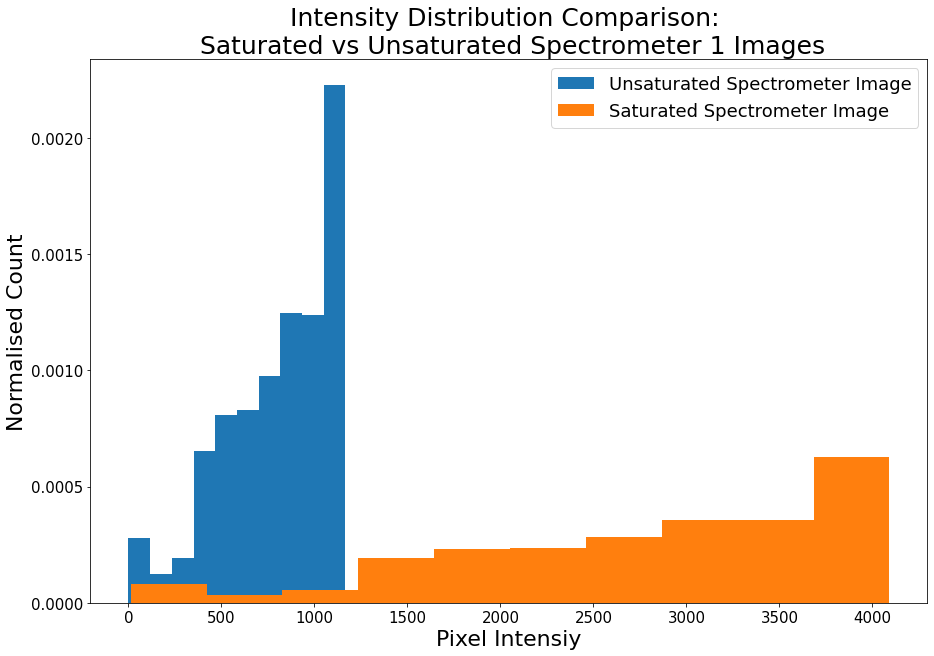

In [23]:
plt.figure(figsize=(15,10))

plt.hist(list_intensities2,density=True,label='Unsaturated Spectrometer Image')

plt.hist(list_intensities,density=True,label='Saturated Spectrometer Image')
plt.title('Intensity Distribution Comparison: \n Saturated vs Unsaturated Spectrometer 1 Images', fontsize=25)
plt.xlabel('Pixel Intensiy', fontsize=22)
plt.ylabel('Normalised Count', fontsize=22)
plt.tick_params(axis='both', which='major', labelsize=15)

plt.legend(fontsize=18)